# Natural Language Processing Project
## NLP Course @ Politecnico di Milano 2022/2023 - Prof. Mark Carman
### Topic 4: Autextification

### Group: Residual Sum of Students
- Raul Singh
- Davide Rigamonti
- Francesco Tosini
- Enrico Zuccolotto

## Introduction

The dataset consists of *short text passages* that have either been written by a *human* or have been generated automatically by a *language model*, more information can be found on the [official site](https://sites.google.com/view/autextification).

The original task will take place as part of [IberLEF 2023](http://sepln2023.sepln.org/en/iberlef-en/), the 5th Workshop on Iberian Languages Evaluation Forum at the SEPLN 2023 Conference, which will be held in Jaén, Spain on the 26th of September, 2023.

Given the scope of the original challenge we can observe that the dataset contains two separate set of samples, one in **English** and the other in **Spanish**; our main focus will be on the **English** dataset.

We will treat the two tasks **separately** as the two respective goals are different; although some similarities can be traced between the two, most of the considered approaches will be symmetrical and net homogeneous results.

Each task will be presented with a brief **data exploration** section, then we will proceed to utilize models and approaches that we have seen in the course (with the introduction of some novelties) starting from the most basic techniques based on the **Bag of Words representation** to then transition towards approaches that utilize **Word Embeddings** to then reach the *state-of-the-art* **Transformer** models.

## Preliminary initialization

This section contains all the library imports, helper function initialization calls and global variable definitions.

### Imports

#### Utilized libraries
The following dependencies are needed to run the notebook:
```
pip install scikit-learn~=1.2.2
pip install torch~=2.0.0
pip install matplotlib~=3.7.1
pip install plotly~=5.14.1
pip install nltk~=3.8.1
pip install spacy~=3.5.1
pip install textstat~=0.7.3
pip install pandas~=1.5.3
pip install python-terrier~=0.9.2
pip install scipy~=1.9.3
pip install gensim~=4.3.1
pip install lexicalrichness~=0.5.0
pip install sentence-transformers~=2.2.2
pip install transformers~=4.28.1
pip install datasets~=2.12.0
pip install evaluate~=0.4.0
```

#### Python standard library

In [1]:
import re
import os
import sys
import abc
import random
import string
import csv

import copy as cp
import array as arr

from collections import Counter

#### Scikit-learn

In [2]:
from sklearn import metrics

from sklearn.preprocessing import LabelBinarizer, LabelEncoder, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, accuracy_score, classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.manifold import TSNE
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.cluster import KMeans

#### Pytorch

In [3]:
import torch

import torch.nn as nn
import torch.optim as opt
import torch.utils.data as dt

#### TensorFlow

In [4]:
import tensorflow as tf

tfk = tf.keras
tfkl = tf.keras.layers

2023-05-28 19:22:35.579665: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-28 19:22:36.247088: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-05-28 19:22:36.247158: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory
2023-05-28 19:22:36.247165: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nv

#### Plotting

In [5]:
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.figure_factory as ff
import plotly.graph_objects as go

from plotly.subplots import make_subplots

#### Various

In [7]:
import nltk
import spacy
import textstat

import evaluate as hf_ev
import numpy as np
import pandas as pd
import pyterrier as pt
import scipy.sparse as sps

import gensim.downloader as api

from spacy import displacy
from nltk.corpus import stopwords
from pandas.core.common import flatten
from datasets import Dataset, DatasetDict
from gensim.models.word2vec import Word2Vec
from lexicalrichness import LexicalRichness
from sentence_transformers import SentenceTransformer, util
from transformers import TrainingArguments, Trainer, AutoTokenizer, AutoModelForSequenceClassification


### Helper functions

#### Pytorch models

In [8]:
history_metrics = {
    "epoch": {},
    "loss": {"order": -1},
    "val_loss": {"order": -1},
    "acc": {"order": +1},
    "val_acc": {"order": +1},
}

In [9]:
class StopNNLoop(BaseException):
    pass

def build_history_string(history_point):
    epoch = history_point["epoch"]
    metrics_string = " ".join(
        [f"{k}: {history_point[k]:.7f}" for k in history_point if not k == "epoch"]
    )
    return f"Epoch {epoch} -- " + metrics_string


def compare_equal_models(model_1, model_2):
    models_differ = 0
    for key_item_1, key_item_2 in zip(
        model_1.state_dict().items(), model_2.state_dict().items()
    ):
        if torch.equal(key_item_1[1], key_item_2[1]):
            pass
        else:
            models_differ += 1
            if key_item_1[0] == key_item_2[0]:
                print("Mismtach found at", key_item_1[0])
            else:
                raise Exception
    if models_differ == 0:
        return True
    return False


# Returns true if a is "better" than b following the metric
def compare_metric(metric, a, b, delta=0):
    if a == b:
        return False
    if history_metrics[metric]["order"] == +1:
        return a > b + delta
    return a < b - delta


# Initializes lowest possible value given a metric
def init_lowest(metric):
    return -np.inf if history_metrics[metric]["order"] == +1 else np.inf


def init_gpu(gpu="cuda:0"):
    return torch.device(gpu if torch.cuda.is_available() else "cpu")

In [10]:
class Data(dt.Dataset):
    def __init__(self, x, y, x_type=np.int32, y_type=torch.float):
        x_coo = x.tocoo()
        self.x = torch.sparse.FloatTensor(
            torch.LongTensor([x_coo.row, x_coo.col]),
            torch.FloatTensor(x_coo.data.astype(x_type)),
            x_coo.shape,
        )
        self.y = torch.tensor(y, dtype=y_type)
        self.shape = self.x.shape

    def __getitem__(self, index):
        return self.x[index].to_dense(), self.y[index]

    def __len__(self):
        return self.shape[0]

In [11]:
class Classifier(nn.Module):
    def __init__(self, binary_classifier=False, device=torch.device("cpu"), verbose=True):
        super().__init__()
        self.device = device
        self.is_binary = binary_classifier
        self.verbose = verbose
        self.is_compiled = False
        self.history = []

    def forward(self, x):
        return x

    def compile(self, loss, optimizer, binary_threshold=0.5):
        self.loss = loss
        self.optimizer = optimizer
        self.binary_threshold = binary_threshold
        self.to(self.device)
        self.is_compiled = True

    def parse_logits(self, outputs):
        if self.is_binary:
            predicted = (outputs > self.binary_threshold).float()
        else:
            _, predicted = torch.max(outputs.data, 1)
        return predicted

    def train_loop(self, data, epochs, data_val=None, callbacks=[]):
        try:
            tot = len(data.dataset)
            # Iterate over all epochs
            for epoch in range(epochs):
                running_loss = 0.0
                correct = 0
                history_point = {}
                # Iterate over each dataset batch
                for i, datum in enumerate(data):
                    # Decompose batch in x and y
                    inputs, labels = datum
                    # Set gradients to zero
                    self.optimizer.zero_grad()
                    # Forward pass
                    outputs = self(inputs)
                    predictions = self.parse_logits(outputs)
                    current_loss = self.loss(outputs, labels)
                    # Backpropagation
                    current_loss.backward()
                    # Optimization
                    self.optimizer.step()
                    # Update metrics
                    running_loss += current_loss.item()
                    correct += (predictions == labels).float().sum()

                # Compute training metrics
                history_point["epoch"] = epoch + 1
                history_point["loss"] = running_loss / tot
                history_point["acc"] = correct / tot

                # Compute and save eventual validation metrics
                if data_val:
                    _, val_metrics = self.test_loop(data_val)
                    history_point["val_loss"] = val_metrics["loss"]
                    history_point["val_acc"] = val_metrics["acc"]

                # Save epoch in history
                self.history.append(history_point)

                # Perform callbacks
                for callback in callbacks:
                    callback.call(self, history_point)

                # Print epoch summary
                if self.verbose:
                    print(build_history_string(history_point))

        except StopNNLoop as s:  # noqa
            pass

    def test_loop(self, data):
        all_predictions = np.array([])
        tot = len(data.dataset)
        loss = 0.0
        correct = 0
        metrics = {}
        # Prevent model update
        with torch.no_grad():
            # Iterate over each dataset batch
            for datum in data:
                # Decompose batch in x and y
                inputs, labels = datum
                # Forward pass
                outputs = self(inputs)
                predictions = self.parse_logits(outputs)
                current_loss = self.loss(outputs, labels)
                # Update metrics
                loss += current_loss.item()
                correct += (predictions == labels).float().sum()
                # Append predictions
                all_predictions = np.append(all_predictions, predictions)

        # Compute metrics
        metrics["acc"] = correct / tot
        metrics["loss"] = loss / tot

        return all_predictions.flatten(), metrics

In [12]:
class Callback(metaclass=abc.ABCMeta):
    def __init__(self, inputs):
        if not isinstance(inputs, list):
            raise TypeError("Parameter 'inputs' must be a list")
        if not all(x in history_metrics for x in inputs):
            raise ValueError(
                "Unknown input value, not present in Callback.callback_inputs"
            )
        self.inputs = inputs

    def inputs_check(self, inputs):
        if not all(x in inputs for x in self.inputs):
            raise ValueError(
                f"Requested inputs not provided: {[i for i in inputs if i not in self.inputs]}"
            )

    @abc.abstractmethod
    def call(self, model, inputs):
        self.inputs_check(inputs)
        pass

class EarlyStopping(Callback):
    def __init__(
        self,
        metric="loss",
        patience=10,
        baseline=None,
        delta=0,
        restore_best=True,
        verbose=True,
    ):
        super().__init__([metric])
        self.metric = metric
        self.patience = patience
        self.baseline = baseline
        self.delta = delta
        self.restore_best = restore_best
        self.verbose = verbose
        self.best_epoch = 0
        self.counter = 0
        self.saved_params = {}
        self.last_best = init_lowest(self.metric)

    def call(self, model, inputs):
        super().call(model, inputs)
        if self.early_stop(model, inputs):
            raise StopNNLoop()

    def early_stop(self, model, inputs):
        metric = inputs[self.metric]
        # Check if new metric is better than the current best
        if compare_metric(self.metric, metric, self.last_best):
            # Reset counter and update best value
            self.last_best = metric
            self.counter = 0
            self.best_epoch = inputs["epoch"]
            # Update model checkpoint
            if compare_metric(self.metric, metric, self.baseline):
                self.saved_params = cp.deepcopy(model.state_dict())
        # Check if new metric is worse than the current best
        elif compare_metric(self.metric, self.last_best, metric, self.delta):
            # Increment counter
            self.counter += 1
            # Check if counter exceeds patience, if so interrupt training
            if self.counter >= self.patience:
                # Restore best model checkpoint if possible and wanted
                if not self.restore_best:
                    return True
                if self.saved_params:
                    model.load_state_dict(self.saved_params)
                if self.verbose:
                    if self.saved_params:
                        print(f"Model restored successfully @ epoch {self.best_epoch}")
                    else:
                        print(f"Couldn't restore model @ epoch {self.best_epoch}")
                return True
        return False


class AdaptLR(Callback):
    def __init__(self, metric="loss", patience=5, factor=0.1, delta=0, verbose=True):
        super().__init__([metric])
        self.metric = metric
        self.patience = patience
        self.factor = factor
        self.delta = delta
        self.verbose = verbose
        self.counter = 0
        self.last_best = init_lowest(self.metric)

    def call(self, model, inputs):
        super().call(model, inputs)
        if self.adaptlr(inputs):
            # Adapt learning rate
            out = []
            for g in model.optimizer.param_groups:
                g["lr"] *= self.factor
                out = g["lr"]
            if self.verbose:
                print(f"Reducing lr to {out:.4f}")

    def adaptlr(self, inputs):
        metric = inputs[self.metric]
        # Check if new metric is better than the current best
        if compare_metric(self.metric, metric, self.last_best):
            # Reset counter and update best value
            self.last_best = metric
            self.counter = 0
        # Check if new metric is worse than the current best
        elif compare_metric(self.metric, self.last_best, metric, self.delta):
            # Increment counter
            self.counter += 1
            # Check if counter exceeds patience, if so interrupt training
            if self.counter >= self.patience:
                self.counter = 0
                return True
        return False

#### Generic utility

In [13]:
def split(x, y, test_size=0.2, val_size=0.0, seed=0):
    if val_size + test_size >= 1:
        return None
    x_train, x_test, y_train, y_test = train_test_split(
        x, y, test_size=test_size + val_size, stratify=y, random_state=seed
    )
    x_val, y_val = None, None
    if val_size > 0:
        x_test, x_val, y_test, y_val = train_test_split(
            x_test,
            y_test,
            test_size=val_size / (test_size + val_size),
            stratify=y_test,
            random_state=seed,
        )
    return x_train, x_val, x_test, y_train, y_val, y_test

def compact_split(dataset, test_size=0.2, val_size=0.0, seed=0):
    if val_size + test_size >= 1:
        return None
    train, test = train_test_split(
        dataset, test_size=test_size + val_size, random_state=seed
    )
    val = None
    if val_size > 0:
        val, test = train_test_split(
            test,
            test_size=test_size / (test_size + val_size),
            random_state=seed,
        )
    return train, val, test

def evaluate(y_true, y_pred, labels=None):
    print(classification_report(y_true, y_pred))
    cm = confusion_matrix(y_true, y_pred)
    cm_display = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    cm_display.plot()
    plt.show()

In [14]:
# Load the dataset as a numpy array and perfom some preprocessing on data.
def get_np_dataset(path):
    
    # Load the dataset
    dataset = []
    with open(path, encoding="utf-8") as file:
        tsv_file = csv.reader(file, delimiter="\t")
        for line in tsv_file:
          dataset.append(line)
        
    # Dataset preprocessing    
    _dataset = np.array(dataset)
    X = _dataset[1:,1]
    Y = _dataset[1:,2]

    # X preprocessing: removes punctuation
    regex = '[' + string.punctuation + ']'
    X_np = [(re.sub(regex,'',doc)).split() for doc in X]

    # Y preprocessing: convert Y to integers
    labels = sorted(set(Y))
    _Y = [labels.index(y) for y in Y]

    return X_np, _Y

In [15]:
def train_cv_models(models, x_train, y_train):
    for model in models:
        x_train_, y_train_ = x_train, y_train
        if "subsample" in model.keys():
            x_train_, _, y_train_, _ = train_test_split(
                x_train, 
                y_train, 
                test_size=model["subsample"], 
                stratify=y_train
            )
                
        print(f">> Training {model['name']}")
        print("   ", end="")      
        model["model"].fit(x_train_, y_train_)
        
        print("   Found best model... ", end="")
        model["best"] = model["model"].best_estimator_
        model["best"].fit(x_train, y_train)
        print("Trained best model.")

def test_cv_models(models, x_test, y_test):
    for model in models:
        print(f"{model['name']}")
        if hasattr(model["model"], "cv_results_"):
            print(f"Best parameters: {model['model'].best_params_}")
            print(f"Best CV score: {model['model'].best_score_}")
        y_pred = model['best'].predict(x_test)
        evaluate(y_test, y_pred, labels=labels)

#### Transformer-specific helper functions

In [16]:
def import_transformer(model_name, labels, device):
    transformer = AutoModelForSequenceClassification.from_pretrained(
        model_name, 
        num_labels=len(labels)
    )
    
    tokenizer = AutoTokenizer.from_pretrained(model_name)
    transformer = transformer.to(device)
    
    return transformer, tokenizer


def report(trainer, test_set, labels, model_name=None):
    preds = trainer.predict(test_set)
    y_pred = torch.argmax(torch.tensor(preds.predictions), dim=1).numpy()
    
    if model_name is not None:
        print(model_name)
    
    evaluate(test_set['label'], y_pred, labels)


@torch.no_grad()
def predict(transformer, text, labels):
    input_encodings = tokenizer(text, return_tensors='pt').to(device)
    outputs = transformer(**input_encodings)
    
    lbl = labels[torch.argmax(outputs.logits).item()]

    return lbl


def compute_metrics(eval_pred):
    logits, labels = eval_pred
    predictions = np.argmax(logits, axis=-1)
    return metric.compute(predictions=predictions, references=labels)


def tokenize_function(examples):
    return tokenizer(examples["text"], 
                     padding='max_length', 
                     truncation=True, 
                     max_length=max_length)
    
def clean_gpu_memory(transformer, tokenizer):
    del transformer
    del tokenizer
    torch.cuda.empty_cache()

### Variable definitions

In [17]:
seed = 42
np.random.seed(seed)
random.seed(seed)

#### Library initialization calls

In [17]:
%%capture
# Load spacy pipeline model
!{sys.executable} -m spacy download en_core_web_sm
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/crimsowl/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Task 1

The challenge is subdivided in two main tasks, the first is a **Binary Classification** task that aims at identifying if a text passage was *written by a human* or if it was *generated from a langauge model*.

In [18]:
dataset_path = "../../AUTEXTIFICATION/subtask1-en/train.tsv"
labels = ["generated", "human"]

### Data Exploration

In [19]:
df = pd.read_csv(dataset_path, sep="\t", header=0)
pd.set_option('display.max_colwidth', 150)

df.head(5)

,id,text,label
0,12322,you need to stop the engine and wait until it stops. This is how I would do it: // Check if its safe,generated
1,1682,"The Commission shall publish the report; an interim report at least once every two years, and whenever it considers that such a report is necessar...",generated
2,22592,"I have not been tweeting a lot lately, but I did in November, and it was a really good month. I also",generated
3,17390,I pass my exam and really thankgod for that but idk where will I go for shsmy result is ah,human
4,30453,"The template will have 3 parts: a mustache shape, a bow tie shape, and a skinny rectangle. The mustache shape will eventually make the bow loops. ...",human


Let's check the dataset size.

In [21]:
print(f"No. of sentences: {len(df)}")

No. of sentences: 33845


Let's print some sentences and try to understand the dataset.

In [22]:
for i in range(20):
    print(df['text'][i])
    print("\n")

you need to stop the engine and wait until it stops. This is how I would do it: // Check if its safe


The Commission shall publish the report; an interim report at least once every two years, and whenever it considers that such a report is necessary or appropriate. 2. The Commission may request any relevant information from the Member States, the Council, the European Parliament, international organizations, bodies or specialized agencies. 3. The Commission shall ensure adequate access by the competent national authorities for the purpose of implementing this Regulation. 4. The Commission shall give special attention to the social dimension of the programme. 5. The


I have not been tweeting a lot lately, but I did in November, and it was a really good month. I also


I pass my exam and really thankgod for that but idk where will I go for shsmy result is ah


The template will have 3 parts: a mustache shape, a bow tie shape, and a skinny rectangle. The mustache shape will eventually m

We tried to understand what this data is about by printing randomly some sentences and querying the database.
The data seems to be related to news and reviews about a variety of topics.In particular we have observed some legal articles, some tweets and some wiki-like entries.It's a various db.

we have 2 different categories:


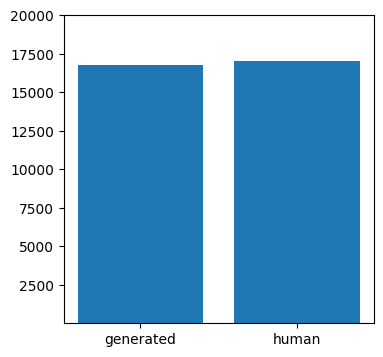

In [23]:
label_count = Counter(df['label'])

print(f"we have {len(label_count.keys())} different categories:")


plt.figure(figsize=(4, 4))
plt.bar(range(len(label_count)), label_count.values())
plt.xticks(range(len(label_count)), label_count.keys())
plt.ylim([1, 20000])
plt.show()

The categories are equally distributed.

#### Indexing

In this section we index the database to make searches possible.

Before running queries with a search engine, we must first index the documents.

In the following cell, we index all of the dataframe's documents. 

In [24]:
# Start pyterrier
if not pt.started():
    pt.init(logging="ERROR")
    

df["docno"]=[str(i) for i in df["id"]]
pd_indexer = pt.DFIndexer("./subtask1",overwrite=True,verbose=True)
indexref = pd_indexer.index(df["text"], df["docno"])

PyTerrier 0.9.2 has loaded Terrier 5.7 (built by craigm on 2022-11-10 18:30) and terrier-helper 0.0.7

No etc/terrier.properties, using terrier.default.properties for bootstrap configuration.
  0%|          | 0/33845 [00:00<?, ?documents/s]/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/pyterrier/index.py:628: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column, value in meta_column[1].iteritems():
100%|██████████| 33845/33845 [00:16<00:00, 2058.59documents/s]


In [25]:
index = pt.IndexFactory.of(indexref)

Let's visualize some statistics about our generated index.

In [26]:
print(index.getCollectionStatistics().toString())

Number of documents: 33845
Number of terms: 31825
Number of postings: 751277
Number of fields: 0
Number of tokens: 923471
Field names: []
Positions:   false



Now we will try asking some queries.

In [27]:
query = "universities"

bm25 = pt.BatchRetrieve(index, wmodel="BM25")
queries_bm=bm25.search(query)
br = pt.BatchRetrieve(index, wmodel="TF_IDF")
queries_br=br.search(query)
print("Ranking using bm25 \n Top 5 \n")
print(queries_bm.head())
for i in range(5):
  print(df[df.docno==queries_bm.docno[i]]["text"])

print("Ranking using br \n Top 5 \n")
print(queries_br.head())
for i in range(5):
  print(df[df.docno==queries_br.docno[i]]["text"])

Ranking using bm25 
 Top 5 

  qid  docid  docno  rank      score         query
0   1  33198   1531     0  13.264462  universities
1   1   3129   1736     1  12.516592  universities
2   1  10129   9574     2  12.238397  universities
3   1  24383  21323     3  12.221310  universities
4   1  24720  29820     4  11.970253  universities
33198    7. The University of Tokyo, Sakuragaokashi, Kanagawa 2458502, Japan. 8. National Institute for Materials Science and Technology, Itabashishi, Ibar...
Name: text, dtype: object
3129    the university diploma in civil engineering awarded by the Faculty of Engineering of the Technical University of Lisbon (Licenciatura em Engenhari...
Name: text, dtype: object
10129    (a) The Tempus framework for the 1993/94 academic year shall be based upon the following principles: (i) The teaching and learning of languages sh...
Name: text, dtype: object
24383    A full Universal Hall for the Organ is available in the Main Auditorium. The Main Auditorium is one of

#### Clustering

In this subsection we apply a simple bag of words model and cluster our data.

In [28]:
vectorizer = TfidfVectorizer(max_df=0.8, min_df=5, stop_words='english')

In [29]:
documents = np.array(df['text'])
labels_clus = np.array(df['label'])

We have obtained a relatively small vocabulary composed by ~11k words.

In [30]:
vectorizer.fit(documents)
vocab = vectorizer.get_feature_names_out()
print(f"Length of vocabulary: {len(vocab)}")

Length of vocabulary: 11557


In [31]:
vector_documents = vectorizer.transform(documents)

By analyzing the cluster similarity, we can see if our data tends to aggregate in specific classes.

In [32]:
for i in range(1, 200):
    if (labels_clus[i] == labels_clus[0]):
      print('Similarity:', vector_documents[0].multiply(vector_documents[i]).sum())

Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.021988643765721246
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.023254981000023926
Similarity: 0.0
Similarity: 0.0
Similarity: 0.05465414018686425
Similarity: 0.0
Similarity: 0.0
Similarity: 0.04271130589763102
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Simila

We will use KMeans, a basic clustering algorithm.

In [33]:
k = len(set(labels_clus))
kmeans = KMeans(n_clusters=k, max_iter=100, n_init=2, verbose=True, random_state=2307)
kmeans.fit(vector_documents)

Initialization complete
Iteration 0, inertia 67084.4746223415.
Iteration 1, inertia 33392.0984793209.
Iteration 2, inertia 33308.75747079342.
Iteration 3, inertia 33186.991256749025.
Iteration 4, inertia 32846.08480709018.
Iteration 5, inertia 32738.428579477113.
Iteration 6, inertia 32701.09072904294.
Iteration 7, inertia 32684.420324122155.
Iteration 8, inertia 32676.322009547814.
Iteration 9, inertia 32672.25915736398.
Iteration 10, inertia 32670.24450349325.
Iteration 11, inertia 32669.2859439475.
Iteration 12, inertia 32668.70796900578.
Iteration 13, inertia 32668.34169553777.
Iteration 14, inertia 32668.161644015916.
Iteration 15, inertia 32668.118911826816.
Iteration 16, inertia 32668.11122109947.
Iteration 17, inertia 32668.09879881633.
Iteration 18, inertia 32668.078362305703.
Iteration 19, inertia 32668.063546554396.
Iteration 20, inertia 32668.0545401196.
Iteration 21, inertia 32668.043044294172.
Iteration 22, inertia 32668.03672509524.
Iteration 23, inertia 32668.0352767220

KMeans(max_iter=100, n_clusters=2, n_init=2, random_state=2307, verbose=True)

In [35]:
print("Intrinsic evaluation measures:")
print("Within-cluster sum-of-squares:", str(kmeans.inertia_))
print("Silhouette coefficient:", str(metrics.silhouette_score(vector_documents, kmeans.labels_)))

print('Extrinsic evaluation measures:')
print("Homogeneity:", str(metrics.homogeneity_score(labels_clus, kmeans.labels_)))
print("Completeness:", str(metrics.completeness_score(labels_clus, kmeans.labels_)))
print("V-measure:", str(metrics.v_measure_score(labels_clus, kmeans.labels_)))
print("Adjusted Rand-Index:", str(metrics.adjusted_rand_score(labels_clus, kmeans.labels_)))

Intrinsic evaluation measures:
Within-cluster sum-of-squares: 32668.032303848675
Silhouette coefficient: 0.011687671020057765
Extrinsic evaluation measures:
Homogeneity: 0.06476441677697967
Completeness: 0.12404977572786596
V-measure: 0.0850996555899704
Adjusted Rand-Index: 0.03102009598058132


As we expected, the results obtained are not good.

We can say quite confidently that the content of the sentences is not directly related to the label.

#### Feature Extraction

We load the english dataset and we run the *en_core_web_sm* SpaCy pipeline on it to generate a vectorized representation enriched with POS tags and NER tags.

The [SpaCy pipeline](https://github.com/explosion/spacy-models/releases/tag/en_core_web_sm-3.5.0) contains the following components: *tok2vec*, *tagger*, *parser*, *senter*, *attribute_ruler*, *lemmatizer*, *ner*.

In addition, we define subsets of grouped POS and NER tags that may be of interest to our application.

In [36]:
# Loading the dataset
df = pd.read_csv(dataset_path, sep="\t")
df = df.drop("id", axis=1)
nlp_model = spacy.load("en_core_web_sm")
df["tagged_text"] = df["text"].apply(lambda x: nlp_model(x))

df.head()

,text,label,tagged_text
0,you need to stop the engine and wait until it ...,generated,"(you, need, to, stop, the, engine, and, wait, ..."
1,The Commission shall publish the report; an in...,generated,"(The, Commission, shall, publish, the, report,..."
2,"I have not been tweeting a lot lately, but I d...",generated,"(I, have, not, been, tweeting, a, lot, lately,..."
3,I pass my exam and really thankgod for that bu...,human,"(I, pass, my, exam, and, really, thankgod, for..."
4,The template will have 3 parts: a mustache sha...,human,"(The, template, will, have, 3, parts, :, a, mu..."


In [38]:
# Interesting POS tags
sel_pos = {
    ",": [","], ".": [","], ":": [":"], "ADD": ["ADD"], "AFX": ["AFX"], "CC": ["CC"],
    "CD": ["CD"], "DT": ["DT"], "EX": ["EX"], "HYPH": ["HYPH"], "IN": ["IN"],
    "JJ": ["JJ", "JJR", "JJS"], "NFP": ["NFP"], "NN": ["NN", "NNP", "NNPS", "NNS"],
    "PRP": ["PRP", "PRP$"], "RB": ["RB", "RBR", "RBS", "RP"], "SYM": ["SYM"], "TO": ["TP"],
    "UH": ["UH"], "VB": ["VB", "VBD", "VBG", "VBN", "VBP", "VBZ"], "WDT": ["WDT"], "XX": ["XX"]
}

# Interesting NER tags
sel_ner = [
    "CARDINAL", "DATE", "EVENT", "FAC", "GPE", "LANGUAGE", "LAW", "LOC", "MONEY", "NORP",
    "ORDINAL", "ORG", "PERCENT", "PERSON", "PRODUCT", "QUANTITY", "TIME", "WORK_OF_ART"
]

# Lower limit for the number of samples to consider
limit_n_samples = 40

# Print tag explanation
print("POS tags")
for tag in sel_pos:
    print(f"{tag} {sel_pos[tag]}: {spacy.explain(tag)}")
print("NER tags")
for tag in sel_ner:
    print(f"{tag}: {spacy.explain(tag)}")

POS tags
, [',']: punctuation mark, comma
. [',']: punctuation mark, sentence closer
: [':']: punctuation mark, colon or ellipsis
ADD ['ADD']: email
AFX ['AFX']: affix
CC ['CC']: conjunction, coordinating
CD ['CD']: cardinal number
DT ['DT']: determiner
EX ['EX']: existential there
HYPH ['HYPH']: punctuation mark, hyphen
IN ['IN']: conjunction, subordinating or preposition
JJ ['JJ', 'JJR', 'JJS']: adjective (English), other noun-modifier (Chinese)
NFP ['NFP']: superfluous punctuation
NN ['NN', 'NNP', 'NNPS', 'NNS']: noun, singular or mass
PRP ['PRP', 'PRP$']: pronoun, personal
RB ['RB', 'RBR', 'RBS', 'RP']: adverb
SYM ['SYM']: symbol
TO ['TP']: infinitival "to"
UH ['UH']: interjection
VB ['VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ']: verb, base form
WDT ['WDT']: wh-determiner
XX ['XX']: unknown
NER tags
CARDINAL: Numerals that do not fall under another type
DATE: Absolute or relative dates or periods
EVENT: Named hurricanes, battles, wars, sports events, etc.
FAC: Buildings, airports, high

We enrich the dataset calculating some custom metrics for each sentence, such as:
- text length
- word lenght
- number of uppercase letters
- number of different and cumulative stopwords
- POS and NER tag counts
  
Most of these metrics have been calculated considering both an absolute and a relative (to the text length) approach.

Then, we delete metrics that don't meet a given support.

In [39]:
# Text length
df["length"] = df["text"].str.len()
# Word lenght
df["word_length"] = [len(i.split()) for i in df['text']]
# Number of uppercase letters
df["n_upcase"] = df["text"].str.count(r"[A-Z]")
df["n_upcase_rel"] = df["n_upcase"] / df["length"]

# Number of stopwords
df["n_stopword"] = df["text"].str.split().apply(
    lambda x: len(set(x) & set(stopwords.words("english")))
)
df["ncum_stopword"] = df["text"].str.split().apply(
    lambda x: len([w for w in x if w in stopwords.words("english")])
)
df["n_stopword_rel"] = df["n_stopword"] / df["word_length"]
df["ncum_stopword_rel"] = df["ncum_stopword"] / df["word_length"]

# Number of POS and NER tags
for tag in sel_pos:
    column_tag = "n_pos_" + tag
    df[column_tag] = df["tagged_text"].apply(
        lambda x: len([tok for tok in x if tok.tag_ in sel_pos[tag]])
    )
    df[column_tag + "_rel"] = df[column_tag] / df["word_length"]
for tag in sel_ner:
    column_tag = "n_ner_" + tag
    df[column_tag] = df["tagged_text"].apply(
        lambda x: len([tok for tok in x if tok.ent_type_ == tag])
    )
    df[column_tag + "_rel"] = df[column_tag] / df["word_length"]

We can see that the sentences have an average lenght of 300 characters,and their lenghts ranges from 3 to 670 characters.
While we have an average number of words per sentence of 54,ranging from 1 to 100.

In [40]:
print('Maximum number of characters: ' + str(df['length'].max()))
print('Minimum number of characters: ' + str(df['length'].min()))
print('Average number of characters: ' + str(df['length'].mean()))
print('Maximum number of words: ' + str(df['word_length'].max()))
print('Minimum number of words: ' + str(df['word_length'].min()))
print('Average number of words: ' + str(df['word_length'].mean()))

Maximum number of characters: 669
Minimum number of characters: 3
Average number of characters: 305.25058354262075
Maximum number of words: 98
Minimum number of words: 1
Average number of words: 53.65992022455311


In [41]:
print("Deleting empty columns")
print(df.columns[(df == 0).all(axis=0)].tolist())
df = df.loc[:, (df != 0).any(axis=0)]

print(f"Deleting columns with less than {limit_n_samples} samples")
print(df.columns[df.astype(bool).sum(axis=0) <= limit_n_samples].tolist())
df = df.loc[:, df.astype(bool).sum(axis=0) > limit_n_samples]

# Defragment dataset
all_columns = df.columns.tolist()
df = df.copy()

Deleting empty columns
['n_pos_TO', 'n_pos_TO_rel']
Deleting columns with less than 40 samples
['n_pos_AFX', 'n_pos_AFX_rel', 'n_pos_HYPH', 'n_pos_HYPH_rel']


We define a function to neatly plot comparisons between human and generated samples utilizing the metrics visualized as box plots and histograms.

We opt to ignore metrics that result too similar between the two classes comparing the 1/4, 1/2 and 3/4 quantiles.

In [42]:
def plot_df_stats(
    df,
    sel_columns,
    labels,
    colors,
    ignore_similar=True,
    height=1000,
    width=800
):
    ignored = []
    vis_columns = []
    for column in sel_columns:
        if ignore_similar:
            col_name = column[0]["name"]
            x = df[col_name]
            x1 = df.loc[df['label']==labels[0]][col_name]
            x2 = df.loc[df['label']==labels[1]][col_name]
            delta = (x.max() - x.min()) / 100
            if (np.abs(x1.quantile(0.25) - x2.quantile(0.25)) <= delta and
                np.abs(x1.quantile(0.5) - x2.quantile(0.5)) <= delta and 
                np.abs(x1.quantile(0.75) - x2.quantile(0.75)) <= delta):
                ignored.append(col_name)
                continue
        vis_columns.append(column)
        
    titles = [c["name"] for c_arr in vis_columns for c in c_arr]
    specs = [
        [{"secondary_y": True} if h["type"] == "hist" else {} for h in s] 
        if len(s) > 1 else [{"colspan":2}, None]
        for s in vis_columns
    ]
    
    fig = make_subplots(
        horizontal_spacing = 0.005,
        vertical_spacing = 0.01,
        rows=len(vis_columns),
        cols=2,
        subplot_titles=titles,
        specs=specs
    )
    fig.update_layout(
        height=height,
        width=width,
        showlegend=False,
        template="plotly_white"
    )

    for i, column in enumerate(vis_columns):
        if len(column) > 1:
            for j, subcolumn in enumerate(column):
                x1 = df.loc[df['label']==labels[0]][subcolumn["name"]]
                x2 = df.loc[df['label']==labels[1]][subcolumn["name"]]
                if subcolumn["type"] == "box":
                    add_boxplot(fig, [x1, x2], i+1, j+1, labels, colors)
                elif subcolumn["type"] == "hist":
                    add_hist(fig, [x1, x2], i+1, j+1, labels, colors)
                else:
                    raise Exception()
        else:
            column = column[0]
            x1 = df.loc[df['label']==labels[0]][column["name"]]
            x2 = df.loc[df['label']==labels[1]][column["name"]]
            add_boxplot(fig, [x1, x2], i+1, 1, labels, colors)

    fig.show()
    print(f"{[i for i in ignored]} too similar, ignored")
    
def add_boxplot(fig, x, row, col, labels, colors):
    for i, el in enumerate(x):
        fig.add_trace(go.Box(
            y=el,
            name=labels[i],
            marker_color=colors[i]
        ),row=row, col=col)
        
def add_hist(fig, x, row, col, labels, colors):
    offset = len(x)
    temp = ff.create_distplot(x, labels, curve_type = 'kde')
    normal_x = []
    normal_y = []
    for n in range(offset):
        normal_x.append(temp.data[offset + n]['x'])
        normal_y.append(temp.data[offset + n]['y'])
    for i, el in enumerate(x):
        fig.add_trace(go.Histogram(
            x=el,
            orientation="v",
            xbins=go.histogram.XBins(size=(max(el) - min(el)) / 15),
            name=labels[i],
            opacity=0.4,
            marker_color=colors[i]
        ), row=row, col=col)
        fig.add_trace(go.Scatter(
            x=normal_x[i],
            y=normal_y[i],
            mode = 'lines',
            name=labels[i],
            marker_color=colors[i]
        ), row=row, col=col, secondary_y=True)

We select the metrics that we want to visualize and how we want to visualize them.

For the sake of brevity we only choose to visualize some of the POS/NER tags here.

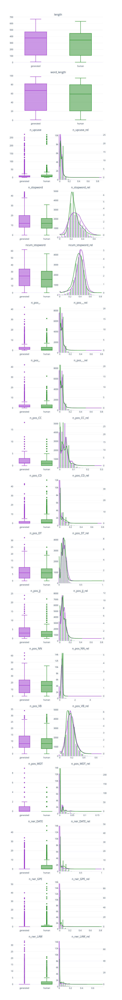

[] too similar, ignored


In [43]:
sel_columns = [
    [{"name": "length", "type": "box"}], 
    [{"name": "word_length", "type": "box"}], 
    [{"name": "n_upcase", "type": "box"}, {"name": "n_upcase_rel", "type": "hist"}], 
    [{"name": "n_stopword", "type": "box"}, {"name": "n_stopword_rel", "type": "hist"}],
    [{"name": "ncum_stopword", "type": "box"}, {"name": "ncum_stopword_rel", "type": "hist"}],
]

# sel_columns.extend([
#     [{"name": "n_pos_" + x, "type": "box"}, {"name": "n_pos_" + x + "_rel", "type": "hist"}]
#     for x in sel_pos if "n_pos_" + x in all_columns
# ])
sel_columns.extend([
    [{"name": "n_pos_,", "type": "box"}, {"name": "n_pos_,_rel", "type": "hist"}],
    [{"name": "n_pos_.", "type": "box"}, {"name": "n_pos_._rel", "type": "hist"}],
    [{"name": "n_pos_CC", "type": "box"}, {"name": "n_pos_CC_rel", "type": "hist"}],
    [{"name": "n_pos_CD", "type": "box"}, {"name": "n_pos_CD_rel", "type": "hist"}],
    [{"name": "n_pos_DT", "type": "box"}, {"name": "n_pos_DT_rel", "type": "hist"}],
    [{"name": "n_pos_JJ", "type": "box"}, {"name": "n_pos_JJ_rel", "type": "hist"}],
    [{"name": "n_pos_NN", "type": "box"}, {"name": "n_pos_NN_rel", "type": "hist"}],
    [{"name": "n_pos_VB", "type": "box"}, {"name": "n_pos_VB_rel", "type": "hist"}],
    [{"name": "n_pos_WDT", "type": "box"}, {"name": "n_pos_WDT_rel", "type": "hist"}],
])

# sel_columns.extend(
#     [{"name": "n_ner_" + x, "type": "box"}, {"name": "n_ner_" + x + "_rel", "type": "hist"}]
#     for x in sel_ner if "n_ner_" + x in all_columns
# )
sel_columns.extend([
    [{"name": "n_ner_DATE", "type": "box"}, {"name": "n_ner_DATE_rel", "type": "hist"}],
    [{"name": "n_ner_GPE", "type": "box"}, {"name": "n_ner_GPE_rel", "type": "hist"}],
    [{"name": "n_ner_LAW", "type": "box"}, {"name": "n_ner_LAW_rel", "type": "hist"}],
])

plot_df_stats(
    df,
    sel_columns,
    labels=labels,
    colors=["darkorchid", "forestgreen"],
    height=6000, width=1000
)

We repeat the process, this time adding interesting [Textstat](https://pypi.org/project/textstat/) and [LexicalRichness](https://lexicalrichness.readthedocs.io/) metrics.

It's possible to observe how most of the visualized metrics, are actually quite similar

In [44]:
# Textstat metrics https://pypi.org/project/textstat/
textstat_metrics = [
    'flesch_reading_ease', 'flesch_kincaid_grade', 'smog_index', 'coleman_liau_index',
    'automated_readability_index', 'dale_chall_readability_score', 'difficult_words',
    'linsear_write_formula', 'gunning_fog', 'fernandez_huerta', 'szigriszt_pazos', 
    'gutierrez_polini', 'crawford', 'gulpease_index', 'osman'
]
df['flesch_reading_ease'] = df["text"].apply(lambda x: textstat.flesch_reading_ease(x))
df['flesch_kincaid_grade'] = df["text"].apply(lambda x: textstat.flesch_kincaid_grade(x))
df['smog_index'] = df["text"].apply(lambda x: textstat.smog_index(x))
df['coleman_liau_index'] = df["text"].apply(lambda x: textstat.coleman_liau_index(x))
df['automated_readability_index'] = df["text"].apply(lambda x: textstat.automated_readability_index(x))
df['dale_chall_readability_score'] = df["text"].apply(lambda x: textstat.dale_chall_readability_score(x))
df['difficult_words'] = df["text"].apply(lambda x: textstat.difficult_words(x))
df['linsear_write_formula'] = df["text"].apply(lambda x: textstat.linsear_write_formula(x))
df['gunning_fog'] = df["text"].apply(lambda x: textstat.gunning_fog(x))
df['fernandez_huerta'] = df["text"].apply(lambda x: textstat.fernandez_huerta(x))
df['szigriszt_pazos'] = df["text"].apply(lambda x: textstat.szigriszt_pazos(x))
df['gutierrez_polini'] = df["text"].apply(lambda x: textstat.gutierrez_polini(x))
df['crawford'] = df["text"].apply(lambda x: textstat.crawford(x))
df['gulpease_index'] = df["text"].apply(lambda x: textstat.gulpease_index(x))
df['osman'] = df["text"].apply(lambda x: textstat.osman(x))

# Lexicalrichness metrics https://lexicalrichness.readthedocs.io/
lexrich_metrics = [
    'ttr', 'rttr', 'cttr'
]
df['ttr'] = df["text"].apply(lambda x: LexicalRichness(x).ttr)
df['rttr'] = df["text"].apply(lambda x: LexicalRichness(x).rttr)
df['cttr'] = df["text"].apply(lambda x: LexicalRichness(x).cttr)

print("Deleting empty columns")
print(df.columns[(df == 0).all(axis=0)].tolist())
df = df.loc[:, (df != 0).any(axis=0)]

print(f"Deleting columns with less than {limit_n_samples} samples")
print(df.columns[df.astype(bool).sum(axis=0) <= limit_n_samples].tolist())
df = df.loc[:, df.astype(bool).sum(axis=0) > limit_n_samples]

# Defragment dataset
all_columns = df.columns.tolist()
df = df.copy()

Deleting empty columns
[]
Deleting columns with less than 40 samples
[]


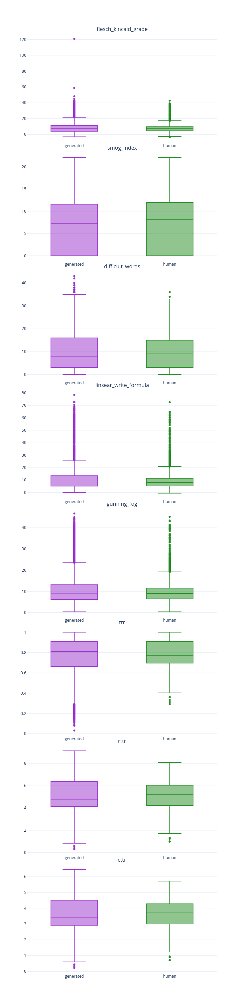

['flesch_reading_ease', 'coleman_liau_index', 'automated_readability_index', 'dale_chall_readability_score', 'fernandez_huerta', 'szigriszt_pazos', 'gutierrez_polini', 'crawford', 'gulpease_index', 'osman'] too similar, ignored


In [45]:
sel_columns = []

sel_columns.extend([
    [{"name": x, "type": "box"}] for x in textstat_metrics if x in all_columns
])
sel_columns.extend([
    [{"name": x, "type": "box"}] for x in lexrich_metrics if x in all_columns
])

plot_df_stats(
    df,
    sel_columns,
    labels=labels,
    colors=["darkorchid", "forestgreen"],
    height=3000, width=1000
)

### Bag of Words-based models and other approaches

#### Only Bag of Words text vectorization

We load the english dataset for the first task.

In [46]:
# Import main dataset
df = pd.read_csv(dataset_path, sep="\t")
df = df.drop("id", axis=1)

df

,text,label
0,you need to stop the engine and wait until it stops. This is how I would do it: // Check if its safe,generated
1,"The Commission shall publish the report; an interim report at least once every two years, and whenever it considers that such a report is necessar...",generated
2,"I have not been tweeting a lot lately, but I did in November, and it was a really good month. I also",generated
3,I pass my exam and really thankgod for that but idk where will I go for shsmy result is ah,human
4,"The template will have 3 parts: a mustache shape, a bow tie shape, and a skinny rectangle. The mustache shape will eventually make the bow loops. ...",human
...,...,...
33840,"@PierreJoye i have a server already, thanks for the offer the problem is time, as always :p (ill be done",human
33841,10. Article 13 of Council Directive 80/777/EEC of 15 July 1980 on the approximation of the laws of the Member States relating to the exploitation ...,human
33842,"Crying because I have to cry for you?. No. No, no, no. Itll be all right. I",generated
33843,"However, it will continue to offer customers a wide range of services and products related to the sale or lease of residential property. In additi...",generated


We define a preprocessing function that:
- converts all of the data to lowercase
- applies a regex to remove punctuation
- vectorizes all of the words using a given vectorizer

and we preprocess our data, splitting it into train and test sets utilizing the relevant helper function defined in [Preliminary initialization](#Preliminary-initialization).

For most of the simple BoW approaches, we have found that utlizing a **TfidfVectorizer** leads to no particular improvement w.r.t. a **CountVectorizer**; in addition, setting a minimum term frequency of 4 is a good compromise between number of parameters and performance.

Interestingly enough, keeping stopwords instead of removing them leads to slightly better results; this could be due to the fact that the difference in their usage is statistically relevant for the two classes.

In [48]:
def preprocess(data, lower=True, vectorizer=None, fit=True):
    # Convert all text to lowercase
    if lower:
        data = [x.lower() for x in data]

    # Remove punctuation and reset multiple spaces to one
    punct_regex = re.compile("[" + string.punctuation + "\’'" + "]")
    whitespace_regex = re.compile(" ( )+")
    data = [whitespace_regex.sub(" ", punct_regex.sub(" ", x)) for x in data]
    
    # Vectorize
    if vectorizer:
        if fit:
            data = vectorizer.fit_transform(data)
        else:
            data = vectorizer.transform(data)
    
    return data

In [49]:
vectorizer = TfidfVectorizer(min_df=4, max_df=0.6, ngram_range=(2,2))

x, y = df["text"], df["label"]
x_train, x_val, x_test, y_train, y_val, y_test = split(
    x, y, test_size=0.2, val_size=0.0, seed=seed
)

x_train = preprocess(x_train, vectorizer=vectorizer)
x_test = preprocess(x_test, vectorizer=vectorizer, fit=False)

We define some simple models to try out the simple Bag of Words approach, without any additional data; the models that we are going to use are:
- Multinomial Naive Bayes
- Logistic Regression
- C-Support SVM
- Decision Tree
- Random Forest
- Extra Tree classifier
- KNeighbors
- XGBoost

All of the previous models are run using 5-fold cross-validation on a small gridsearch around some of their default parameters.

To perform training and evaluation we have used the relevant helper functions defined in [Preliminary initialization](#Preliminary-initialization).

In [50]:
models = []

# Naive Bayes
nb = MultinomialNB()
nb_param = {"alpha":[0.001, 0.01, 0.1, 1, 10, 100]}
nb_clf = GridSearchCV(nb, nb_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Naive Bayes",
    "model": nb_clf,
})

# Logistic Regression
lr = LogisticRegression(max_iter=1000)
lr_param = [{
    "solver": ["liblinear"], 
    "penalty": ["l1", "l2"],
    "C":[0.01, 0.1, 1, 10]
},{
    "solver": ("lbfgs", "sag", "saga"), 
    "penalty": ["l2"],
    "C":[0.01, 0.1, 1]
}]
lr_clf = GridSearchCV(lr, lr_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Linear Regression",
    "model": lr_clf,
    "subsample": 0.7,
})

# SVC
svc = SVC()
svc_param = {"kernel": ["rbf"], "C": [0.1, 1, 10]}
svc_clf = GridSearchCV(svc, svc_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "SVC",
    "model": svc_clf,
    "subsample": 0.7,
})

# Decision Tree
dtree = DecisionTreeClassifier()
dtree_param = {
    "criterion": ["gini", "entropy"], 
    "max_features": [None, "sqrt", "log2"],
}
dtree_clf =  GridSearchCV(dtree, dtree_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Decision Tree",
    "model": dtree_clf,
})

# Random Forest
rf = RandomForestClassifier()
rf_param = {
    "criterion": ["gini", "entropy"],
}
rf_clf =  GridSearchCV(rf, rf_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Random Forest",
    "model": rf_clf,
    "subsample": 0.6,
})

# Extra Trees
et = ExtraTreesClassifier()
et_param = {
    "criterion": ["gini", "entropy"],
}
et_clf =  GridSearchCV(et, et_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Extra Trees",
    "model": et_clf,
    "subsample": 0.6,
})
# KNeighbors
kn = KNeighborsClassifier()
kn_param = {
    "n_neighbors": [1,3,5],
    "weights": ["uniform", "distance"]
}
kn_clf = GridSearchCV(kn, kn_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "KNeighbors",
    "model": kn_clf
})

# XGBoost
xgb = GradientBoostingClassifier(loss="exponential")
xgb_param = {
    "n_estimators": [50, 200],
    "criterion": ["friedman_mse", "squared_error"]
}
xgb_clf = GridSearchCV(xgb, xgb_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "XGBoost",
    "model": xgb_clf
})

>> Training Naive Bayes
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Decision Tree
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training KNeighbors
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training XGBoost
   Fitting 5 folds for each of 4 candidates, totalling 20 fits
   Fo

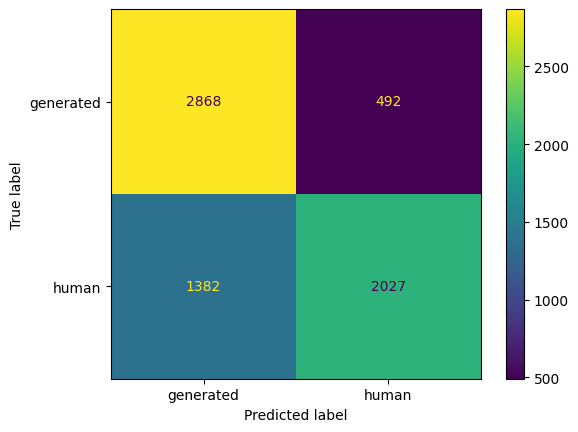

Linear Regression
Best parameters: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
Best CV score: 0.7361464948844259
              precision    recall  f1-score   support

   generated       0.76      0.77      0.77      3360
       human       0.77      0.76      0.77      3409

    accuracy                           0.77      6769
   macro avg       0.77      0.77      0.77      6769
weighted avg       0.77      0.77      0.77      6769



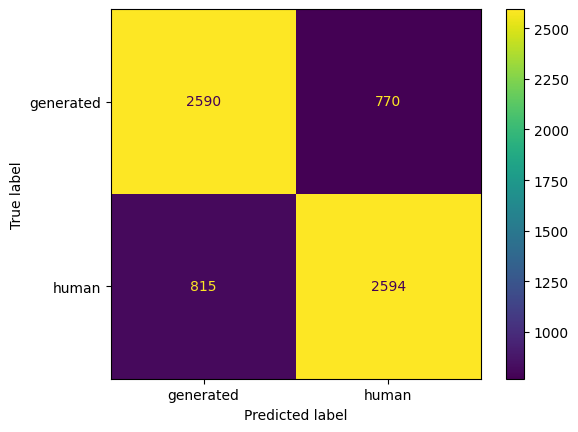

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.7382424403183023
              precision    recall  f1-score   support

   generated       0.77      0.78      0.78      3360
       human       0.78      0.77      0.78      3409

    accuracy                           0.78      6769
   macro avg       0.78      0.78      0.78      6769
weighted avg       0.78      0.78      0.78      6769



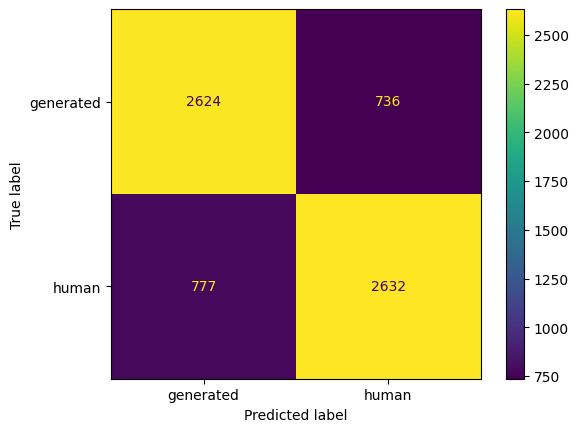

Decision Tree
Best parameters: {'criterion': 'entropy', 'max_features': None}
Best CV score: 0.7045352234274562
              precision    recall  f1-score   support

   generated       0.71      0.68      0.70      3360
       human       0.70      0.73      0.71      3409

    accuracy                           0.70      6769
   macro avg       0.70      0.70      0.70      6769
weighted avg       0.70      0.70      0.70      6769



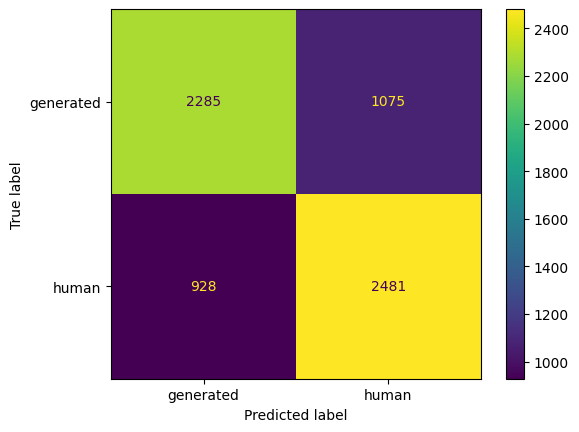

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.73730378578024
              precision    recall  f1-score   support

   generated       0.75      0.78      0.76      3360
       human       0.77      0.75      0.76      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



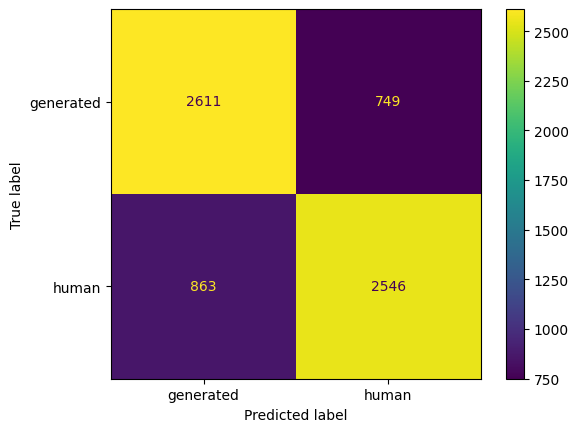

Extra Trees
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7397045244690674
              precision    recall  f1-score   support

   generated       0.75      0.79      0.77      3360
       human       0.78      0.74      0.76      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



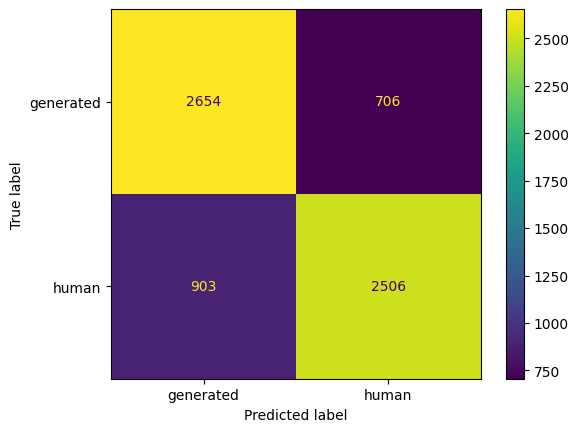

KNeighbors
Best parameters: {'n_neighbors': 1, 'weights': 'uniform'}
Best CV score: 0.5929235083354815
              precision    recall  f1-score   support

   generated       0.56      0.98      0.71      3360
       human       0.92      0.23      0.37      3409

    accuracy                           0.60      6769
   macro avg       0.74      0.60      0.54      6769
weighted avg       0.74      0.60      0.54      6769



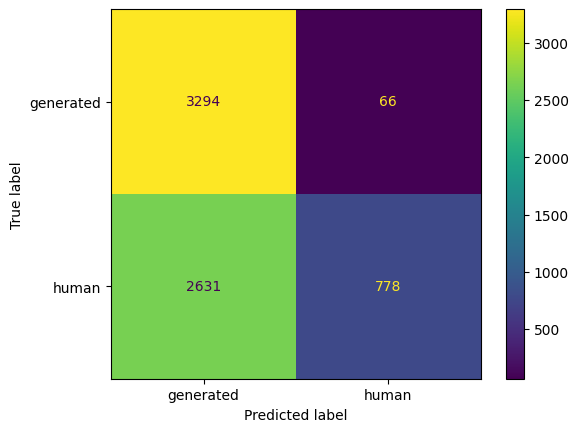

XGBoost
Best parameters: {'criterion': 'friedman_mse', 'n_estimators': 200}
Best CV score: 0.7334905570308419
              precision    recall  f1-score   support

   generated       0.75      0.68      0.71      3360
       human       0.71      0.78      0.74      3409

    accuracy                           0.73      6769
   macro avg       0.73      0.73      0.73      6769
weighted avg       0.73      0.73      0.73      6769



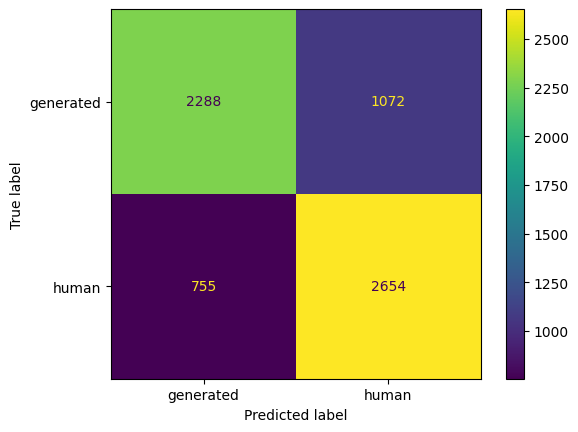

In [51]:
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

#### Including additional information

We run the *en_core_web_sm* SpaCy pipeline that was used in the [Data Exploration section](#Data-Exploration) on the dataset.

We also define a custom function to extract useful feature from the tokenized text and we apply it on the dataset.

In [52]:
def extract_features(tree):
    features = []
    for token in tree:
        lemma = token.lemma_
        pos_tag = token.pos_
        dep_lab = token.dep_
        head = token.head
        if token.i < head.i:
            direction = "l"
        else:
            direction = "r"
        dfr = len(list(token.ancestors))
        # if not token.is_stop:
        features.append({
            "lem": lemma ,
            "pos": pos_tag, 
            "dep": dep_lab, 
            "head": head, 
            "dir": direction, 
            "dfr": dfr
        })
    return features

In [53]:
# Run SpaCy NLP pipeline on dataset
parsed_df = df.copy()
parsed_df["text"] = df["text"].apply(lambda x: nlp_model(x))

# Extract useful features
parsed_df["features"] = parsed_df["text"].apply(lambda x: extract_features(x))

parsed_df

,text,label,features
0,"(you, need, to, stop, the, engine, and, wait, until, it, stops, ., This, is, how, I, would, do, it, :, //, Check, if, its, safe)",generated,"[{'lem': 'you', 'pos': 'PRON', 'dep': 'nsubj', 'head': need, 'dir': 'l', 'dfr': 1}, {'lem': 'need', 'pos': 'VERB', 'dep': 'ROOT', 'head': need, 'd..."
1,"(The, Commission, shall, publish, the, report, ;, an, interim, report, at, least, once, every, two, years, ,, and, whenever, it, considers, that, ...",generated,"[{'lem': 'the', 'pos': 'DET', 'dep': 'det', 'head': Commission, 'dir': 'l', 'dfr': 2}, {'lem': 'Commission', 'pos': 'PROPN', 'dep': 'nsubj', 'head..."
2,"(I, have, not, been, tweeting, a, lot, lately, ,, but, I, did, in, November, ,, and, it, was, a, really, good, month, ., I, also)",generated,"[{'lem': 'I', 'pos': 'PRON', 'dep': 'nsubj', 'head': tweeting, 'dir': 'l', 'dfr': 1}, {'lem': 'have', 'pos': 'AUX', 'dep': 'aux', 'head': tweeting..."
3,"(I, pass, my, exam, and, really, thankgod, for, that, but, idk, where, will, I, go, for, shsmy, result, is, ah)",human,"[{'lem': 'I', 'pos': 'PRON', 'dep': 'nsubj', 'head': pass, 'dir': 'l', 'dfr': 1}, {'lem': 'pass', 'pos': 'VERB', 'dep': 'ROOT', 'head': pass, 'dir..."
4,"(The, template, will, have, 3, parts, :, a, mustache, shape, ,, a, bow, tie, shape, ,, and, a, skinny, rectangle, ., The, mustache, shape, will, e...",human,"[{'lem': 'the', 'pos': 'DET', 'dep': 'det', 'head': template, 'dir': 'l', 'dfr': 2}, {'lem': 'template', 'pos': 'NOUN', 'dep': 'nsubj', 'head': ha..."
...,...,...,...
33840,"(@PierreJoye, i, have, a, server, already, ,, thanks, for, the, offer, the, problem, is, time, ,, as, always, :p, (, ill, be, done)",human,"[{'lem': '@PierreJoye', 'pos': 'PROPN', 'dep': 'intj', 'head': have, 'dir': 'l', 'dfr': 1}, {'lem': 'I', 'pos': 'PRON', 'dep': 'nsubj', 'head': ha..."
33841,"(10, ., Article, 13, of, Council, Directive, 80/777, /, EEC, of, 15, July, 1980, on, the, approximation, of, the, laws, of, the, Member, States, r...",human,"[{'lem': '10', 'pos': 'X', 'dep': 'ROOT', 'head': 10, 'dir': 'r', 'dfr': 0}, {'lem': '.', 'pos': 'PUNCT', 'dep': 'punct', 'head': 10, 'dir': 'r', ..."
33842,"(Crying, because, I, have, to, cry, for, you, ?, ., No, ., No, ,, no, ,, no, ., It, ll, be, all, right, ., I)",generated,"[{'lem': 'cry', 'pos': 'VERB', 'dep': 'ROOT', 'head': Crying, 'dir': 'r', 'dfr': 0}, {'lem': 'because', 'pos': 'SCONJ', 'dep': 'mark', 'head': hav..."
33843,"(However, ,, it, will, continue, to, offer, customers, a, wide, range, of, services, and, products, related, to, the, sale, or, lease, of, residen...",generated,"[{'lem': 'however', 'pos': 'ADV', 'dep': 'advmod', 'head': continue, 'dir': 'l', 'dfr': 1}, {'lem': ',', 'pos': 'PUNCT', 'dep': 'punct', 'head': c..."


Here is an example of a dependency parse tree extracted from a sentence.

In [55]:
displacy.render(parsed_df["text"][0], jupyter=True, style='dep')

First of all, we try to exploit the **lemmatization** contained inside the SpaCy pipeline to check if it gets any better result than our rudimentary Bag of Words approach without any form of stemming.

The same considerations mentioned previously about the vectorization of text apply.

In [56]:
vectorizer = TfidfVectorizer(min_df=4, max_df=0.6, ngram_range=(2,2))
parsed_df["text_lem"] = parsed_df["features"].apply(lambda x: " ".join([t["lem"] for t in x]))

x, y = parsed_df["text_lem"], parsed_df["label"]
x_train, x_val, x_test, y_train, y_val, y_test = split(
    x, y, test_size=0.2, val_size=0.0, seed=seed
)

x_train = vectorizer.fit_transform(x_train)
x_test = vectorizer.transform(x_test)

This time we only try Naive Bayes, Logistic Regression and a SVM; following the previous cross-validation approach.

In [57]:
models = []

# Naive Bayes
nb = MultinomialNB()
nb_param = {"alpha":[0.001, 0.01, 0.1, 1, 10, 100]}
nb_clf = GridSearchCV(nb, nb_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Naive Bayes",
    "model": nb_clf,
})

# Logistic Regression
lr = LogisticRegression(max_iter=100000)
lr_param = [{
    "solver": ["liblinear"], 
    "penalty": ["l1", "l2"],
    "C":[0.01, 0.1, 1, 10]
},{
    "solver": ("lbfgs", "sag", "saga"), 
    "penalty": ["l2"],
    "C":[0.01, 0.1, 1]
}]
lr_clf = GridSearchCV(lr, lr_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Linear Regression",
    "model": lr_clf,
    "subsample": 0.8,
})

# SVC
svc = SVC()
svc_param = {"kernel": ["rbf"], "C": [0.1, 1, 10]}
svc_clf = GridSearchCV(svc, svc_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "SVC", 
    "model": svc_clf, 
    "subsample": 0.7,
})


>> Training Naive Bayes
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
Naive Bayes
Best parameters: {'alpha': 0.1}
Best CV score: 0.7269906409107586
              precision    recall  f1-score   support

   generated       0.67      0.84      0.75      3360
       human       0.79      0.60      0.68      3409

    accuracy                           0.72      6769
   macro avg       0.73      0.72      0.71      6769
weighted avg       0.73      0.72      0.71      6769



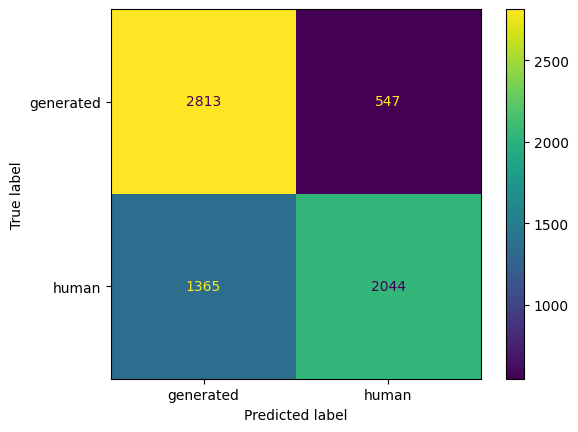

Linear Regression
Best parameters: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
Best CV score: 0.7405355493998153
              precision    recall  f1-score   support

   generated       0.76      0.77      0.76      3360
       human       0.77      0.76      0.76      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



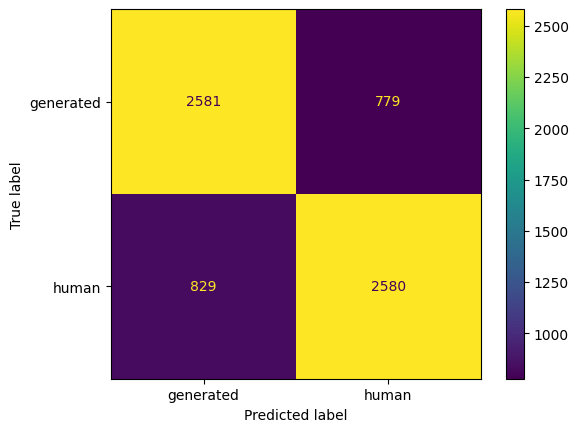

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.7378743463433117
              precision    recall  f1-score   support

   generated       0.77      0.78      0.77      3360
       human       0.78      0.76      0.77      3409

    accuracy                           0.77      6769
   macro avg       0.77      0.77      0.77      6769
weighted avg       0.77      0.77      0.77      6769



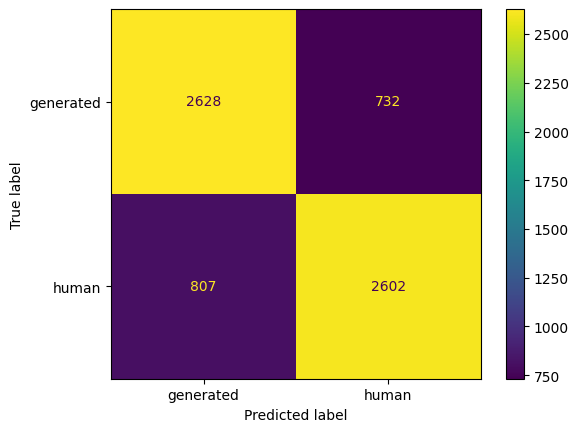

In [58]:
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

By comparing the accuracies, there seems to be a slight improvement in the *SVM* case, but the results are quite symmetrical overall.

Now we can try to integrate the POS information and the average distance from root of each sentence for each word (ADFR) into our models, to do so we vectorize the tags using a **TfidfVectorizer** (noticing that a **Countvectorizer** would produce slightly better results for tree-based methods) for the POS tags and we normalize the ADFR using a **MinMaxScaler**.

The various metrics are then concatenated into a single vector  and we apply the same models using our established cross-validation approach.

In [59]:
x_lem = parsed_df["features"].apply(lambda x: " ".join([t["lem"] for t in x]))
x_pos = parsed_df["features"].apply(lambda x: " ".join([t["pos"] for t in x]))
x_avgdfr = parsed_df["features"].apply(lambda x: sum(t["dfr"] for t in x) / len(x))
y = parsed_df["label"]
x_train_lem, x_val_lem, x_test_lem, y_train, y_val, y_test = split(
    x_lem, y, test_size=0.2, val_size=0.0, seed=seed
)
x_train_pos, x_val_pos, x_test_pos, y_train, y_val, y_test = split(
    x_pos, y, test_size=0.2, val_size=0.0, seed=seed
)
x_train_avgdfr, x_val_avgdfr, x_test_avgdfr, y_train, y_val, y_test = split(
    x_avgdfr, y, test_size=0.2, val_size=0.0, seed=seed
)

In [60]:
# Vectorize lemmas
vectorizer = TfidfVectorizer(min_df=4, ngram_range=(2,2))
x_train_lem = vectorizer.fit_transform(x_train_lem)
x_test_lem = vectorizer.transform(x_test_lem)

# Vectorize POS tags
vectorizer = TfidfVectorizer(min_df=4)
x_train_pos = vectorizer.fit_transform(x_train_pos)
x_test_pos = vectorizer.transform(x_test_pos)

# Normalize average distance from root
mms = MinMaxScaler()

x_train_avgdfr = mms.fit_transform(x_train_avgdfr.values.reshape(-1, 1))
x_test_avgdfr = mms.transform(x_test_avgdfr.values.reshape(-1, 1))

x_train_avgdfr = sps.csr_matrix(x_train_avgdfr)
x_test_avgdfr = sps.csr_matrix(x_test_avgdfr)

# Concatenate vectors
x_train = sps.hstack([x_train_lem, x_train_pos, x_train_avgdfr])
x_test = sps.hstack([x_test_lem, x_test_pos, x_test_avgdfr])

In [61]:
models = []

# Naive Bayes
nb = MultinomialNB()
nb_param = {"alpha":[0.001, 0.01, 0.1, 1, 10, 100]}
nb_clf = GridSearchCV(nb, nb_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Naive Bayes", 
    "model": nb_clf,
})

# Logistic Regression
lr = LogisticRegression(max_iter=100000)
lr_param = [{
    "solver": ["liblinear"], 
    "penalty": ["l1", "l2"],
    "C":[0.01, 0.1, 1, 10]
},{
    "solver": ("lbfgs", "sag", "saga"), 
    "penalty": ["l2"],
    "C":[0.01, 0.1, 1]
}]
lr_clf = GridSearchCV(lr, lr_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Linear Regression",
    "model": lr_clf,
    "subsample": 0.8,
})

# SVC
svc = SVC()
svc_param = {"kernel": ["rbf"], "C": [0.1, 1, 10]}
svc_clf = GridSearchCV(svc, svc_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "SVC", 
    "model": svc_clf,
    "subsample": 0.7,
})

# Decision Tree
dtree = DecisionTreeClassifier()
dtree_param = {
    "criterion": ["gini", "entropy"], 
    "max_features": [None, "sqrt", "log2"],
}
dtree_clf =  GridSearchCV(dtree, dtree_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Decision Tree",
    "model": dtree_clf,
})

# Random Forest
rf = RandomForestClassifier()
rf_param = {
    "criterion": ["gini", "entropy"], 
}
rf_clf =  GridSearchCV(rf, rf_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Random Forest",
    "model": rf_clf,
    "subsample": 0.6,
})

# Extra Trees
et = ExtraTreesClassifier()
et_param = {
    "criterion": ["gini", "entropy"], 
}
et_clf =  GridSearchCV(et, et_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Extra Trees",
    "model": et_clf,
    "subsample": 0.6,
})

>> Training Naive Bayes
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Decision Tree
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
Naive Bayes
Best parameters: {'alpha': 0.1}
Best CV score: 0.7238881955725043
              precision    recall  f1-score   support

   generated       0.67      0.85      0.75      3360
       human       0.79      0

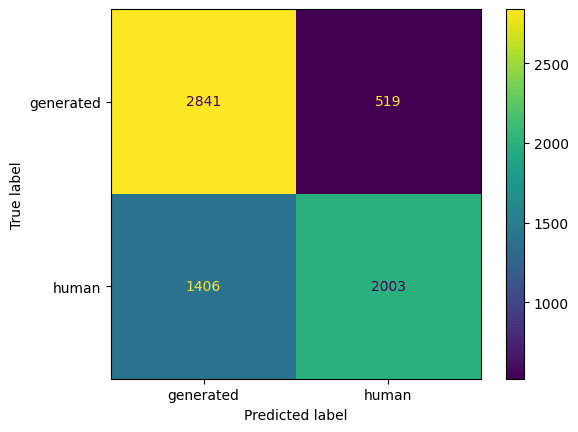

Linear Regression
Best parameters: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
Best CV score: 0.7623268698060942
              precision    recall  f1-score   support

   generated       0.79      0.80      0.80      3360
       human       0.80      0.79      0.80      3409

    accuracy                           0.80      6769
   macro avg       0.80      0.80      0.80      6769
weighted avg       0.80      0.80      0.80      6769



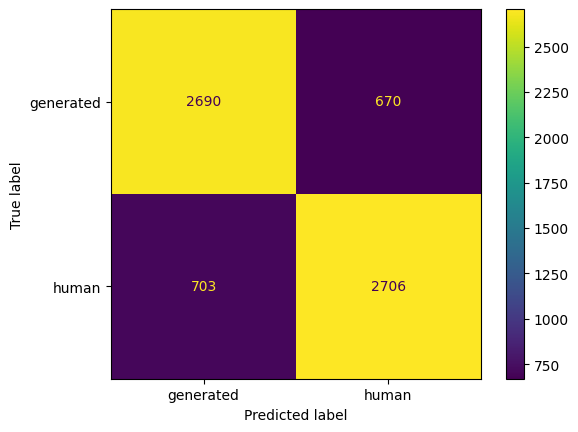

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.7839232284956423
              precision    recall  f1-score   support

   generated       0.81      0.82      0.81      3360
       human       0.82      0.81      0.82      3409

    accuracy                           0.82      6769
   macro avg       0.82      0.82      0.82      6769
weighted avg       0.82      0.82      0.82      6769



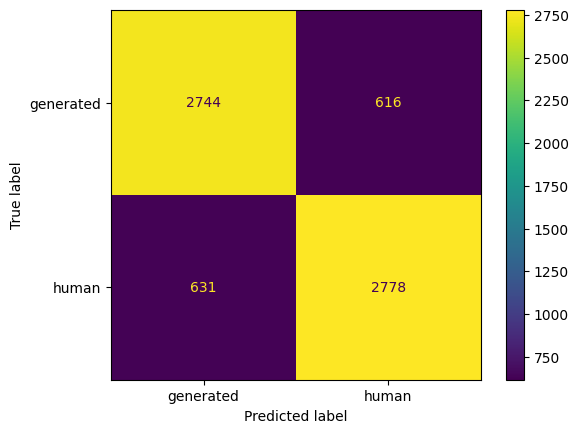

Decision Tree
Best parameters: {'criterion': 'gini', 'max_features': None}
Best CV score: 0.6911657944519232
              precision    recall  f1-score   support

   generated       0.70      0.71      0.71      3360
       human       0.71      0.71      0.71      3409

    accuracy                           0.71      6769
   macro avg       0.71      0.71      0.71      6769
weighted avg       0.71      0.71      0.71      6769



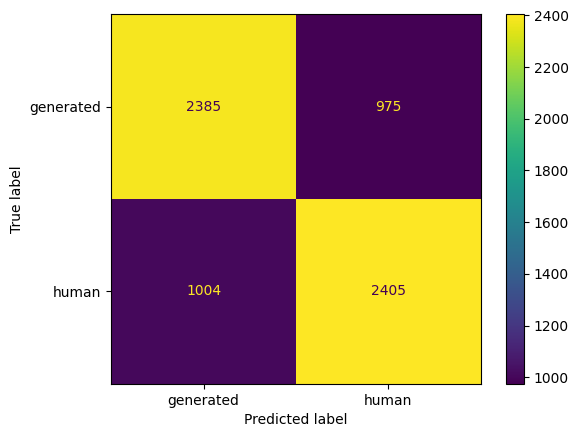

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.771837488457987
              precision    recall  f1-score   support

   generated       0.79      0.79      0.79      3360
       human       0.80      0.80      0.80      3409

    accuracy                           0.79      6769
   macro avg       0.79      0.79      0.79      6769
weighted avg       0.79      0.79      0.79      6769



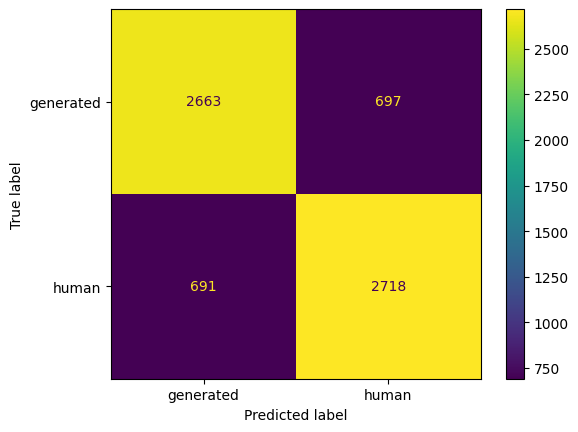

Extra Trees
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7748845798707295
              precision    recall  f1-score   support

   generated       0.81      0.78      0.80      3360
       human       0.79      0.82      0.81      3409

    accuracy                           0.80      6769
   macro avg       0.80      0.80      0.80      6769
weighted avg       0.80      0.80      0.80      6769



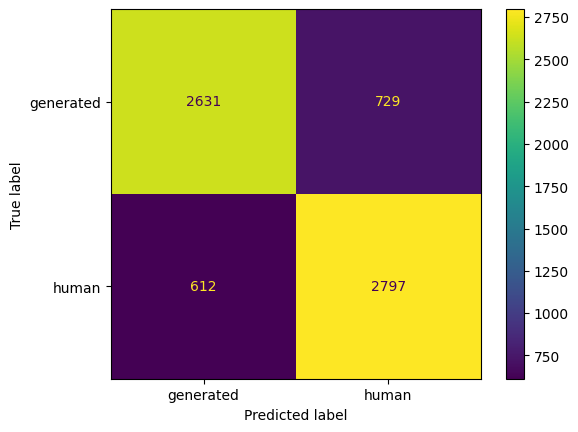

In [62]:
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

As we can see, the addition of these new features significantly improved the performance of more complex models, while models on the simpler side retained their accuracy found in previous experiments or returned worse results.

#### Other approaches

##### Neural network classifier

Another approach that was experimented upon consisted in building a neural network classifier from scratch utilizing *pytorch* to perform classification on the Bag of Words representation (both augmented and non-augmented).

The results were quite underwhelming with regards to the training time and resources spent, since in every scenario it performed similarly to the SVM.

This approach will not be presented here but the source code used for the implementation of the clasifier can be found under the [corresponding section](#Preliminary-initialization).

##### SVM on extracted features

Training an SVM **only** on the features obtained in the [data exploration section](#Data-Exploration), it is possible to obtain an accuracy around 80%.

This result is particularly interesting since no direct text information is given to the classifier, only derived statistics and metrics.

### Text embedding approaches

In [63]:
df = pd.read_csv(dataset_path, sep="\t", header=0)
pd.set_option('display.max_colwidth', 150)
df = df.drop("id", axis=1)

df.head()

,text,label
0,you need to stop the engine and wait until it stops. This is how I would do it: // Check if its safe,generated
1,"The Commission shall publish the report; an interim report at least once every two years, and whenever it considers that such a report is necessar...",generated
2,"I have not been tweeting a lot lately, but I did in November, and it was a really good month. I also",generated
3,I pass my exam and really thankgod for that but idk where will I go for shsmy result is ah,human
4,"The template will have 3 parts: a mustache shape, a bow tie shape, and a skinny rectangle. The mustache shape will eventually make the bow loops. ...",human


We shuffle the dataset and we exchange the categorical values with binary ones.

In [65]:
df.sample(frac=1)
df['label'] = df['label'].replace({'generated':0, 'human':1})

#### Helper functions used for preprocessing and model setup
We define some useful functions to preprocess our dataset for usage with word embeddings, we have:
- **vectorize**: vectorizes a list of documents utilizing a given embedding model;
- **prep_datset**: prepares train/val/test splits from a dataset and a given word embedding model;
- **setup_models**: defines a common set of *scikit-learn* cross-validation classifiers.

In [66]:
def vectorize(docs, embedding_model, useSum=False, dim=50, built=True):
    regex = '[' + string.punctuation + ']'
    vectors = np.zeros((len(docs),dim))
    for i in range(len(docs)):
        tokens = re.sub(regex, '', docs[i]).split()
        if built:
            embeddings = [embedding_model.wv[token] for token in tokens if token in embedding_model.wv.key_to_index]
        else:
            embeddings = [embedding_model.get_vector(token) for token in tokens if token in embedding_model]
        
        if (len(embeddings) > 0):
            if (useSum): 
                vectors[i] = sum(embeddings)
            else:
                vectors[i] = np.mean(embeddings, axis=0)
    return vectors

In [67]:
def prep_dataset(df, word_embeds, dim=50, tr=False):
    if isinstance(word_embeds, str):
        if tr:
            embd = SentenceTransformer(word_embeds)
            x_train = embd.encode(np.array(df.text), convert_to_tensor=False)
        else:
            model = api.load(word_embeds)
            x_train = vectorize(np.array(df['text']), model, True, dim, False)
    else:
        model= Word2Vec(word_embeds, vector_size=dim, min_count=5, window=10)
        x_train = vectorize(np.array(df['text']), model, True, dim, True)
        
    y_train= np.array(df['label'])
    x_train, x_val, x_test, y_train, y_val, y_test = split(x_train, y_train, test_size=0.2, val_size=0.0)
    return x_train, x_test, y_train, y_test

In [68]:
def setup_models_complete():   
    models = []
    
    # Logistic Regression
    lr = LogisticRegression(max_iter=1000)
    lr_param = [
        {
        "solver": ["liblinear"], 
        "penalty": ["l1", "l2"],
         "C":[0.01, 0.1, 1, 10]
     },{
         "solver": ("lbfgs", "sag", "saga"), 
         "penalty": ["l2"],
        "C":[0.01, 0.1, 1]
    }
    ]
    lr_clf = GridSearchCV(lr, lr_param, cv=5, scoring="f1_micro", verbose=1)
    models.append({
        "name": "Linear Regression",
        "model": lr_clf,
        "subsample": 0.7,
    })

    # SVC
    svc = SVC()
    svc_param = {"kernel": ["rbf"], "C": [0.1, 1, 10]}
    svc_clf = GridSearchCV(svc, svc_param, cv=5, scoring="f1_micro", verbose=1)
    models.append({
        "name": "SVC",
        "model": svc_clf,
        "subsample": 0.7,
    })

    # Decision Tree
    dtree = DecisionTreeClassifier()
    dtree_param = {
        "criterion": ["gini", "entropy"], 
        "max_features": [None, "sqrt", "log2"],
    }
    dtree_clf =  GridSearchCV(dtree, dtree_param, cv=5, scoring="f1_micro", verbose=1)
    models.append({
        "name": "Decision Tree",
        "model": dtree_clf,
    })

    # Random Forest
    rf = RandomForestClassifier()
    rf_param = {
        "criterion": ["gini", "entropy"], 
    }
    rf_clf =  GridSearchCV(rf, rf_param, cv=5, scoring="f1_micro", verbose=1)
    models.append({
        "name": "Random Forest",
        "model": rf_clf,
        "subsample": 0.6,
    })

    # Extra Trees
    et = ExtraTreesClassifier()
    et_param = {
        "criterion": ["gini", "entropy"], 
    }
    et_clf =  GridSearchCV(et, et_param, cv=5, scoring="f1_micro", verbose=1)
    models.append({
        "name": "Extra Trees",
        "model": et_clf,
        "subsample": 0.6,
    })
    # KNeighbors
    kn = KNeighborsClassifier()
    kn_param = {
        "n_neighbors": [1,3,5],
        "weights": ["uniform", "distance"]
    }
    kn_clf = GridSearchCV(kn, kn_param, cv=5, scoring="f1_micro", verbose=1)
    models.append({
        "name": "KNeighbors",
        "model": kn_clf
    })

    # XGBoost
    #xgb = GradientBoostingClassifier(loss="exponential")
    #xgb_param = {
    #    "n_estimators": [50, 200],
    #    "criterion": ["friedman_mse", "squared_error"]
    #}
    #xgb_clf = GridSearchCV(xgb, xgb_param, cv=5, scoring="f1_micro", verbose=1)
    #models.append({
    #    "name": "XGBoost",
    #    "model": xgb_clf
    #})
    
    return models

In [69]:
def setup_models():   
    models = []
    
    # Logistic Regression
    lr = LogisticRegression(max_iter=1000)
    lr_param = [
        {
        "solver": ["liblinear"], 
        "penalty": ["l1", "l2"],
         "C":[0.01, 0.1, 1, 10]
     },{
         "solver": ("lbfgs", "sag", "saga"), 
         "penalty": ["l2"],
        "C":[0.01, 0.1, 1]
    }
    ]
    lr_clf = GridSearchCV(lr, lr_param, cv=5, scoring="f1_micro", verbose=1)
    models.append({
        "name": "Linear Regression",
        "model": lr_clf,
        "subsample": 0.7,
    })

    # SVC
    svc = SVC()
    svc_param = {"kernel": ["rbf"], "C": [0.1, 1, 10]}
    svc_clf = GridSearchCV(svc, svc_param, cv=5, scoring="f1_micro", verbose=1)
    models.append({
        "name": "SVC",
        "model": svc_clf,
        "subsample": 0.7,
    })

    # Random Forest
    rf = RandomForestClassifier()
    rf_param = {
        "criterion": ["gini", "entropy"], 
    }
    rf_clf =  GridSearchCV(rf, rf_param, cv=5, scoring="f1_micro", verbose=1)
    models.append({
        "name": "Random Forest",
        "model": rf_clf,
        "subsample": 0.6,
    })
    
    return models

#### Building our word embedding

We decide to start by trying to build our own word embedding model,then to explore the pretrained ones.
First of all, we prepared the sentences by applying some regular expression to remove spaces,then we have splitted our sentences into words.Finally this words are transformed into tokens by lowering their case.

In [70]:
docs = [re.sub('\n', ' ', doc) for doc in df.text]
sentences = [re.split('[?!.]\s', doc) for doc in docs]
sentences = list(flatten(sentences))
sentences[:3]

['you need to stop the engine and wait until it stops',
 'This is how I would do it: // Check if its safe',
 'The Commission shall publish the report; an interim report at least once every two years, and whenever it considers that such a report is necessary or appropriate']

In [72]:
tokenized_sentences = [re.sub('\W', ' ', sentence).lower().split() for sentence in sentences]

We have trained various *Word2Vec* models with different dimensions.
We understood that more parameters give a better results, but after 200 we didn't see any improvements,probably because the training dataset is too small.

Dimension of embedding: 50
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Decision Tree
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training KNeighbors
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training XGBoost
   Fitting 5 folds for each of 4 candidates, totalling 20 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 0.1, 'penalty': 'l1', 's

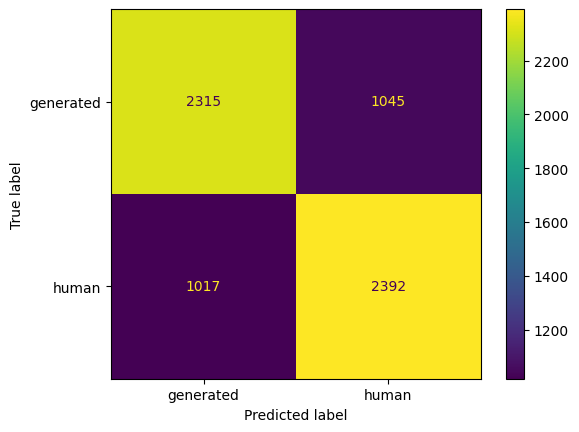

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.7579417961348996
              precision    recall  f1-score   support

           0       0.78      0.77      0.78      3360
           1       0.77      0.79      0.78      3409

    accuracy                           0.78      6769
   macro avg       0.78      0.78      0.78      6769
weighted avg       0.78      0.78      0.78      6769



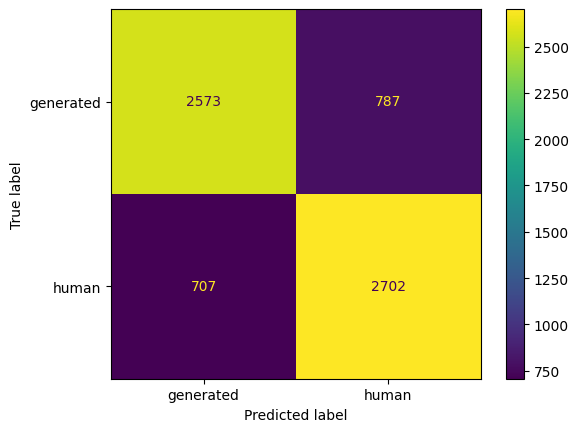

Decision Tree
Best parameters: {'criterion': 'gini', 'max_features': None}
Best CV score: 0.6643889995921936
              precision    recall  f1-score   support

           0       0.66      0.66      0.66      3360
           1       0.66      0.67      0.67      3409

    accuracy                           0.66      6769
   macro avg       0.66      0.66      0.66      6769
weighted avg       0.66      0.66      0.66      6769



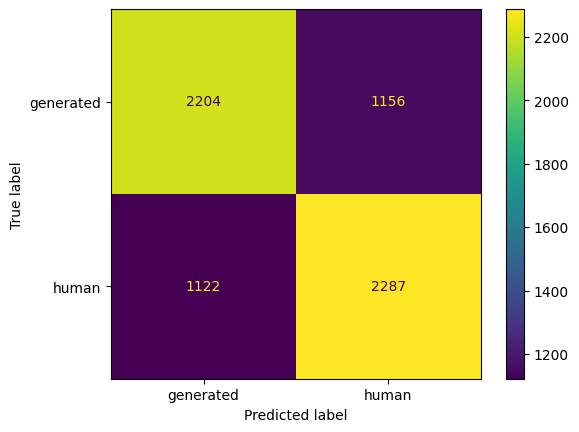

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7542936288088643
              precision    recall  f1-score   support

           0       0.75      0.74      0.75      3360
           1       0.75      0.76      0.75      3409

    accuracy                           0.75      6769
   macro avg       0.75      0.75      0.75      6769
weighted avg       0.75      0.75      0.75      6769



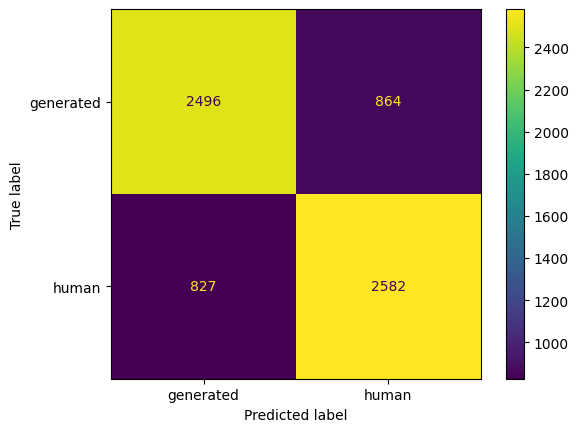

Extra Trees
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7559556786703602
              precision    recall  f1-score   support

           0       0.76      0.75      0.75      3360
           1       0.76      0.76      0.76      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



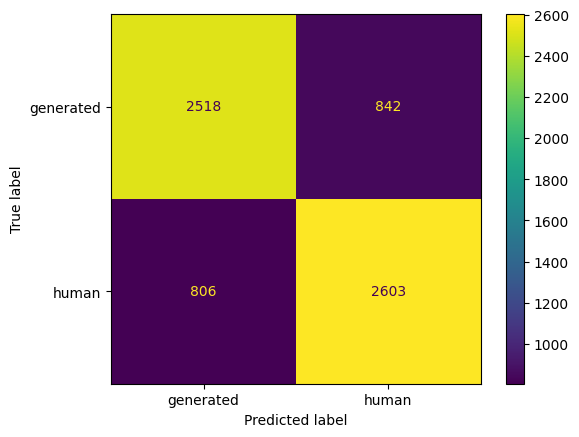

KNeighbors
Best parameters: {'n_neighbors': 5, 'weights': 'distance'}
Best CV score: 0.7294649143265535
              precision    recall  f1-score   support

           0       0.74      0.71      0.72      3360
           1       0.72      0.75      0.74      3409

    accuracy                           0.73      6769
   macro avg       0.73      0.73      0.73      6769
weighted avg       0.73      0.73      0.73      6769



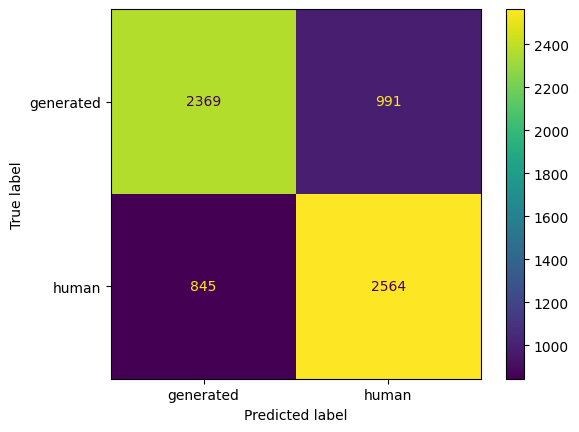

XGBoost
Best parameters: {'criterion': 'squared_error', 'n_estimators': 200}
Best CV score: 0.7442385954001072
              precision    recall  f1-score   support

           0       0.74      0.71      0.72      3360
           1       0.73      0.75      0.74      3409

    accuracy                           0.73      6769
   macro avg       0.73      0.73      0.73      6769
weighted avg       0.73      0.73      0.73      6769



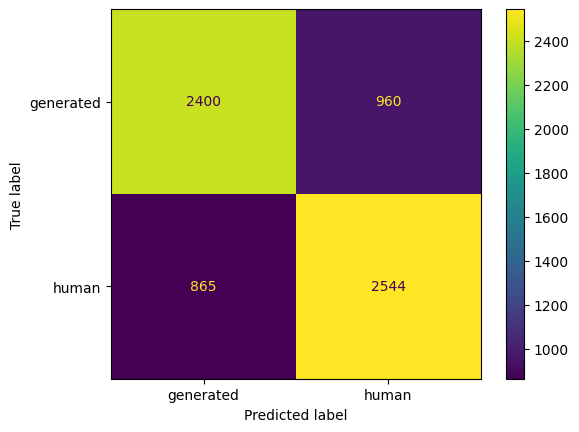

Dimension of embedding: 100
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits


/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning

   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Decision Tree
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training KNeighbors
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training XGBoost
   Fitting 5 folds for each of 4 candidates, totalling 20 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 0.01, 'penalty': 'l2', 'solver': 'liblinear'}
Best CV score: 0.717557938613111
              precision    recall  f1-score   support

           

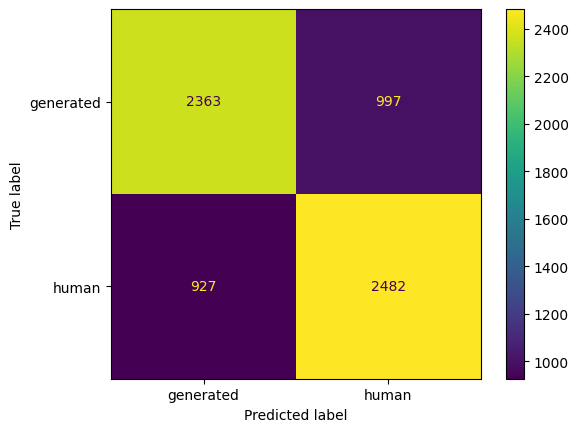

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.7670528230390299
              precision    recall  f1-score   support

           0       0.80      0.78      0.79      3360
           1       0.79      0.80      0.80      3409

    accuracy                           0.79      6769
   macro avg       0.79      0.79      0.79      6769
weighted avg       0.79      0.79      0.79      6769



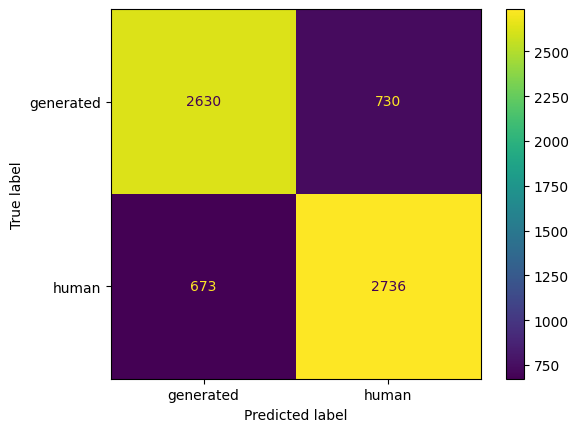

Decision Tree
Best parameters: {'criterion': 'entropy', 'max_features': None}
Best CV score: 0.6724035687835774
              precision    recall  f1-score   support

           0       0.67      0.66      0.67      3360
           1       0.67      0.67      0.67      3409

    accuracy                           0.67      6769
   macro avg       0.67      0.67      0.67      6769
weighted avg       0.67      0.67      0.67      6769



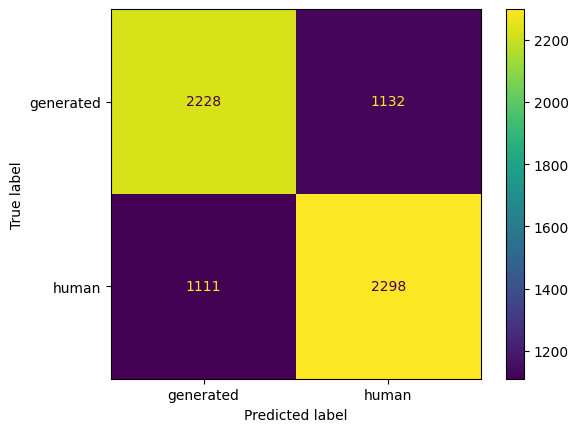

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7607571560480147
              precision    recall  f1-score   support

           0       0.76      0.76      0.76      3360
           1       0.77      0.77      0.77      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



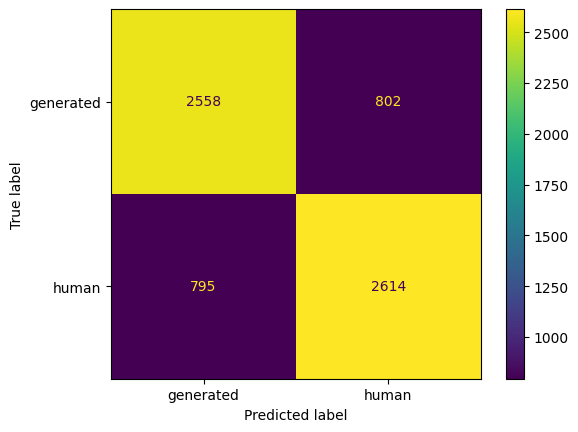

Extra Trees
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7552169898430287
              precision    recall  f1-score   support

           0       0.76      0.77      0.77      3360
           1       0.77      0.77      0.77      3409

    accuracy                           0.77      6769
   macro avg       0.77      0.77      0.77      6769
weighted avg       0.77      0.77      0.77      6769



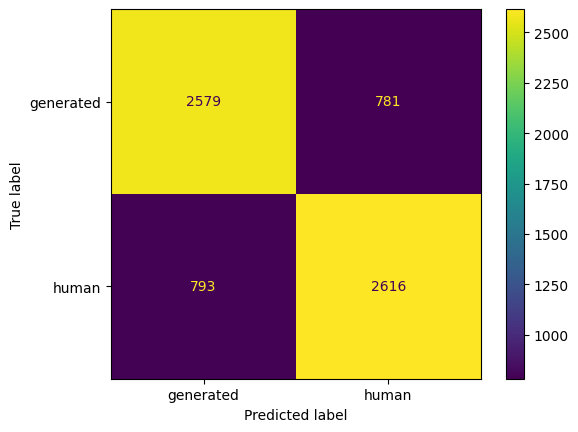

KNeighbors
Best parameters: {'n_neighbors': 5, 'weights': 'distance'}
Best CV score: 0.7307945610352555
              precision    recall  f1-score   support

           0       0.74      0.70      0.72      3360
           1       0.72      0.76      0.74      3409

    accuracy                           0.73      6769
   macro avg       0.73      0.73      0.73      6769
weighted avg       0.73      0.73      0.73      6769



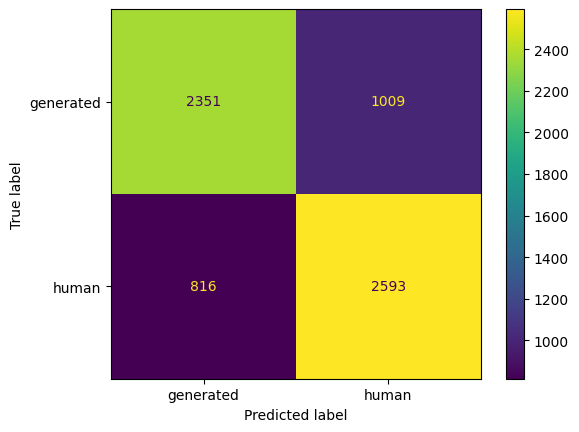

XGBoost
Best parameters: {'criterion': 'friedman_mse', 'n_estimators': 200}
Best CV score: 0.7538041929047138
              precision    recall  f1-score   support

           0       0.74      0.74      0.74      3360
           1       0.75      0.75      0.75      3409

    accuracy                           0.74      6769
   macro avg       0.74      0.74      0.74      6769
weighted avg       0.74      0.74      0.74      6769



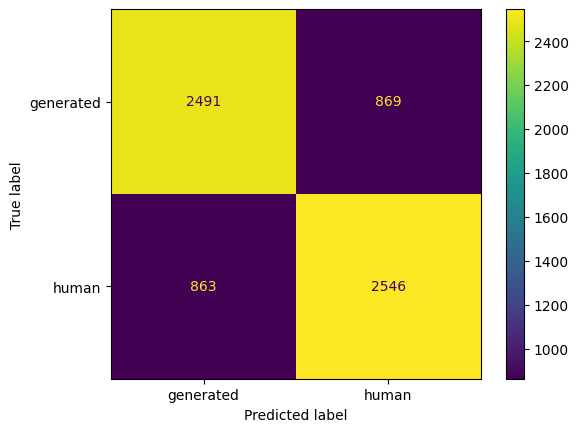

Dimension of embedding: 200
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits


/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning

   Found best model... 

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Decision Tree
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training KNeighbors
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training XGBoost
   Fitting 5 folds for each of 4 candidates, totalling 20 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 0.1, 'penalty': 'l2', 'solver': 'saga'}
Best CV score: 0.7224807881773398
              precision    recall  f1-score   support

           0       0.73      0.72      

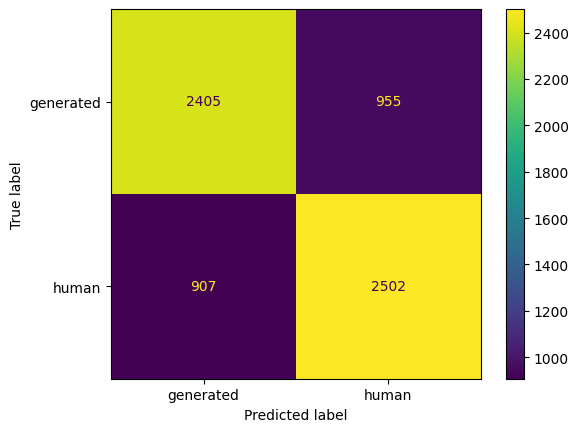

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.7712385752178855
              precision    recall  f1-score   support

           0       0.80      0.78      0.79      3360
           1       0.79      0.81      0.80      3409

    accuracy                           0.79      6769
   macro avg       0.79      0.79      0.79      6769
weighted avg       0.79      0.79      0.79      6769



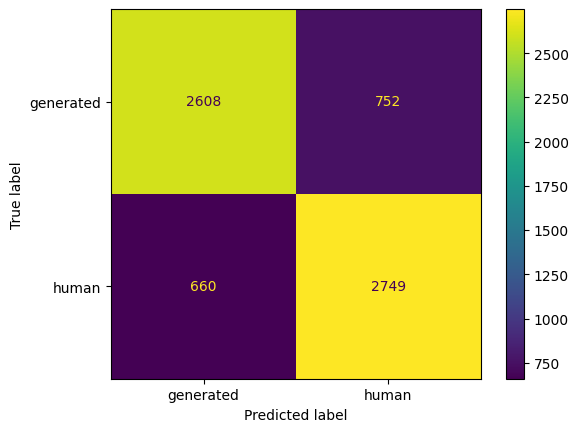

Decision Tree
Best parameters: {'criterion': 'gini', 'max_features': None}
Best CV score: 0.67221890339625
              precision    recall  f1-score   support

           0       0.67      0.66      0.66      3360
           1       0.67      0.67      0.67      3409

    accuracy                           0.67      6769
   macro avg       0.67      0.67      0.67      6769
weighted avg       0.67      0.67      0.67      6769



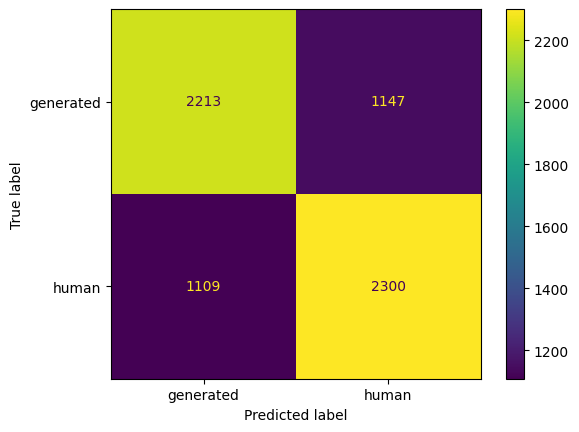

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7552169898430285
              precision    recall  f1-score   support

           0       0.76      0.76      0.76      3360
           1       0.77      0.76      0.76      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



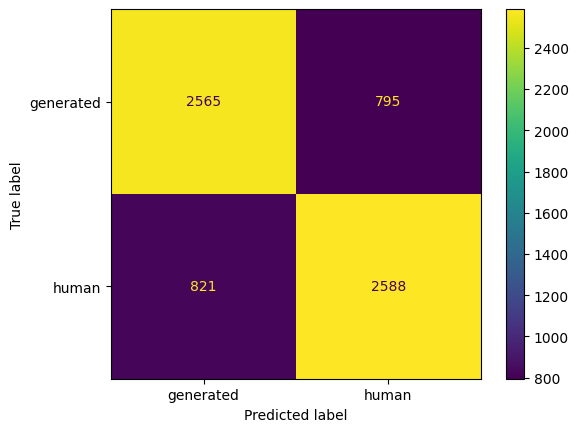

Extra Trees
Best parameters: {'criterion': 'gini'}
Best CV score: 0.7560480147737765
              precision    recall  f1-score   support

           0       0.76      0.76      0.76      3360
           1       0.76      0.76      0.76      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



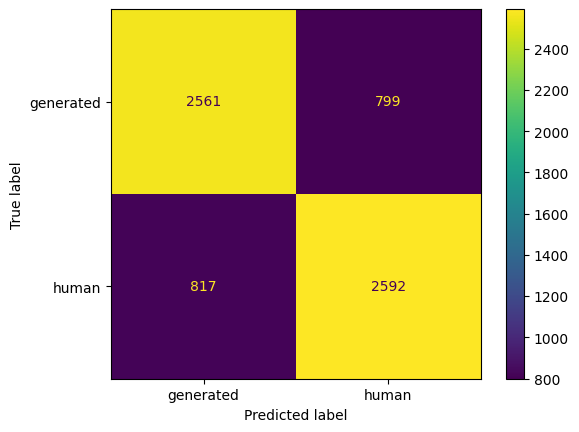

KNeighbors
Best parameters: {'n_neighbors': 5, 'weights': 'distance'}
Best CV score: 0.7308314886571166
              precision    recall  f1-score   support

           0       0.74      0.70      0.72      3360
           1       0.72      0.76      0.74      3409

    accuracy                           0.73      6769
   macro avg       0.73      0.73      0.73      6769
weighted avg       0.73      0.73      0.73      6769



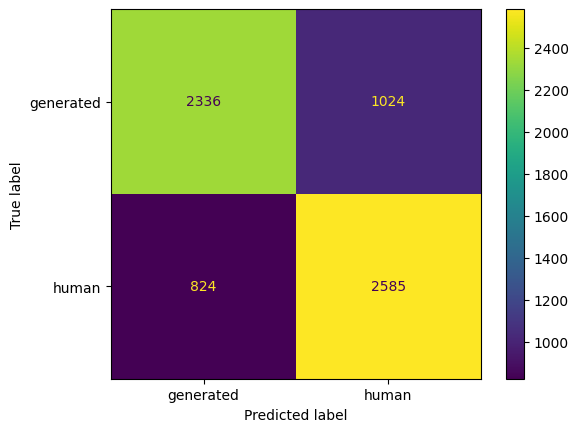

XGBoost
Best parameters: {'criterion': 'squared_error', 'n_estimators': 200}
Best CV score: 0.7594548964730882
              precision    recall  f1-score   support

           0       0.75      0.74      0.74      3360
           1       0.75      0.76      0.75      3409

    accuracy                           0.75      6769
   macro avg       0.75      0.75      0.75      6769
weighted avg       0.75      0.75      0.75      6769



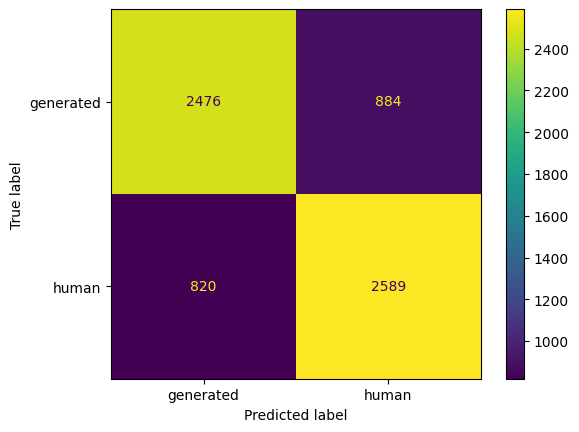

In [73]:
for i in [50,100,200]:
    print("Dimension of embedding: " + str(i))
    x_train, x_test, y_train, y_test = prep_dataset(df,tokenized_sentences, i)
    models = setup_models()
    train_cv_models(models, x_train, y_train)
    test_cv_models(models, x_test, y_test)

#### Word embedding with trained models

We have tried different models,from smaller one to the biggest:

- glove-wiki-gigaword-50 
- word2vec-google-news-300 
- fasttext-wiki-news-subwords-300 
- glove-twitter-100
- glove-twitter-200
- glove-twitter-25

Best results with word2vec-google-news-300 or fasttext-wiki-news-subwords-300 with around 82 percent accuracy on SVC.
Given that from our analysis the datset seems to contain news, it was expected that these 2 model worked well.
We had expected more from the twitter ones, probably we have less tweets compared to wiki entries.

[==================================================] 100.0% 1662.8/1662.8MB downloaded
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Decision Tree
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training KNeighbors
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training XGBoost
   Fitting 5 folds for each of 4 candidates, totalling 20 fits
   Found best model... Trained best model.
Linea

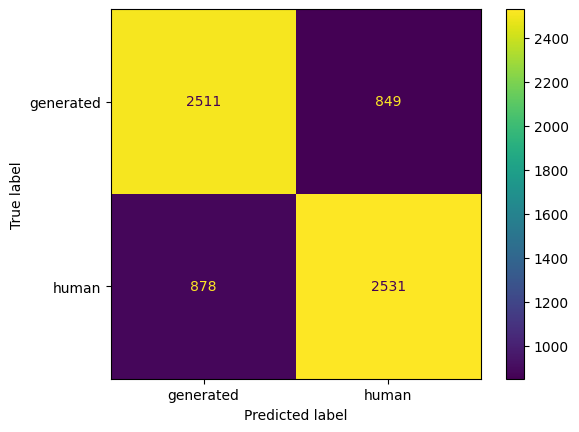

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.7945090564607806
              precision    recall  f1-score   support

           0       0.81      0.81      0.81      3360
           1       0.81      0.81      0.81      3409

    accuracy                           0.81      6769
   macro avg       0.81      0.81      0.81      6769
weighted avg       0.81      0.81      0.81      6769



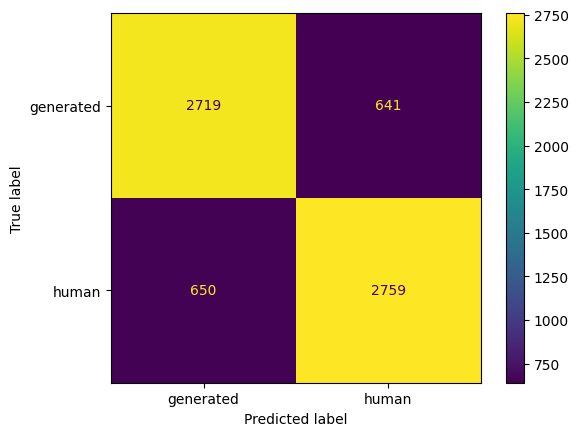

Decision Tree
Best parameters: {'criterion': 'entropy', 'max_features': None}
Best CV score: 0.6529768027703559
              precision    recall  f1-score   support

           0       0.66      0.66      0.66      3360
           1       0.67      0.67      0.67      3409

    accuracy                           0.67      6769
   macro avg       0.67      0.67      0.67      6769
weighted avg       0.67      0.67      0.67      6769



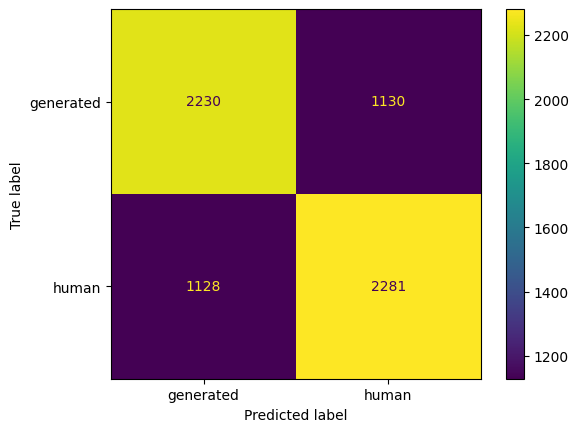

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7594644506001846
              precision    recall  f1-score   support

           0       0.75      0.77      0.76      3360
           1       0.77      0.75      0.76      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



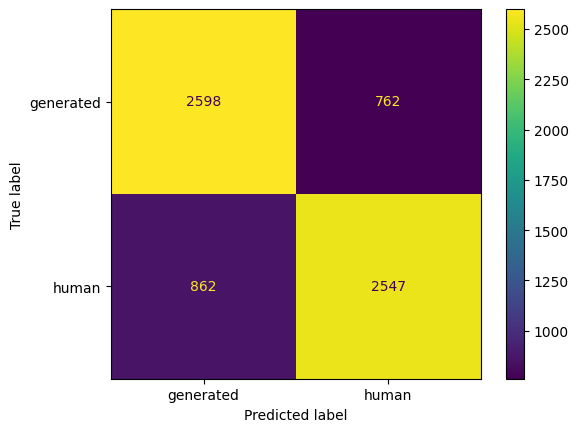

Extra Trees
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7545706371191135
              precision    recall  f1-score   support

           0       0.75      0.77      0.76      3360
           1       0.77      0.74      0.76      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



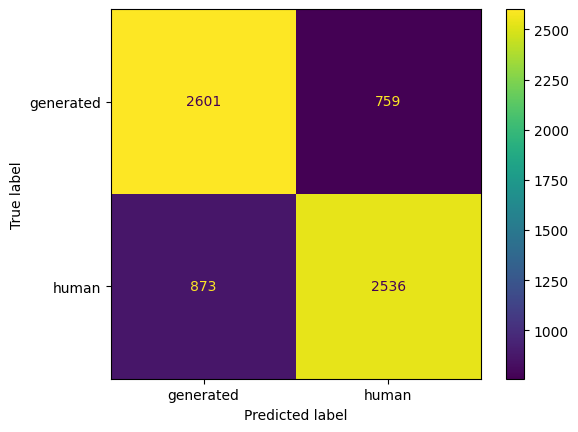

KNeighbors
Best parameters: {'n_neighbors': 5, 'weights': 'distance'}
Best CV score: 0.7139162851153383
              precision    recall  f1-score   support

           0       0.70      0.75      0.72      3360
           1       0.73      0.68      0.71      3409

    accuracy                           0.72      6769
   macro avg       0.72      0.72      0.72      6769
weighted avg       0.72      0.72      0.72      6769



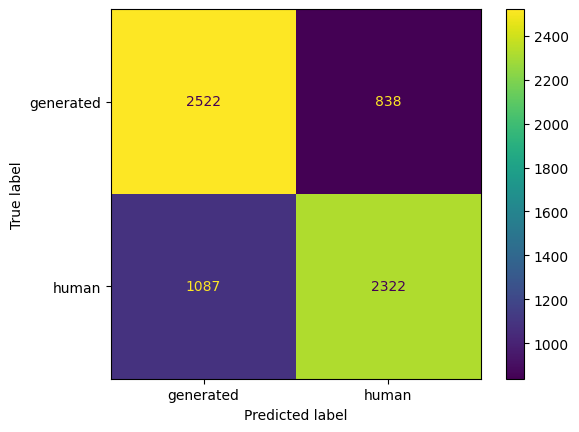

XGBoost
Best parameters: {'criterion': 'squared_error', 'n_estimators': 200}
Best CV score: 0.7677648866393614
              precision    recall  f1-score   support

           0       0.76      0.76      0.76      3360
           1       0.76      0.77      0.77      3409

    accuracy                           0.76      6769
   macro avg       0.76      0.76      0.76      6769
weighted avg       0.76      0.76      0.76      6769



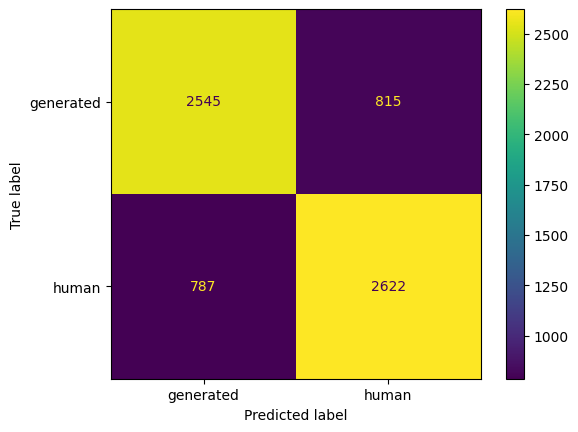

In [74]:
x_train, x_test, y_train, y_test = prep_dataset(df,"word2vec-google-news-300", 300)
models = setup_models()
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

#### Word embedding with Transformers

We have employed the embedding provided from the Sentence Trasformers as a base and the we trained some simple models over it.We have tried different trasformers:

- all-mpnet-base-v2
- multi-qa-mpnet-base-dot-v1
- all-distilroberta-v1
- all-MiniLM-L12-v2
- distiluse-base-multilingual-cased-v1

The results were pretty similar.'all-mpnet-base-v2' was expected to produce good results and he didi produce good results.While,quite surprisingly, the embedding from 'multi-qa-mpnet-base-dot-v1',trained on a large and diverse set of (question, answer) pairs performed on par with the previous.This gave us the hint that maybe the generated sentences are answers to some questions.

>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Decision Tree
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training KNeighbors
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training XGBoost
   Fitting 5 folds for each of 4 candidates, totalling 20 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
Best CV

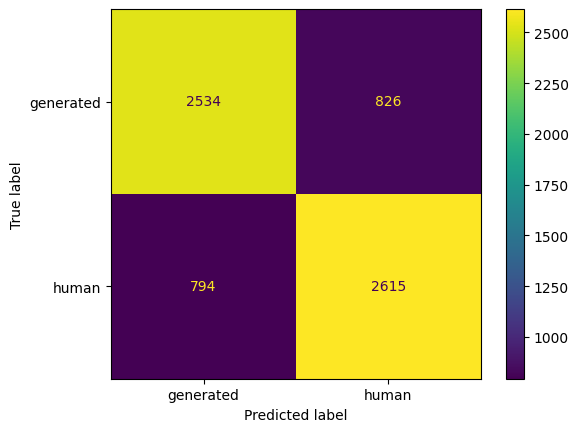

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.7616353164077301
              precision    recall  f1-score   support

           0       0.80      0.80      0.80      3360
           1       0.80      0.80      0.80      3409

    accuracy                           0.80      6769
   macro avg       0.80      0.80      0.80      6769
weighted avg       0.80      0.80      0.80      6769



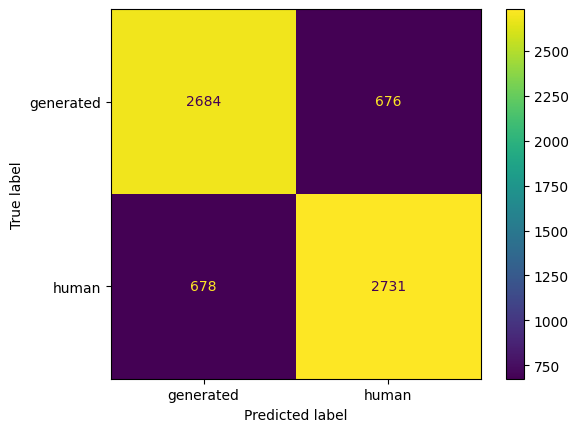

Decision Tree
Best parameters: {'criterion': 'gini', 'max_features': None}
Best CV score: 0.6091741851713947
              precision    recall  f1-score   support

           0       0.61      0.59      0.60      3360
           1       0.61      0.62      0.61      3409

    accuracy                           0.61      6769
   macro avg       0.61      0.61      0.61      6769
weighted avg       0.61      0.61      0.61      6769



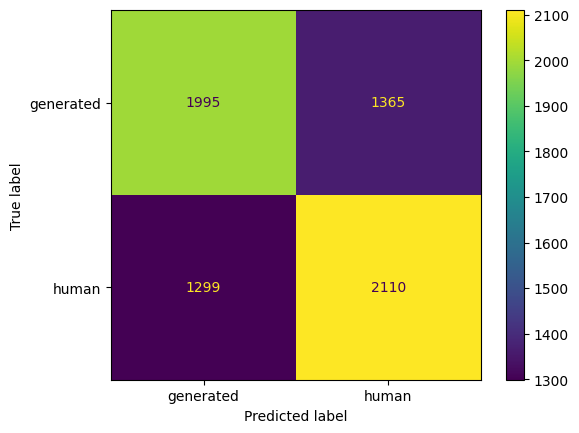

Random Forest
Best parameters: {'criterion': 'gini'}
Best CV score: 0.7024930747922439
              precision    recall  f1-score   support

           0       0.68      0.76      0.72      3360
           1       0.73      0.64      0.68      3409

    accuracy                           0.70      6769
   macro avg       0.70      0.70      0.70      6769
weighted avg       0.70      0.70      0.70      6769



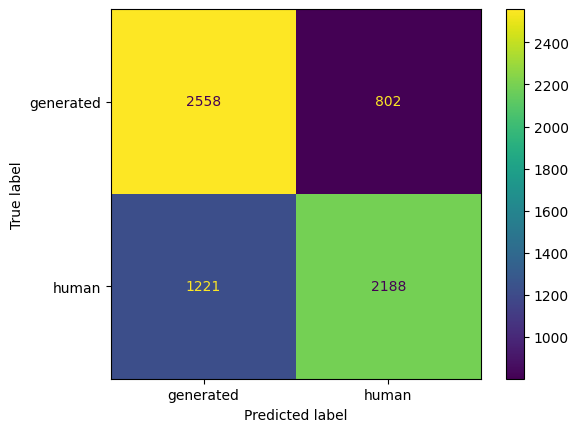

Extra Trees
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.6925207756232686
              precision    recall  f1-score   support

           0       0.68      0.77      0.72      3360
           1       0.74      0.65      0.69      3409

    accuracy                           0.71      6769
   macro avg       0.71      0.71      0.71      6769
weighted avg       0.71      0.71      0.71      6769



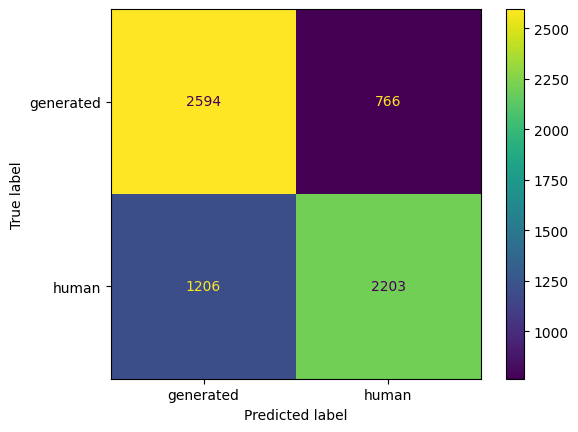

KNeighbors
Best parameters: {'n_neighbors': 5, 'weights': 'distance'}
Best CV score: 0.6781650279395137
              precision    recall  f1-score   support

           0       0.68      0.66      0.67      3360
           1       0.68      0.69      0.69      3409

    accuracy                           0.68      6769
   macro avg       0.68      0.68      0.68      6769
weighted avg       0.68      0.68      0.68      6769



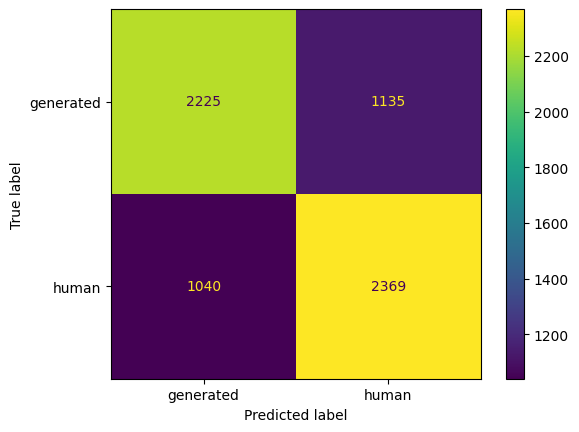

XGBoost
Best parameters: {'criterion': 'squared_error', 'n_estimators': 200}
Best CV score: 0.7276183422873439
              precision    recall  f1-score   support

           0       0.72      0.73      0.72      3360
           1       0.73      0.72      0.72      3409

    accuracy                           0.72      6769
   macro avg       0.72      0.72      0.72      6769
weighted avg       0.72      0.72      0.72      6769



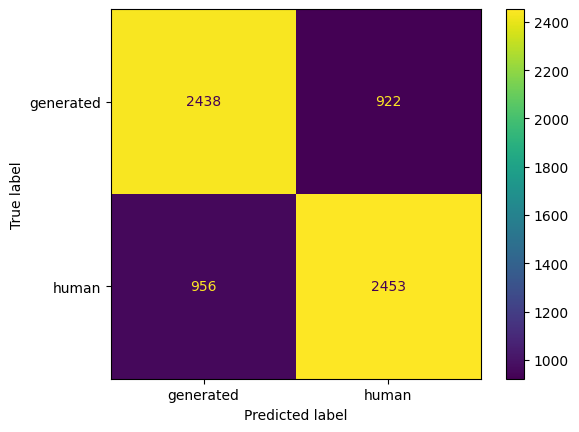

In [75]:
x_train, x_test, y_train, y_test = prep_dataset(df,'all-mpnet-base-v2', tr=True)
models = setup_models()
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Decision Tree
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training KNeighbors
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training XGBoost
   Fitting 5 folds for each of 4 candidates, totalling 20 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}
Best CV 

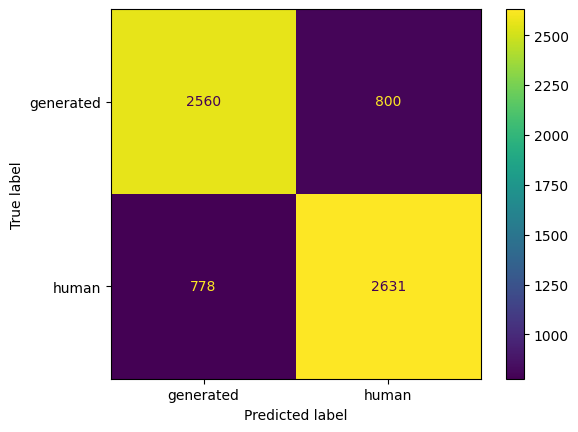

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.7735798408488064
              precision    recall  f1-score   support

           0       0.80      0.81      0.81      3360
           1       0.82      0.80      0.81      3409

    accuracy                           0.81      6769
   macro avg       0.81      0.81      0.81      6769
weighted avg       0.81      0.81      0.81      6769



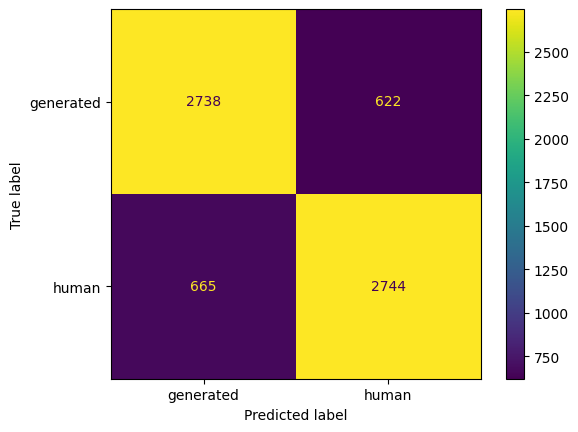

Decision Tree
Best parameters: {'criterion': 'entropy', 'max_features': None}
Best CV score: 0.6235410350099768
              precision    recall  f1-score   support

           0       0.62      0.62      0.62      3360
           1       0.63      0.62      0.62      3409

    accuracy                           0.62      6769
   macro avg       0.62      0.62      0.62      6769
weighted avg       0.62      0.62      0.62      6769



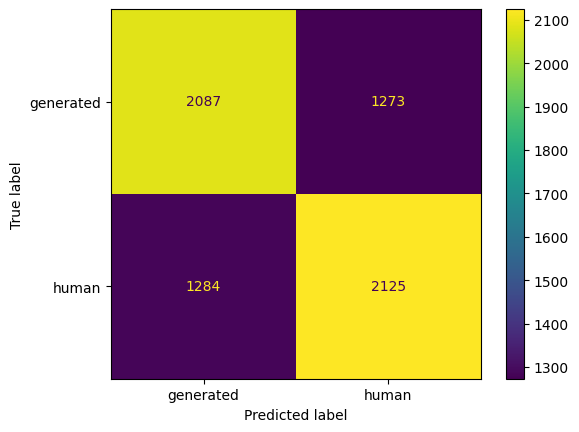

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7147737765466298
              precision    recall  f1-score   support

           0       0.70      0.76      0.73      3360
           1       0.74      0.68      0.71      3409

    accuracy                           0.72      6769
   macro avg       0.72      0.72      0.72      6769
weighted avg       0.72      0.72      0.72      6769



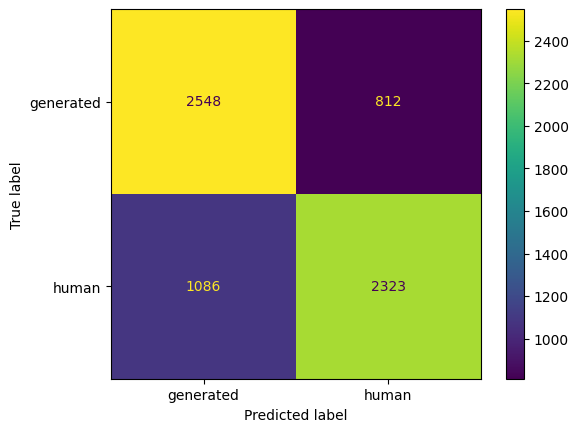

Extra Trees
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.7126500461680517
              precision    recall  f1-score   support

           0       0.70      0.76      0.73      3360
           1       0.74      0.67      0.70      3409

    accuracy                           0.72      6769
   macro avg       0.72      0.72      0.72      6769
weighted avg       0.72      0.72      0.72      6769



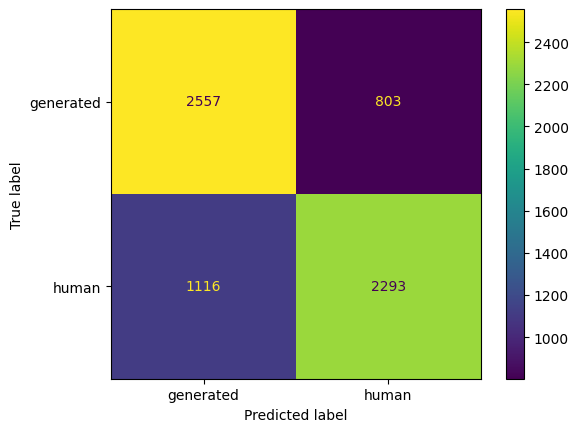

KNeighbors
Best parameters: {'n_neighbors': 5, 'weights': 'uniform'}
Best CV score: 0.6772047392834881
              precision    recall  f1-score   support

           0       0.66      0.72      0.69      3360
           1       0.70      0.64      0.67      3409

    accuracy                           0.68      6769
   macro avg       0.68      0.68      0.68      6769
weighted avg       0.68      0.68      0.68      6769



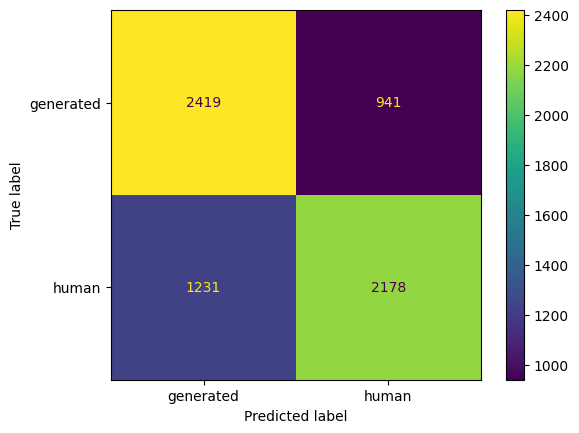

XGBoost
Best parameters: {'criterion': 'squared_error', 'n_estimators': 200}
Best CV score: 0.7394370975639363
              precision    recall  f1-score   support

           0       0.72      0.73      0.73      3360
           1       0.73      0.73      0.73      3409

    accuracy                           0.73      6769
   macro avg       0.73      0.73      0.73      6769
weighted avg       0.73      0.73      0.73      6769



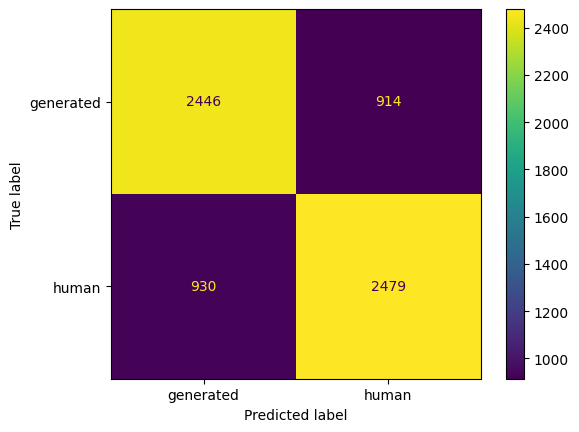

In [76]:
x_train, x_test, y_train, y_test = prep_dataset(df,'multi-qa-mpnet-base-dot-v1', tr=True)
models=setup_models()
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

#### Naïve Neural Network Classifier
MLPs show underwhelming results when paired with Bag of Words representation; nonetheless, we tried the same on a custom Word2Vec embedding, achieving results on par if not superior to traditional approaches (such as logistic regression).

Here we use the get_np_dataset() helper function, which takes care of loading the dataset into a numpy array; it also removes punctuation from documents and converts labels to an integer value.

In [77]:
X, Y = get_np_dataset(dataset_path)

X_train, X_val, X_test, Y_train, Y_val, Y_test =  split(X, Y, test_size=0.15, val_size=0.15, seed=seed)

print(">> Train: ", len(X_train), " samples.")
print(">> Validation: ", len(X_val), " samples.")
print(">> Test: ", len(X_test), " samples.")

>> Train:  23691  samples.
>> Validation:  5077  samples.
>> Test:  5077  samples.


In [78]:
# Train a custom Word2Vec of size 30
word_model = Word2Vec(X, vector_size=30, min_count=1, window=10)

In [79]:
# Adjust the format of sets for training, validation and testing
X_train_v = [sum(word_model.wv[doc]) for doc in X_train]
X_val_v = [sum(word_model.wv[doc]) for doc in X_val]
X_test_v = [sum(word_model.wv[doc]) for doc in X_test]

Y_train_v = tfk.utils.to_categorical(Y_train)
Y_val_v = tfk.utils.to_categorical(Y_val)

In [80]:
# Produce a traditional neural network, no fancy NLP stuff.
def get_very_naive_nn(input_shape, num_classes, af):
    input_layer = tfkl.Input(shape = input_shape, name = 'input_layer')
    x = tfkl.BatchNormalization()(input_layer)
    x = tfkl.Dense(units = 64, name = 'c1', activation = af)(x)
    x = tfkl.Dense(units = 32, name = 'c2', activation = af)(x)
    output_layer = tfkl.Dense(units = num_classes, activation = 'softmax', name = 'output_layer')(x)

    model = tfk.Model(inputs = input_layer, outputs = output_layer, name = 'model')
    model.compile(loss = tfk.losses.CategoricalCrossentropy(), optimizer = tfk.optimizers.Adam(), metrics = 'accuracy')

    return model

In [81]:
# Create the model 
naive_nn = get_very_naive_nn((30,), len(labels), "swish")
es_callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', 
                                               patience=10, 
                                               restore_best_weights=True)

callbacks = [].append(es_callback)

2023-05-28 10:12:46.203576: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-28 10:12:46.204414: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-05-28 10:12:46.204677: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-05-28 10:12:46.204927: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least on

In [82]:
history = naive_nn.fit(x = np.array(X_train_v), 
                       y = np.array(Y_train_v), 
                       validation_data=(np.array(X_val_v), np.array(Y_val_v)), 
                       batch_size = 32, 
                       callbacks = callbacks, 
                       epochs = 70,
                       verbose = False).history

2023-05-28 10:12:47.016534: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:630] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2023-05-28 10:12:47.089432: I tensorflow/compiler/xla/service/service.cc:173] XLA service 0x7f8174017110 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-05-28 10:12:47.089464: I tensorflow/compiler/xla/service/service.cc:181]   StreamExecutor device (0): NVIDIA GeForce RTX 4070, Compute Capability 8.9
2023-05-28 10:12:47.093560: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2023-05-28 10:12:47.156486: W tensorflow/compiler/xla/stream_executor/gpu/asm_compiler.cc:234] Falling back to the CUDA driver for PTX compilation; ptxas does not support CC 8.9
2023-05-28 10:12:47.156507: W tensorflow/compiler/xla/stream_executor/gpu/asm_compiler.cc:237] Used ptxas 

              precision    recall  f1-score   support

           0       0.83      0.72      0.77      2520
           1       0.76      0.85      0.80      2557

    accuracy                           0.79      5077
   macro avg       0.79      0.79      0.79      5077
weighted avg       0.79      0.79      0.79      5077



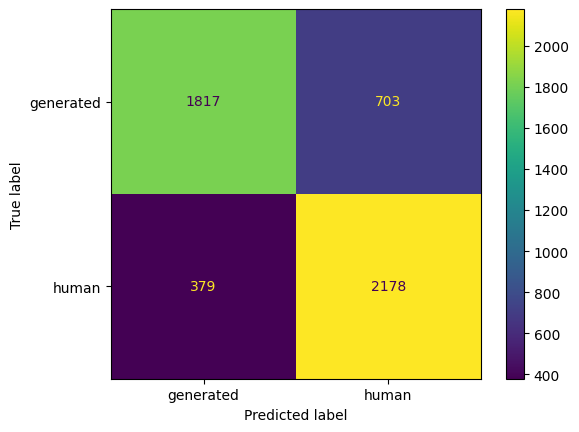

In [83]:
# Evaluate performance
predictions = np.argmax(naive_nn.predict(np.array(X_test_v), verbose=False), axis=1)
evaluate(Y_test, predictions, labels=labels)

#### "The more, the merrier?"
We tested few variants of the most common ensemble approaches (bagging, boosting), only to quickly discover that the performance boost is little to none.

### Transformer-based models

#### GPU initialization and seed

In [84]:
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
if device.type != 'cuda':
    raise SystemError('GPU device not found')

#### Dataset initialization
Here we import and initialize the dataset for the transformer models. We will leave the `DataFrame` almost untouched, since the transformer huggingface models handle preprocessing. The main change we will do is to substitute the labels from strings to integers that match the corresponding category.

In [85]:
transformer_df = pd.read_csv(dataset_path, sep="\t")
transformer_df = transformer_df.drop("id", axis=1)
transformer_df['label'] = transformer_df['label'].replace({'human':0, 'generated':1})

train, val, test = compact_split(transformer_df, test_size=0.1, val_size=0.1, seed=seed)

labels = ['human', 'generated']
max_length = 135
batch_size = 32

data = DatasetDict()
data['train'] = Dataset.from_pandas(train)
data['validation'] = Dataset.from_pandas(val)
data['test'] = Dataset.from_pandas(test)

metric = hf_ev.load("accuracy")

#### Training arguments
Here we initialize all the arguments that will be used for the training (fine-tuning) phase.

In [86]:
training_args = TrainingArguments(
    output_dir='',
    per_device_train_batch_size=batch_size,
    per_device_eval_batch_size=batch_size,
    learning_rate=5e-5,
    weight_decay=0,
    num_train_epochs=2,
    logging_steps=100,
    evaluation_strategy="steps",
    save_strategy="steps",
    save_total_limit=2,
    save_steps=100,
    load_best_model_at_end=True,
)

#### Training various transformer models
In the next cells four different transformer models will be fine-tuned for the task, showing their performance.

We found `cased` models to perform slighlty better than `uncased` models. This is porbably beacuse AI text-generators tend to be more strict with capital letters while human tend to forget them, so this difference probably helps the model make better predictions.

Also `multilingual` models perfomed better than their non-multilingual counterpart.

Note: different models can have some different hyperparmeters which were chosen after extensive testing.

In the end, after a lot of testing, we chose four different models that performed good enough but were different from one another to show how diffirent models perform on the task. We settled for:

- `bert-base-multilingual-uncased` → popular uncased BERT model, our baseline
- `bert-base-multilingual-cased` → cased version of the previous model
- `distilbert-base-multilingual-cased` → lighter and faster compared to BERT
- `xlm-roberta-base` → RoBERTa model, the heaviest among the four

These same models were used also for task 2.

Some weights of the model checkpoint at bert-base-multilingual-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model 

Map:   0%|          | 0/27076 [00:00<?, ? examples/s]

Map:   0%|          | 0/3384 [00:00<?, ? examples/s]

Map:   0%|          | 0/3385 [00:00<?, ? examples/s]

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/transformers/optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss,Validation Loss,Accuracy
100,0.472100,0.371124,0.838948
200,0.377400,0.349224,0.864657
300,0.357100,0.312287,0.871454
400,0.291500,0.276816,0.882979
500,0.291700,0.304933,0.878546
600,0.265000,0.281335,0.887116
700,0.267900,0.285954,0.884161
800,0.248400,0.462273,0.821217
900,0.190100,0.316253,0.891844
1000,0.125800,0.305912,0.894504


bert-base-multilingual-uncased
              precision    recall  f1-score   support

           0       0.88      0.91      0.90      1749
           1       0.90      0.87      0.89      1636

    accuracy                           0.89      3385
   macro avg       0.89      0.89      0.89      3385
weighted avg       0.89      0.89      0.89      3385



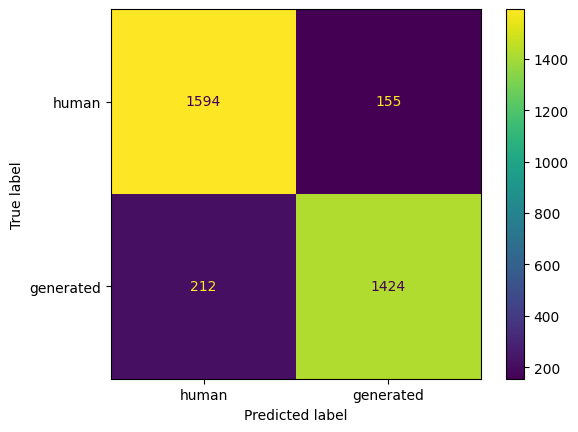

In [87]:
model_name = 'bert-base-multilingual-uncased'

training_args.output_dir = f'models/{model_name}'

transformer, tokenizer = import_transformer(model_name, labels, device)
tokenized_data = data.map(tokenize_function, batched=True)

trainer = Trainer(
    model=transformer, 
    args=training_args, 
    train_dataset=tokenized_data['train'], 
    eval_dataset=tokenized_data['validation'],
    compute_metrics=compute_metrics
)

trainer.train()
report(trainer, tokenized_data['test'], labels, model_name)

clean_gpu_memory(transformer, tokenizer)

Some weights of the model checkpoint at bert-base-multilingual-cased were not used when initializing BertForSequenceClassification: ['cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model ch

Map:   0%|          | 0/27076 [00:00<?, ? examples/s]

Map:   0%|          | 0/3384 [00:00<?, ? examples/s]

Map:   0%|          | 0/3385 [00:00<?, ? examples/s]

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/transformers/optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss,Validation Loss,Accuracy
100,0.505500,0.358429,0.846927
200,0.364800,0.428794,0.818853
300,0.351500,0.319890,0.858156
400,0.289000,0.315750,0.864362
500,0.293400,0.248889,0.896277
600,0.267900,0.275989,0.884161
700,0.264300,0.292810,0.883274
800,0.237900,0.439222,0.825650
900,0.202200,0.264716,0.901300
1000,0.134200,0.398508,0.882683


bert-base-multilingual-cased
              precision    recall  f1-score   support

           0       0.96      0.89      0.92      1749
           1       0.89      0.96      0.92      1636

    accuracy                           0.92      3385
   macro avg       0.93      0.92      0.92      3385
weighted avg       0.93      0.92      0.92      3385



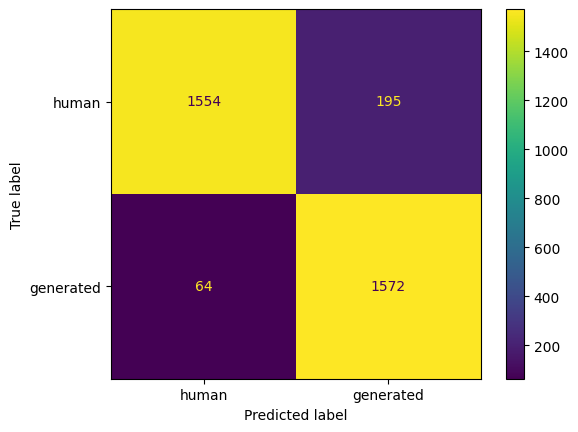

In [88]:
model_name = 'bert-base-multilingual-cased'

training_args.output_dir = f'models/{model_name}'
training_args.weight_decay = 0.3

transformer, tokenizer = import_transformer(model_name, labels, device)
tokenized_data = data.map(tokenize_function, batched=True)

trainer = Trainer(
    model=transformer, 
    args=training_args, 
    train_dataset=tokenized_data['train'], 
    eval_dataset=tokenized_data['validation'],
    compute_metrics=compute_metrics
)

trainer.train()
report(trainer, tokenized_data['test'], labels, model_name)

clean_gpu_memory(transformer, tokenizer)

Some weights of the model checkpoint at distilbert-base-multilingual-cased were not used when initializing DistilBertForSequenceClassification: ['vocab_projector.weight', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_transform.bias', 'vocab_projector.bias', 'vocab_transform.weight']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-multilingual-cased and are newly initialized: ['pre_classifier.weight', 'classif

Map:   0%|          | 0/27076 [00:00<?, ? examples/s]

Map:   0%|          | 0/3384 [00:00<?, ? examples/s]

Map:   0%|          | 0/3385 [00:00<?, ? examples/s]

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/transformers/optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss,Validation Loss,Accuracy
100,0.486000,0.380258,0.820331
200,0.383900,0.416125,0.813239
300,0.341900,0.303841,0.864657
400,0.285300,0.267386,0.885934
500,0.295400,0.260597,0.892435
600,0.265400,0.264607,0.887411
700,0.257700,0.301500,0.876773
800,0.239900,0.295298,0.871749
900,0.178000,0.353162,0.875000
1000,0.120900,0.294327,0.903960


distilbert-base-multilingual-cased
              precision    recall  f1-score   support

           0       0.96      0.90      0.93      1749
           1       0.90      0.96      0.93      1636

    accuracy                           0.93      3385
   macro avg       0.93      0.93      0.93      3385
weighted avg       0.93      0.93      0.93      3385



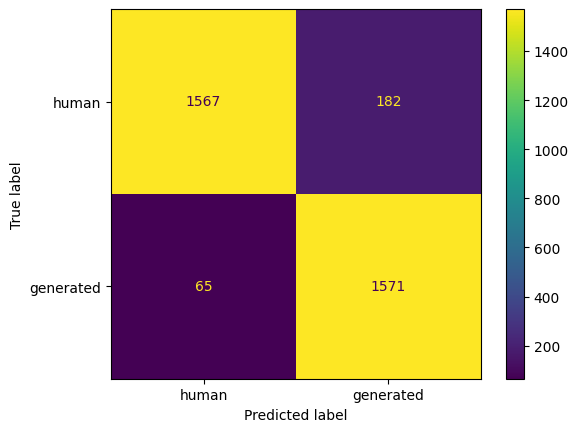

In [89]:
model_name = 'distilbert-base-multilingual-cased'

training_args.output_dir = f'models/{model_name}'
training_args.weight_decay = 0.2

transformer, tokenizer = import_transformer(model_name, labels, device)
tokenized_data = data.map(tokenize_function, batched=True)

trainer = Trainer(
    model=transformer, 
    args=training_args, 
    train_dataset=tokenized_data['train'], 
    eval_dataset=tokenized_data['validation'],
    compute_metrics=compute_metrics
)

trainer.train()
report(trainer, tokenized_data['test'], labels, model_name)

clean_gpu_memory(transformer, tokenizer)

Some weights of the model checkpoint at xlm-roberta-base were not used when initializing XLMRobertaForSequenceClassification: ['roberta.pooler.dense.weight', 'lm_head.dense.weight', 'lm_head.decoder.weight', 'lm_head.layer_norm.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.bias', 'lm_head.bias', 'roberta.pooler.dense.bias']
- This IS expected if you are initializing XLMRobertaForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing XLMRobertaForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of XLMRobertaForSequenceClassification were not initialized from the model checkpoint at xlm-roberta-base and are newly initialized: ['classifier.out_p

Map:   0%|          | 0/27076 [00:00<?, ? examples/s]

Map:   0%|          | 0/3384 [00:00<?, ? examples/s]

Map:   0%|          | 0/3385 [00:00<?, ? examples/s]

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/transformers/optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss,Validation Loss,Accuracy
100,0.539000,0.452060,0.826537
200,0.384900,0.347371,0.868203
300,0.323700,0.395568,0.844267
400,0.250200,0.332454,0.869976
500,0.274800,0.325511,0.854314
600,0.237000,0.310116,0.874409
700,0.234200,0.288848,0.886229
800,0.211300,0.486557,0.806738
900,0.161600,0.384547,0.881206
1000,0.142200,0.276939,0.920213


xlm-roberta-base
              precision    recall  f1-score   support

           0       0.97      0.88      0.92      1749
           1       0.88      0.97      0.93      1636

    accuracy                           0.92      3385
   macro avg       0.93      0.93      0.92      3385
weighted avg       0.93      0.92      0.92      3385



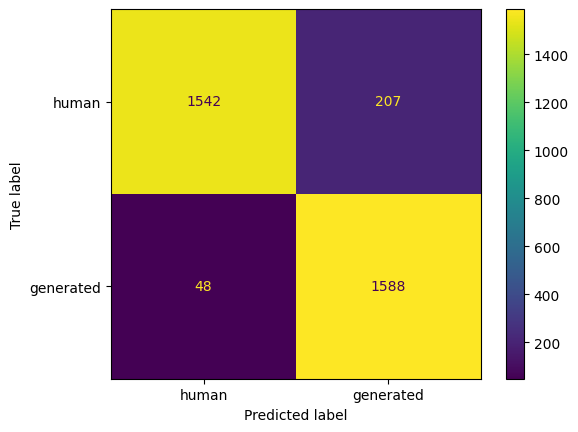

In [90]:
model_name = 'xlm-roberta-base'

training_args.output_dir = f'models/{model_name}'

transformer, tokenizer = import_transformer(model_name, labels, device)
tokenized_data = data.map(tokenize_function, batched=True)

trainer = Trainer(
    model=transformer, 
    args=training_args, 
    train_dataset=tokenized_data['train'], 
    eval_dataset=tokenized_data['validation'],
    compute_metrics=compute_metrics
)

trainer.train()
report(trainer, tokenized_data['test'], labels, model_name)

clean_gpu_memory(transformer, tokenizer)

## Task 2

The challenge is subdivided in two main tasks, the second task is a **Multinomial Classification** task that aims at identifying the specific *language model* that generated a given text passage, choosing from 6 different models labeled as A, B, C, D, E and F.

In [21]:
dataset_path = "../../AUTEXTIFICATION/subtask2-en/train.tsv"
labels = ["A", "B", "C", "D", "E", "F"]

### Data Exploration

#### Indexing

In [92]:
df = pd.read_csv(dataset_path, sep="\t", header=0)
pd.set_option('display.max_colwidth', 150)

df.head()

,id,text,label
0,6239,It was not until many years later that it could be controlled with pesticides. Many pest species have become invasive because they are unpalatable...,A
1,9255,"Users can then pin these images to their profile, creating a public or private board which can be shared with other users. They can also like othe...",F
2,1674,"The best songs are those that I can sing along with, and they’re all there!",B
3,5001,"I found this book to be poorly written. It was written in a very unprofessional manner. The writing is not very well done, it is very poorly writt...",D
4,20779,Regulates the application of the EU tariff quotas for the imports of sugar originating from third countries and the sugar originating from third c...,E


Let's check the dataset size.

In [94]:
print(f"No. of sentences: {len(df)}")

No. of sentences: 22416


Let's print some sentences and try to understand the dataset.

In [95]:
for i in range(20):
    print(df['text'][i])
    print("\n")

It was not until many years later that it could be controlled with pesticides. Many pest species have become invasive because they are unpalatable to humans or animals, often causing damage from their toxic substances (which can also harm plants). Examples include the Asian elephant’s hairy snake droppings, which poisoned European ivory owls for hundreds of years, and more recently rabid dogs killing wild cats by biting them off at night. The spread of invasive species is affected both by natural


Users can then pin these images to their profile, creating a public or private board which can be shared with other users. They can also like other users pins, creating an online community of users who can share and comment on each others content. The site also allows users to follow other users, creating an online network of people who are interested in the same things. This can help users to discover new content and ideas, as well as staying upto


The best songs are those that I can sing 

Before running queries with a search engine, we must first index the documents.

In the following cell, we index all of the dataframe's documents. 

In [96]:
# Start pyterrier
if not pt.started():
    pt.init(logging="ERROR")
    

df["docno"]=[str(i) for i in df["id"]]
pd_indexer = pt.DFIndexer("./subtask2",overwrite=True,verbose=True)
indexref = pd_indexer.index(df["text"], df["docno"])

index = pt.IndexFactory.of(indexref)

PyTerrier 0.9.2 has loaded Terrier 5.7 (built by craigm on 2022-11-10 18:30) and terrier-helper 0.0.7

No etc/terrier.properties, using terrier.default.properties for bootstrap configuration.
  0%|                                   | 0/22416 [00:00<?, ?documents/s]/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/pyterrier/index.py:628: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for column, value in meta_column[1].iteritems():
100%|█████████████████████| 22416/22416 [00:09<00:00, 2470.00documents/s]


Let's visualize some statistics about our data.

In [97]:
print(index.getCollectionStatistics().toString())

Number of documents: 22416
Number of terms: 28310
Number of postings: 530957
Number of fields: 0
Number of tokens: 642775
Field names: []
Positions:   false



Now we will try asking some queries.

In [98]:
query = "universities"

bm25 = pt.BatchRetrieve(index, wmodel="BM25")
queries_bm=bm25.search(query)
br = pt.BatchRetrieve(index, wmodel="TF_IDF")
queries_br=br.search(query)
print("Ranking using bm25 \n Top 5 \n")
print(queries_bm.head())
for i in range(5):
    print(df[df.docno==queries_bm.docno[i]]["text"])

print("Ranking using br \n Top 5 \n")
print(queries_br.head())
for i in range(5):
    print(df[df.docno==queries_br.docno[i]]["text"])

Ranking using bm25 
 Top 5 

  qid  docid  docno  rank      score         query
0   1   7395  11049     0  12.397891  universities
1   1  18904   8911     1  11.544523  universities
2   1  17197   3748     2  10.836804  universities
3   1  20321  12466     3  10.734443  universities
4   1  10819  10687     4  10.616844  universities
7395    In the 2007 and 2008 tables, the University of St Andrews had the highest overall ranking, although in the latter year the course modulebased rank...
Name: text, dtype: object
18904    She was appointed vicechancellor of the University of Bath in 2001 and has since become one of the longestserving vicechancellors in the UK. She h...
Name: text, dtype: object
17197    Hidden No More is an exploration of the science and history of the universe and its hidden secrets. The book is written by astrophysicist and auth...
Name: text, dtype: object
20321    Learn more in this article. The website is a joint project by Oxford University Press and Open Univers

#### Clustering

In [99]:
vectorizer = TfidfVectorizer(max_df=0.8, min_df=5, stop_words='english')
documents=np.array(df['text'])
labels_clus = np.array(df['label'])

We have obtained a relatively small vocabulary composed by ~11k words.

In [100]:
vectorizer.fit(documents)
vocab = vectorizer.get_feature_names_out()
print(f"Length of vocabulary: {len(vocab)}")

vector_documents = vectorizer.transform(documents)

Length of vocabulary: 10210


By analyzing the cluster similarity, we can see if our data tends to aggregate in specific classes.

In [101]:
for i in range(1,200):
    if (labels_clus[i] == labels_clus[1]):
        print('Similarity:', vector_documents[1].multiply(vector_documents[i]).sum())

Similarity: 1.0000000000000002
Similarity: 0.0
Similarity: 0.0
Similarity: 0.012156606185854915
Similarity: 0.021497454396714348
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.008450299243712817
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.016834592193377015
Similarity: 0.0
Similarity: 0.0035152820429519157
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.10561271796235439
Similarity: 0.005680273800866435
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.004780727160835253
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.04324886923082573
Similarity: 0.010809344661050681
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.010659129443019904
Similarity: 0.016782537955139464
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.0
Similarity: 0.015559273374705349
Similarity: 0.0
Similarity: 0.03265266747675147


We will use KMeans, a basic clustering algorithm.

In [102]:
k = len(set(labels_clus))
kmeans = KMeans(n_clusters=k, max_iter=100, n_init=2, verbose=True, random_state=2307)
kmeans.fit(vector_documents)

Initialization complete
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
Iteration 0, inertia 42639.25553567566.
Iteration 1, inertia 21979.148393302625.
Iteration 2, inertia 21895.168800395768.
Iteration 3, inertia 21876.8751993388.
Iteration 4, inertia 21865.144204361834.
Iteration 5, inertia 21855.863914422775.
Iteration 6, inertia 21848.46963645247.
Iteration 7, inertia 21842.60136000911.
Iteration 8, inertia 21838.05701527074.
Iteration 9, inertia 21835.001044287983.
Iteration 10, inertia 21831.785322665142.
Iteration 11, inertia 21828.4754757469.
Iteration 12, inertia 21826.68857127997.
Iteration 13, inertia 21825.31859982673.
Iteration 14, inertia 21824.03829853138.
Iteration 15, inertia 21822.991614941686.
I

KMeans(max_iter=100, n_clusters=6, n_init=2, random_state=2307, verbose=True)

In [104]:
print("Intrinsic evaluation measures:")
print("Within-cluster sum-of-squares:", str(kmeans.inertia_))
print("Silhouette coefficient:", str(metrics.silhouette_score(vector_documents, kmeans.labels_)))
print('Extrinsic evaluation measures:')
print("Homogeneity:", str(metrics.homogeneity_score(labels_clus, kmeans.labels_)))
print("Completeness:", str(metrics.completeness_score(labels_clus, kmeans.labels_)))
print("V-measure:", str(metrics.v_measure_score(labels_clus, kmeans.labels_)))
print("Adjusted Rand-Index:", str(metrics.adjusted_rand_score(labels_clus, kmeans.labels_)))


Intrinsic evaluation measures:
Within-cluster sum-of-squares: 21814.764012768763
Silhouette coefficient: 0.00651594411852177
Extrinsic evaluation measures:
Homogeneity: 0.006927799657254587
Completeness: 0.008732353323036873
V-measure: 0.007726105158039763
Adjusted Rand-Index: 0.001904556529861485


As we expected, the results obtained are not good.

We can say quite confidently that the content of the sentences is not directly related to the label.

### Bag of Words-based models and other approaches

#### Only Bag of Words text vectorization

We load the english dataset for the second task.

In [105]:
# Import main dataset
df = pd.read_csv(dataset_path, sep="\t")
df = df.drop("id", axis=1)

df

,text,label
0,It was not until many years later that it could be controlled with pesticides. Many pest species have become invasive because they are unpalatable...,A
1,"Users can then pin these images to their profile, creating a public or private board which can be shared with other users. They can also like othe...",F
2,"The best songs are those that I can sing along with, and they’re all there!",B
3,"I found this book to be poorly written. It was written in a very unprofessional manner. The writing is not very well done, it is very poorly writt...",D
4,Regulates the application of the EU tariff quotas for the imports of sugar originating from third countries and the sugar originating from third c...,E
...,...,...
22411,The ministry had earlier said it was working with the government on a security plan for the defence projects. The Ministry of External Affairs (ME...,B
22412,"Once combined, slowly add the melted butter, stirring constantly. Then, add the heavy cream, stirring until the mixture is smooth. For a lighter t...",F
22413,"Hightower for this new and wellwritten book!. I wanted to write a positive review on your latest publication, SB Diet because I am truly impressed...",B
22414,All throughout the whole book this author has maintained a beautiful level of detail. The language is nicely done and the narration is simple and ...,D


We use the same preprocessing function that we used for Task 1, we use it to preprocess our data, splitting it into train and test sets.

All of the previous considerations still apply.

In [107]:
def preprocess(data, lower=True, vectorizer=None, fit=True):
    # Convert all text to lowercase
    if lower:
        data = [x.lower() for x in data]

    # Remove punctuation and reset multiple spaces to one
    punct_regex = re.compile("[" + string.punctuation + "\’'" + "]")
    whitespace_regex = re.compile(" ( )+")
    data = [whitespace_regex.sub(" ", punct_regex.sub(" ", x)) for x in data]
    
    # Vectorize
    if vectorizer:
        if fit:
            data = vectorizer.fit_transform(data)
        else:
            data = vectorizer.transform(data)
    
    return data

In [108]:
vectorizer = TfidfVectorizer(min_df=4, max_df=0.6, ngram_range=(2,2))

x, y = df["text"], df["label"]
x_train, x_val, x_test, y_train, y_val, y_test = split(
    x, y, test_size=0.2, val_size=0.0, seed=seed
)

x_train = preprocess(x_train, vectorizer=vectorizer)
x_test = preprocess(x_test, vectorizer=vectorizer, fit=False)

We define some simple models to try out the simple Bag of Words approach, without any additional data; the models that we are going to use are:
- Multinomial Naive Bayes
- Logistic Regression
- C-Support SVM
- Extra Tree classifier

All of the previous models are run using 5-fold cross-validation on a small gridsearch around some of their default parameters.

In [109]:
models = []

# Naive Bayes
nb = MultinomialNB()
nb_param = {"alpha":[0.001, 0.01, 0.1, 1, 10, 100]}
nb_clf = GridSearchCV(nb, nb_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Naive Bayes",
    "model": nb_clf,
})

# Logistic Regression
lr = LogisticRegression(max_iter=1000)
lr_param = [{
    "solver": ["liblinear"], 
    "penalty": ["l1", "l2"],
    "C":[0.01, 0.1, 1, 10]
},{
    "solver": ("lbfgs", "sag", "saga"), 
    "penalty": ["l2"],
    "C":[0.01, 0.1, 1]
}]
lr_clf = GridSearchCV(lr, lr_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Linear Regression",
    "model": lr_clf,
    "subsample": 0.9,
})

# SVC
svc = SVC()
svc_param = {"kernel": ["rbf"], "C": [0.1, 1, 10]}
svc_clf = GridSearchCV(svc, svc_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "SVC",
    "model": svc_clf,
    "subsample": 0.6,
})

# Extra Trees
et = ExtraTreesClassifier()
et_param = {
    "criterion": ["gini", "entropy"],
}
et_clf =  GridSearchCV(et, et_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Extra Trees",
    "model": et_clf,
    "subsample": 0.6,
})

>> Training Naive Bayes
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits


/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
Naive Bayes
Best parameters: {'alpha': 1}
Best CV score: 0.3823891380707833
              precision    recall  f1-score   support

           A       0.47      0.42      0.44       712
           B       0.33      0.32      0.33       730
           C       0.31      0.27      0.29       737
           D       0.31      0.41      0.35       774
           E       0.32      0.33      0.32       765
           F       0.60      0.54      0.57       766

    accuracy                           0.38      4484
   macro avg       0.39      0.38      0.38      4484
weighted avg       0.39      0.38      0.38      4484



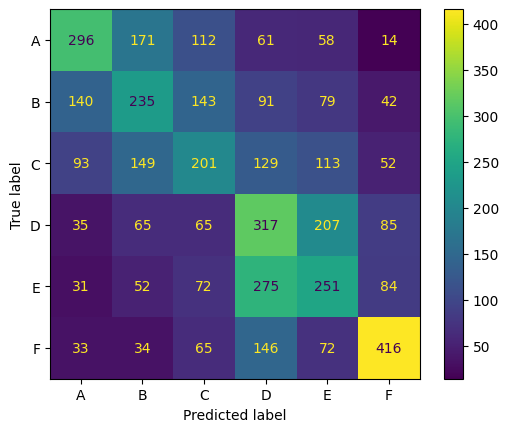

Linear Regression
Best parameters: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
Best CV score: 0.3262725447783259
              precision    recall  f1-score   support

           A       0.45      0.49      0.47       712
           B       0.34      0.32      0.33       730
           C       0.31      0.28      0.30       737
           D       0.35      0.35      0.35       774
           E       0.34      0.35      0.35       765
           F       0.59      0.61      0.60       766

    accuracy                           0.40      4484
   macro avg       0.40      0.40      0.40      4484
weighted avg       0.40      0.40      0.40      4484



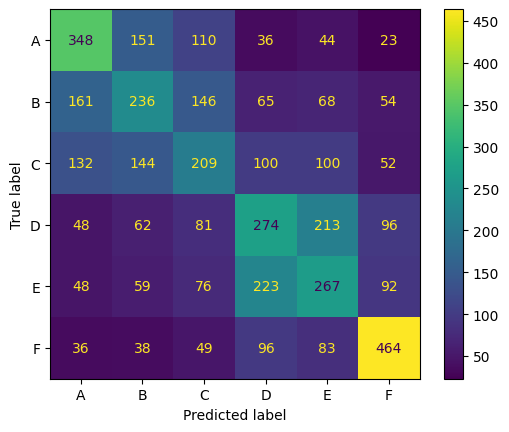

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.3618214686629831
              precision    recall  f1-score   support

           A       0.45      0.52      0.48       712
           B       0.35      0.34      0.34       730
           C       0.31      0.28      0.29       737
           D       0.35      0.37      0.36       774
           E       0.34      0.36      0.35       765
           F       0.64      0.58      0.61       766

    accuracy                           0.41      4484
   macro avg       0.41      0.41      0.41      4484
weighted avg       0.41      0.41      0.41      4484



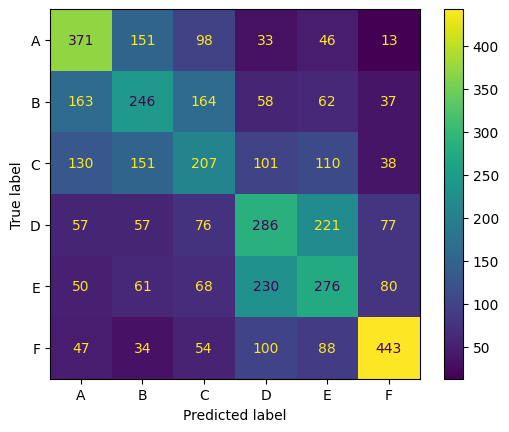

Extra Trees
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.3360275829895179
              precision    recall  f1-score   support

           A       0.39      0.54      0.45       712
           B       0.29      0.17      0.21       730
           C       0.28      0.16      0.20       737
           D       0.31      0.38      0.34       774
           E       0.30      0.31      0.30       765
           F       0.50      0.61      0.55       766

    accuracy                           0.36      4484
   macro avg       0.35      0.36      0.34      4484
weighted avg       0.35      0.36      0.34      4484



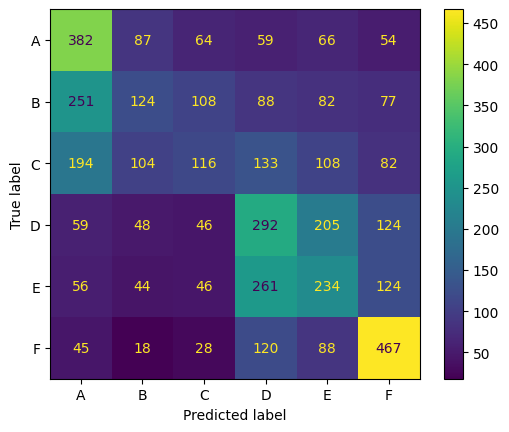

In [110]:
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

From the results we see a much worse performance with respect to Task 1, this is expected, as Task 2 is inherently more difficult due to the presence of more classes and the "more similar" nature of those classes.

Our simple Bag of Words classifiers still have an edge against a random classifier since all of them can abundantly surpass the 1/6 ≈ 17% baseline.

From the confusion matrix results we confirm the similarities between A, B, C and D, E, F respectively, in addition we can observe that F is much more easier to detect than the other classes.

#### Including additional information

We run the *en_core_web_sm* SpaCy pipeline and define the custom feature extraction function that were used in the previous points.

This time we skip directly to the application of augmentation features, without dwelling on the benefits of lemmatization.

The techniques applied through this section are the same as those applied for Task 1.

In [111]:
def extract_features(tree):
    features = []
    for token in tree:
        lemma = token.lemma_
        pos_tag = token.pos_
        dep_lab = token.dep_
        head = token.head
        if token.i < head.i:
            direction = "l"
        else:
            direction = "r"
        dfr = len(list(token.ancestors))
        # if not token.is_stop:
        features.append({
            "lem": lemma ,
            "pos": pos_tag, 
            "dep": dep_lab, 
            "head": head, 
            "dir": direction, 
            "dfr": dfr
        })
    return features

In [112]:
# Run SpaCy NLP pipeline on dataset
parsed_df = df.copy()
parsed_df["text"] = df["text"].apply(lambda x: nlp_model(x))

# Extract useful features
parsed_df["features"] = parsed_df["text"].apply(lambda x: extract_features(x))

parsed_df

,text,label,tagged_text,features
0,"(It, was, not, until, many, years, later, that, it, could, be, controlled, with, pesticides, ., Many, pest, species, have, become, invasive, becau...",A,"(It, was, not, until, many, years, later, that, it, could, be, controlled, with, pesticides, ., Many, pest, species, have, become, invasive, becau...","[{'lem': 'it', 'pos': 'PRON', 'dep': 'nsubj', 'head': was, 'dir': 'l', 'dfr': 1}, {'lem': 'be', 'pos': 'AUX', 'dep': 'ROOT', 'head': was, 'dir': '..."
1,"(Users, can, then, pin, these, images, to, their, profile, ,, creating, a, public, or, private, board, which, can, be, shared, with, other, users,...",F,"(Users, can, then, pin, these, images, to, their, profile, ,, creating, a, public, or, private, board, which, can, be, shared, with, other, users,...","[{'lem': 'user', 'pos': 'NOUN', 'dep': 'nsubj', 'head': pin, 'dir': 'l', 'dfr': 1}, {'lem': 'can', 'pos': 'AUX', 'dep': 'aux', 'head': pin, 'dir':..."
2,"(The, best, songs, are, those, that, I, can, sing, along, with, ,, and, they, ’re, all, there, !)",B,"(The, best, songs, are, those, that, I, can, sing, along, with, ,, and, they, ’re, all, there, !)","[{'lem': 'the', 'pos': 'DET', 'dep': 'det', 'head': songs, 'dir': 'l', 'dfr': 2}, {'lem': 'good', 'pos': 'ADJ', 'dep': 'amod', 'head': songs, 'dir..."
3,"(I, found, this, book, to, be, poorly, written, ., It, was, written, in, a, very, unprofessional, manner, ., The, writing, is, not, very, well, do...",D,"(I, found, this, book, to, be, poorly, written, ., It, was, written, in, a, very, unprofessional, manner, ., The, writing, is, not, very, well, do...","[{'lem': 'I', 'pos': 'PRON', 'dep': 'nsubj', 'head': found, 'dir': 'l', 'dfr': 1}, {'lem': 'find', 'pos': 'VERB', 'dep': 'ROOT', 'head': found, 'd..."
4,"(Regulates, the, application, of, the, EU, tariff, quotas, for, the, imports, of, sugar, originating, from, third, countries, and, the, sugar, ori...",E,"(Regulates, the, application, of, the, EU, tariff, quotas, for, the, imports, of, sugar, originating, from, third, countries, and, the, sugar, ori...","[{'lem': 'regulate', 'pos': 'VERB', 'dep': 'ROOT', 'head': Regulates, 'dir': 'r', 'dfr': 0}, {'lem': 'the', 'pos': 'DET', 'dep': 'det', 'head': ap..."
...,...,...,...,...
22411,"(The, ministry, had, earlier, said, it, was, working, with, the, government, on, a, security, plan, for, the, defence, projects, ., The, Ministry,...",B,"(The, ministry, had, earlier, said, it, was, working, with, the, government, on, a, security, plan, for, the, defence, projects, ., The, Ministry,...","[{'lem': 'the', 'pos': 'DET', 'dep': 'det', 'head': ministry, 'dir': 'l', 'dfr': 2}, {'lem': 'ministry', 'pos': 'NOUN', 'dep': 'nsubj', 'head': sa..."
22412,"(Once, combined, ,, slowly, add, the, melted, butter, ,, stirring, constantly, ., Then, ,, add, the, heavy, cream, ,, stirring, until, the, mixtur...",F,"(Once, combined, ,, slowly, add, the, melted, butter, ,, stirring, constantly, ., Then, ,, add, the, heavy, cream, ,, stirring, until, the, mixtur...","[{'lem': 'once', 'pos': 'ADV', 'dep': 'advmod', 'head': combined, 'dir': 'l', 'dfr': 2}, {'lem': 'combine', 'pos': 'VERB', 'dep': 'advcl', 'head':..."
22413,"(Hightower, for, this, new, and, wellwritten, book, !, ., I, wanted, to, write, a, positive, review, on, your, latest, publication, ,, SB, Diet, b...",B,"(Hightower, for, this, new, and, wellwritten, book, !, ., I, wanted, to, write, a, positive, review, on, your, latest, publication, ,, SB, Diet, b...","[{'lem': 'Hightower', 'pos': 'PROPN', 'dep': 'ROOT', 'head': Hightower, 'dir': 'r', 'dfr': 0}, {'lem': 'for', 'pos': 'ADP', 'dep': 'prep', 'head':..."
22414,"(All, throughout, the, whole, book, this, author, has, maintained, a, beautiful, level, of, detail, ., The, language, is, nicely, done, and, the, ...",D,"(All, throughout, the, whole, book, this, author, has, maintained, a, beautiful, level, of, detail, ., The, language, is, nicely, done, and, the, ...","[{'lem': 'all', 'pos': 'ADV', 'dep': 'advmod',

In [114]:
x_lem = parsed_df["features"].apply(lambda x: " ".join([t["lem"] for t in x]))
x_pos = parsed_df["features"].apply(lambda x: " ".join([t["pos"] for t in x]))
x_avgdfr = parsed_df["features"].apply(lambda x: sum(t["dfr"] for t in x) / len(x))
y = parsed_df["label"]

x_train_lem, x_val_lem, x_test_lem, y_train, y_val, y_test = split(
    x_lem, y, test_size=0.2, val_size=0.0, seed=seed
)
x_train_pos, x_val_pos, x_test_pos, y_train, y_val, y_test = split(
    x_pos, y, test_size=0.2, val_size=0.0, seed=seed
)
x_train_avgdfr, x_val_avgdfr, x_test_avgdfr, y_train, y_val, y_test = split(
    x_avgdfr, y, test_size=0.2, val_size=0.0, seed=seed
)

In [115]:
# Vectorize lemmas
vectorizer = TfidfVectorizer(min_df=4, ngram_range=(2,2))
x_train_lem = vectorizer.fit_transform(x_train_lem)
x_test_lem = vectorizer.transform(x_test_lem)

# Vectorize POS tags
vectorizer = TfidfVectorizer(min_df=4)
x_train_pos = vectorizer.fit_transform(x_train_pos)
x_test_pos = vectorizer.transform(x_test_pos)

# Normalize average distance from root
mms = MinMaxScaler()

x_train_avgdfr = mms.fit_transform(x_train_avgdfr.values.reshape(-1, 1))
x_test_avgdfr = mms.transform(x_test_avgdfr.values.reshape(-1, 1))

x_train_avgdfr = sps.csr_matrix(x_train_avgdfr)
x_test_avgdfr = sps.csr_matrix(x_test_avgdfr)

# Concatenate vectors
x_train = sps.hstack([x_train_lem, x_train_pos, x_train_avgdfr])
x_test = sps.hstack([x_test_lem, x_test_pos, x_test_avgdfr])

In [116]:
models = []

# Naive Bayes
nb = MultinomialNB()
nb_param = {"alpha":[0.001, 0.01, 0.1, 1, 10, 100]}
nb_clf = GridSearchCV(nb, nb_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Naive Bayes", 
    "model": nb_clf,
})

# Logistic Regression
lr = LogisticRegression(max_iter=100000)
lr_param = [{
    "solver": ["liblinear"], 
    "penalty": ["l1", "l2"],
    "C":[0.01, 0.1, 1, 10]
},{
    "solver": ("lbfgs", "sag", "saga"), 
    "penalty": ["l2"],
    "C":[0.01, 0.1, 1]
}]
lr_clf = GridSearchCV(lr, lr_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Linear Regression",
    "model": lr_clf,
    "subsample": 0.8,
})

# SVC
svc = SVC()
svc_param = {"kernel": ["rbf"], "C": [0.1, 1, 10]}
svc_clf = GridSearchCV(svc, svc_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "SVC", 
    "model": svc_clf,
    "subsample": 0.7,
})

# Decision Tree
dtree = DecisionTreeClassifier()
dtree_param = {
    "criterion": ["gini", "entropy"], 
    "max_features": [None, "sqrt", "log2"],
}
dtree_clf =  GridSearchCV(dtree, dtree_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Decision Tree",
    "model": dtree_clf,
})

# Random Forest
rf = RandomForestClassifier()
rf_param = {
    "criterion": ["gini", "entropy"], 
}
rf_clf =  GridSearchCV(rf, rf_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Random Forest",
    "model": rf_clf,
    "subsample": 0.6,
})

# Extra Trees
et = ExtraTreesClassifier()
et_param = {
    "criterion": ["gini", "entropy"], 
}
et_clf =  GridSearchCV(et, et_param, cv=5, scoring="f1_micro", verbose=1)
models.append({
    "name": "Extra Trees",
    "model": et_clf,
    "subsample": 0.6,
})

>> Training Naive Bayes
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Decision Tree
   Fitting 5 folds for each of 6 candidates, totalling 30 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
>> Training Extra Trees
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
Naive Bayes
Best parameters: {'alpha': 1}
Best CV score: 0.37106810846816074
              precision    recall  f1-score   support

           A       0.50      0.39      0.44       712
           B       0.31      0.

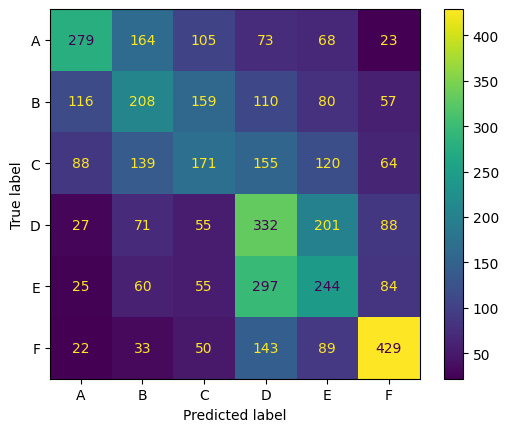

Linear Regression
Best parameters: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
Best CV score: 0.37199877235308054
              precision    recall  f1-score   support

           A       0.44      0.49      0.46       712
           B       0.33      0.31      0.32       730
           C       0.32      0.28      0.30       737
           D       0.35      0.38      0.37       774
           E       0.34      0.32      0.33       765
           F       0.59      0.60      0.59       766

    accuracy                           0.40      4484
   macro avg       0.39      0.40      0.40      4484
weighted avg       0.40      0.40      0.40      4484



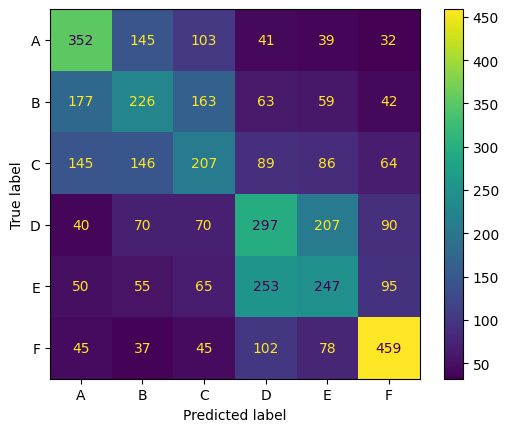

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.3894766145067865
              precision    recall  f1-score   support

           A       0.49      0.55      0.52       712
           B       0.33      0.34      0.34       730
           C       0.35      0.32      0.34       737
           D       0.38      0.40      0.39       774
           E       0.36      0.34      0.35       765
           F       0.61      0.61      0.61       766

    accuracy                           0.43      4484
   macro avg       0.42      0.43      0.42      4484
weighted avg       0.42      0.43      0.42      4484



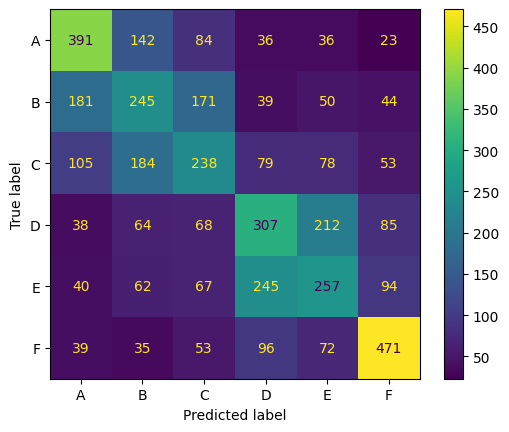

Decision Tree
Best parameters: {'criterion': 'gini', 'max_features': None}
Best CV score: 0.26979683249187475
              precision    recall  f1-score   support

           A       0.36      0.37      0.36       712
           B       0.23      0.23      0.23       730
           C       0.19      0.18      0.19       737
           D       0.25      0.26      0.26       774
           E       0.23      0.24      0.24       765
           F       0.37      0.37      0.37       766

    accuracy                           0.27      4484
   macro avg       0.27      0.27      0.27      4484
weighted avg       0.27      0.27      0.27      4484



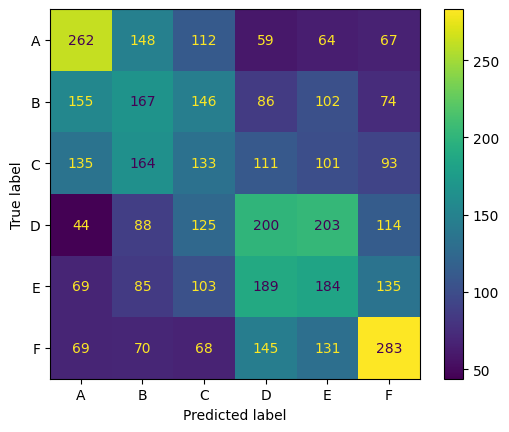

Random Forest
Best parameters: {'criterion': 'gini'}
Best CV score: 0.36935605674048366
              precision    recall  f1-score   support

           A       0.44      0.60      0.51       712
           B       0.34      0.23      0.28       730
           C       0.33      0.16      0.22       737
           D       0.34      0.43      0.38       774
           E       0.32      0.29      0.30       765
           F       0.49      0.65      0.56       766

    accuracy                           0.39      4484
   macro avg       0.38      0.39      0.37      4484
weighted avg       0.38      0.39      0.37      4484



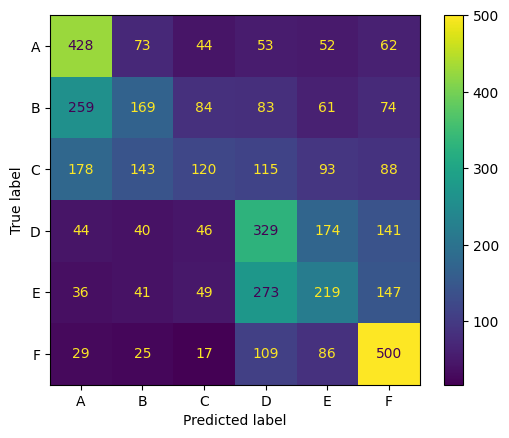

Extra Trees
Best parameters: {'criterion': 'gini'}
Best CV score: 0.3718603939177467
              precision    recall  f1-score   support

           A       0.43      0.58      0.49       712
           B       0.35      0.21      0.26       730
           C       0.35      0.16      0.22       737
           D       0.34      0.43      0.38       774
           E       0.32      0.34      0.33       765
           F       0.50      0.64      0.56       766

    accuracy                           0.39      4484
   macro avg       0.38      0.39      0.37      4484
weighted avg       0.38      0.39      0.37      4484



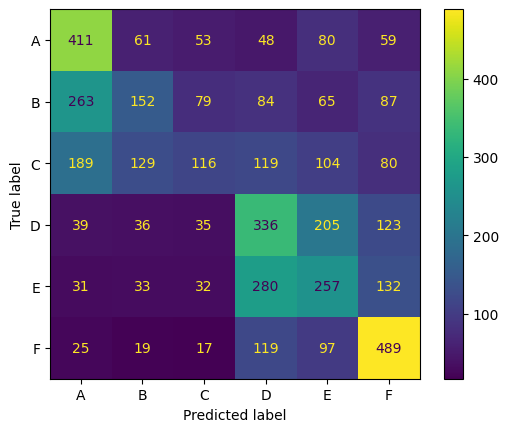

In [117]:
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

We can observe that for Task 2, the improvements of adding additional information are much less evident (although still present), even for complex models.

### Text embedding approaches

In [118]:
df = pd.read_csv(dataset_path, sep="\t", header=0)
pd.set_option('display.max_colwidth', 150)
labels = ["A","B","C","D","E","F"]
df = df.drop("id", axis=1)

df.head()

,text,label
0,It was not until many years later that it could be controlled with pesticides. Many pest species have become invasive because they are unpalatable...,A
1,"Users can then pin these images to their profile, creating a public or private board which can be shared with other users. They can also like othe...",F
2,"The best songs are those that I can sing along with, and they’re all there!",B
3,"I found this book to be poorly written. It was written in a very unprofessional manner. The writing is not very well done, it is very poorly writt...",D
4,Regulates the application of the EU tariff quotas for the imports of sugar originating from third countries and the sugar originating from third c...,E


In [120]:
df.sample(frac=1)
df['label'] = df['label'].replace({'A':0,'B':1,'C':2,'D':3,'E':4,'F':5})

In [121]:
docs = [re.sub('\n', ' ', doc) for doc in df.text]
sentences = [re.split('[?!.]\s', doc) for doc in docs]
sentences = list(flatten(sentences))
sentences[:3]

['It was not until many years later that it could be controlled with pesticides',
 'Many pest species have become invasive because they are unpalatable to humans or animals, often causing damage from their toxic substances (which can also harm plants)',
 'Examples include the Asian elephant’s hairy snake droppings, which poisoned European ivory owls for hundreds of years, and more recently rabid dogs killing wild cats by biting them off at night']

In [123]:
tokenized_sentences = [re.sub('\W', ' ', sentence).lower().split() for sentence in sentences]

To preprocess the dataset and select models we utilize the same helper functions defined for the symmetric step in Task 1.

#### Building our embedding

Dimension of embedding: 50
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 0.01, 'penalty': 'l2', 'solver': 'lbfgs'}
Best CV score: 0.3636384542232212
              precision    recall  f1-score   support

           0       0.47      0.57      0.52       712
           1       0.34      0.25      0.29       730
           2       0.30      0.23      0.26       737
           3       0.41      0.37      0.38       774
           4       0.32      0.24      0.27       765
           5       0.37      0.60      0.46       766

    accuracy                           0.38      4484
   macro avg       0.37      0.

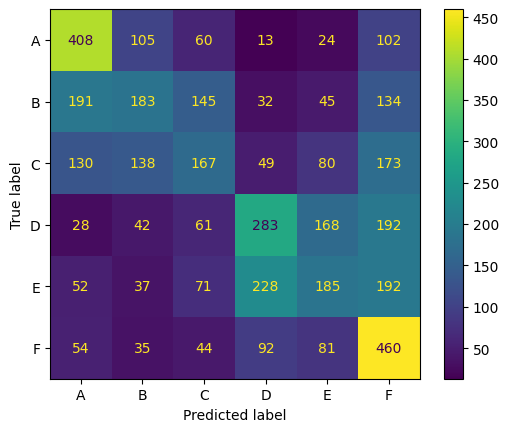

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.40267606120861077
              precision    recall  f1-score   support

           0       0.56      0.60      0.58       712
           1       0.35      0.30      0.32       730
           2       0.33      0.31      0.32       737
           3       0.42      0.37      0.40       774
           4       0.36      0.34      0.35       765
           5       0.52      0.67      0.59       766

    accuracy                           0.43      4484
   macro avg       0.42      0.43      0.43      4484
weighted avg       0.42      0.43      0.43      4484



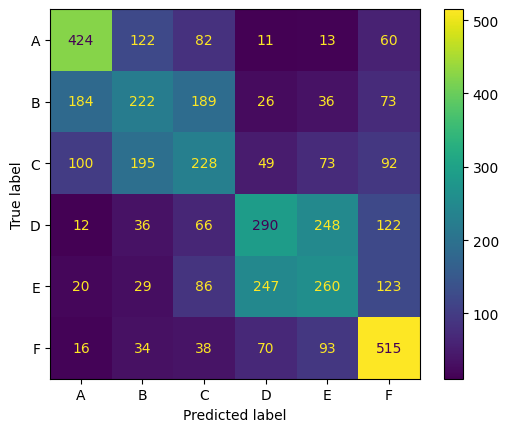

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.3524831979939644
              precision    recall  f1-score   support

           0       0.48      0.58      0.53       712
           1       0.29      0.27      0.28       730
           2       0.27      0.23      0.25       737
           3       0.41      0.38      0.39       774
           4       0.33      0.28      0.30       765
           5       0.46      0.58      0.52       766

    accuracy                           0.39      4484
   macro avg       0.37      0.39      0.38      4484
weighted avg       0.37      0.39      0.38      4484



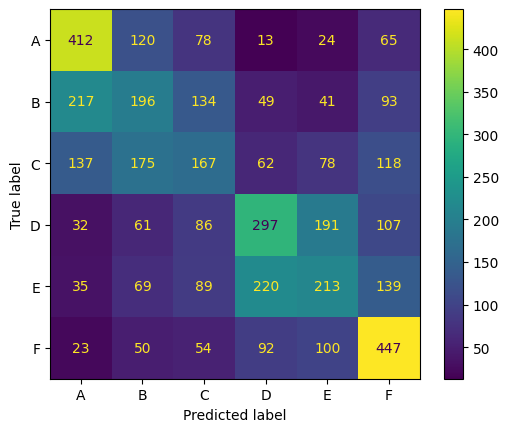

Dimension of embedding: 100
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits


/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html

   Found best model... 

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'}
Best CV score: 0.37367372698193135
              precision    recall  f1-score   support

           0       0.51      0.60      0.55       712
           1       0.38      0.28      0.33       730
           2       0.33      0.26      0.29       737
           3       0.40      0.37      0.38       774
           4       0.31      0.25      0.28       765
           5       0.41      0.64      0.50       766

    accuracy                           0.40      4484
   macro avg       0.39      0.40      0.39      4484
weighted avg       0.39      0.40      0.39      4484



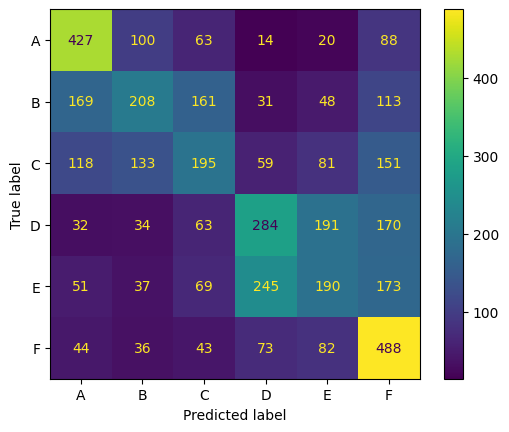

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.409553384628685
              precision    recall  f1-score   support

           0       0.58      0.61      0.59       712
           1       0.36      0.32      0.34       730
           2       0.36      0.35      0.35       737
           3       0.43      0.36      0.39       774
           4       0.37      0.36      0.36       765
           5       0.52      0.67      0.59       766

    accuracy                           0.44      4484
   macro avg       0.44      0.44      0.44      4484
weighted avg       0.44      0.44      0.44      4484



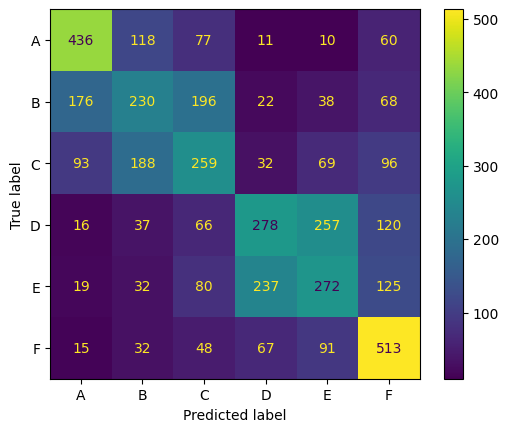

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.3753510319323157
              precision    recall  f1-score   support

           0       0.48      0.60      0.54       712
           1       0.29      0.26      0.27       730
           2       0.30      0.25      0.27       737
           3       0.42      0.36      0.39       774
           4       0.33      0.29      0.31       765
           5       0.46      0.60      0.52       766

    accuracy                           0.39      4484
   macro avg       0.38      0.39      0.38      4484
weighted avg       0.38      0.39      0.38      4484



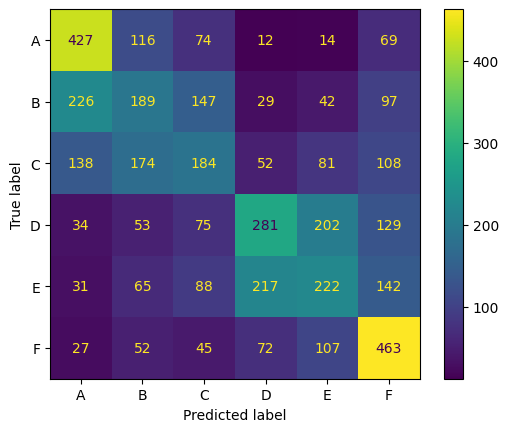

Dimension of embedding: 200
>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits


/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html

   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}
Best CV score: 0.39114843952623846
              precision    recall  f1-score   support

           0       0.52      0.64      0.57       712
           1       0.39      0.27      0.32       730
           2       0.34      0.23      0.27       737
           3       0.37      0.37      0.37       774
           4       0.29      0.23      0.26       765
           5       0.43      0.68      0.53       766

    accuracy                           0.40      4484
   macro avg       0.39      0.40      0.39      4484
weighted avg       0.39      0.40      0.38      4484



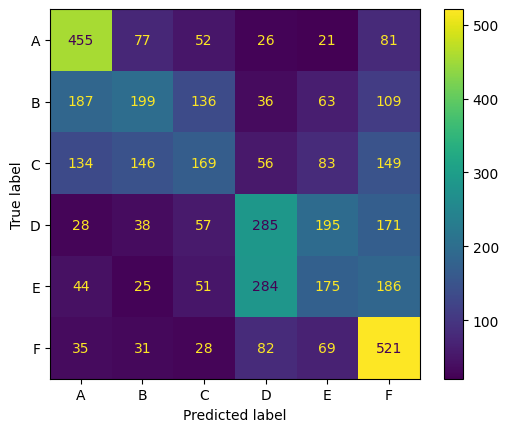

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.4028608973804789
              precision    recall  f1-score   support

           0       0.58      0.62      0.60       712
           1       0.37      0.33      0.35       730
           2       0.34      0.32      0.33       737
           3       0.42      0.36      0.39       774
           4       0.37      0.35      0.36       765
           5       0.52      0.67      0.59       766

    accuracy                           0.44      4484
   macro avg       0.43      0.44      0.44      4484
weighted avg       0.43      0.44      0.43      4484



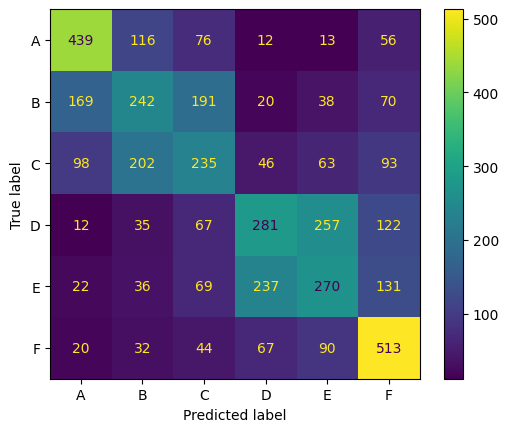

Random Forest
Best parameters: {'criterion': 'gini'}
Best CV score: 0.3796739220231414
              precision    recall  f1-score   support

           0       0.49      0.56      0.53       712
           1       0.31      0.29      0.30       730
           2       0.30      0.25      0.27       737
           3       0.41      0.38      0.39       774
           4       0.33      0.28      0.31       765
           5       0.49      0.61      0.54       766

    accuracy                           0.40      4484
   macro avg       0.39      0.40      0.39      4484
weighted avg       0.39      0.40      0.39      4484



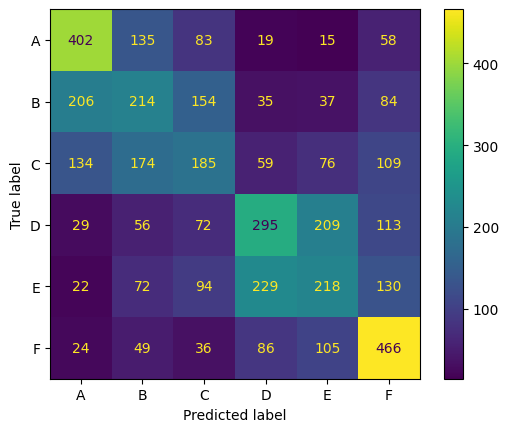

In [124]:
for i in [50,100,200]:
    print("Dimension of embedding: "+str(i))
    x_train, x_test, y_train, y_test = prep_dataset(df, tokenized_sentences, i)
    models=setup_models()
    train_cv_models(models, x_train, y_train)
    test_cv_models(models, x_test, y_test)

#### Embedding with pretrained models

>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 0.01, 'penalty': 'l2', 'solver': 'lbfgs'}
Best CV score: 0.3361225901270857
              precision    recall  f1-score   support

           0       0.44      0.49      0.47       712
           1       0.29      0.22      0.25       730
           2       0.28      0.22      0.24       737
           3       0.38      0.36      0.37       774
           4       0.31      0.28      0.30       765
           5       0.45      0.66      0.53       766

    accuracy                           0.37      4484
   macro avg       0.36      0.37      0.36      4484
weig

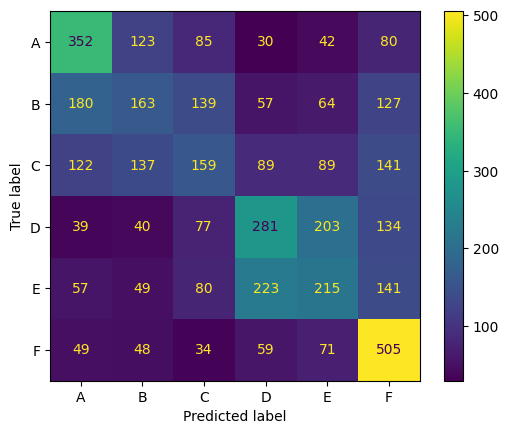

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.39338428287369237
              precision    recall  f1-score   support

           0       0.53      0.52      0.53       712
           1       0.34      0.32      0.33       730
           2       0.33      0.33      0.33       737
           3       0.42      0.40      0.41       774
           4       0.40      0.36      0.38       765
           5       0.56      0.66      0.61       766

    accuracy                           0.43      4484
   macro avg       0.43      0.43      0.43      4484
weighted avg       0.43      0.43      0.43      4484



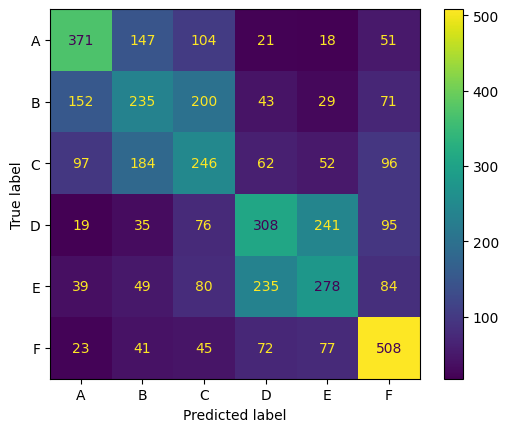

Random Forest
Best parameters: {'criterion': 'gini'}
Best CV score: 0.33617035751947477
              precision    recall  f1-score   support

           0       0.39      0.42      0.41       712
           1       0.25      0.22      0.23       730
           2       0.27      0.19      0.22       737
           3       0.32      0.34      0.33       774
           4       0.31      0.28      0.29       765
           5       0.44      0.60      0.51       766

    accuracy                           0.34      4484
   macro avg       0.33      0.34      0.33      4484
weighted avg       0.33      0.34      0.33      4484



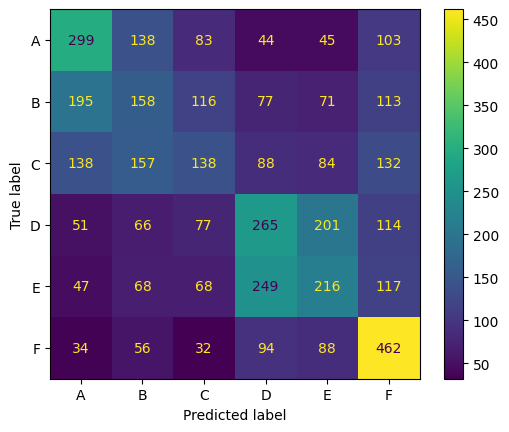

In [125]:
x_train, x_test, y_train, y_test = prep_dataset(df, "word2vec-google-news-300", 300)
models=setup_models()
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

#### Embedding with transformers

>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 10, 'penalty': 'l1', 'solver': 'liblinear'}
Best CV score: 0.2667789400881819
              precision    recall  f1-score   support

           0       0.31      0.37      0.34       712
           1       0.21      0.16      0.18       730
           2       0.22      0.18      0.20       737
           3       0.30      0.31      0.30       774
           4       0.23      0.21      0.22       765
           5       0.41      0.53      0.46       766

    accuracy                           0.29      4484
   macro avg       0.28      0.29      0.28      4484
we

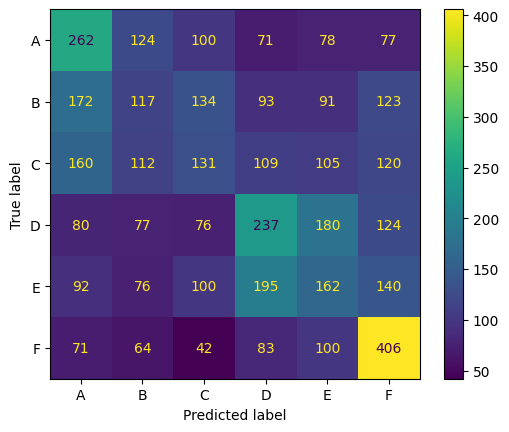

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.25934088354802454
              precision    recall  f1-score   support

           0       0.29      0.31      0.30       712
           1       0.23      0.24      0.23       730
           2       0.22      0.20      0.21       737
           3       0.30      0.31      0.31       774
           4       0.26      0.24      0.25       765
           5       0.51      0.50      0.50       766

    accuracy                           0.30      4484
   macro avg       0.30      0.30      0.30      4484
weighted avg       0.30      0.30      0.30      4484



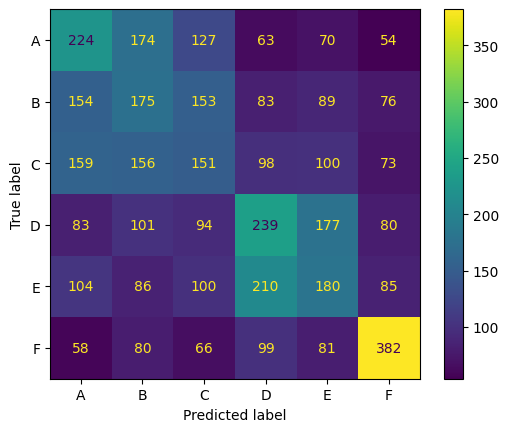

Random Forest
Best parameters: {'criterion': 'entropy'}
Best CV score: 0.20621608618955287
              precision    recall  f1-score   support

           0       0.18      0.17      0.18       712
           1       0.18      0.19      0.18       730
           2       0.17      0.15      0.16       737
           3       0.21      0.24      0.23       774
           4       0.19      0.18      0.19       765
           5       0.30      0.29      0.29       766

    accuracy                           0.21      4484
   macro avg       0.20      0.20      0.20      4484
weighted avg       0.20      0.21      0.20      4484



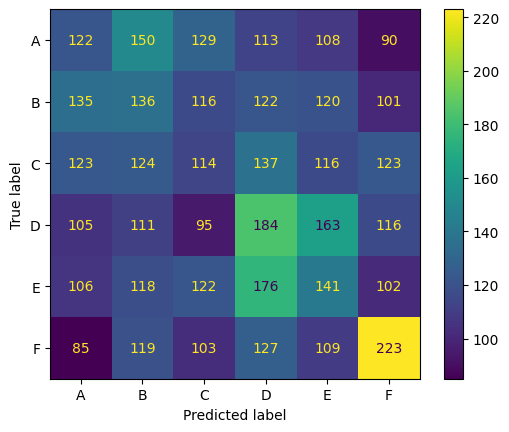

In [126]:
x_train, x_test, y_train, y_test = prep_dataset(df, 'all-mpnet-base-v2', tr=True)
models = setup_models()
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

>> Training Linear Regression
   Fitting 5 folds for each of 17 candidates, totalling 85 fits
   Found best model... Trained best model.
>> Training SVC
   Fitting 5 folds for each of 3 candidates, totalling 15 fits
   Found best model... Trained best model.
>> Training Random Forest
   Fitting 5 folds for each of 2 candidates, totalling 10 fits
   Found best model... Trained best model.
Linear Regression
Best parameters: {'C': 1, 'penalty': 'l2', 'solver': 'liblinear'}
Best CV score: 0.29169188207832625
              precision    recall  f1-score   support

           0       0.36      0.40      0.38       712
           1       0.21      0.16      0.18       730
           2       0.21      0.17      0.19       737
           3       0.35      0.36      0.36       774
           4       0.29      0.26      0.27       765
           5       0.44      0.61      0.51       766

    accuracy                           0.33      4484
   macro avg       0.31      0.33      0.32      4484
we

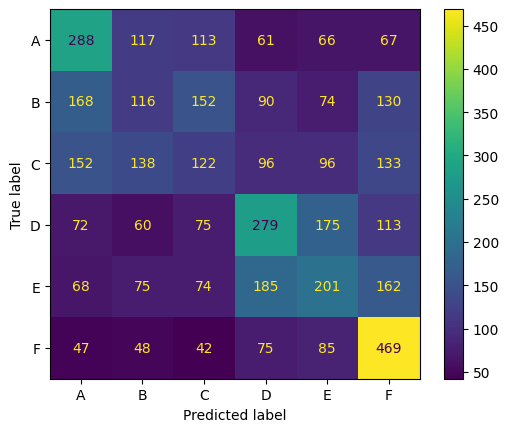

SVC
Best parameters: {'C': 10, 'kernel': 'rbf'}
Best CV score: 0.2768152502809717
              precision    recall  f1-score   support

           0       0.37      0.37      0.37       712
           1       0.25      0.25      0.25       730
           2       0.24      0.24      0.24       737
           3       0.33      0.32      0.32       774
           4       0.28      0.27      0.28       765
           5       0.53      0.56      0.55       766

    accuracy                           0.34      4484
   macro avg       0.33      0.34      0.33      4484
weighted avg       0.33      0.34      0.34      4484



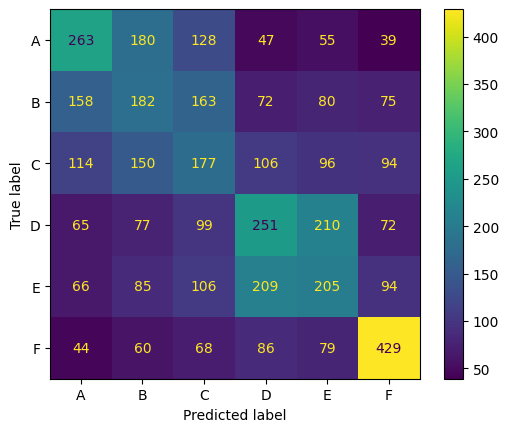

Random Forest
Best parameters: {'criterion': 'gini'}
Best CV score: 0.21974399720088056
              precision    recall  f1-score   support

           0       0.21      0.20      0.21       712
           1       0.19      0.18      0.19       730
           2       0.18      0.19      0.18       737
           3       0.24      0.25      0.25       774
           4       0.23      0.23      0.23       765
           5       0.35      0.35      0.35       766

    accuracy                           0.24      4484
   macro avg       0.23      0.23      0.23      4484
weighted avg       0.24      0.24      0.24      4484



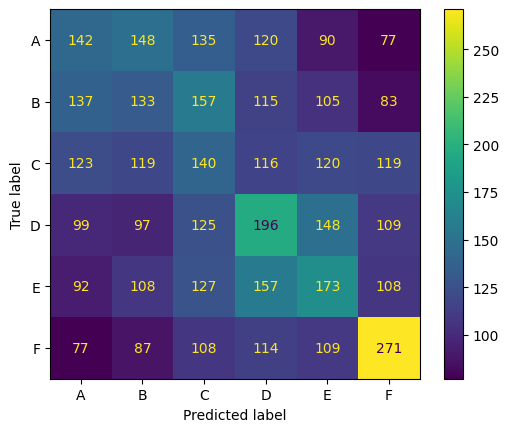

In [127]:
x_train, x_test, y_train, y_test = prep_dataset(df, 'multi-qa-mpnet-base-dot-v1',tr=True)
models = setup_models()
train_cv_models(models, x_train, y_train)
test_cv_models(models, x_test, y_test)

#### Naïve Neural Network

As in Task 1, applying a feedforward neural network on a custom Word2Vec embedding produces a noticeable improvement in performance with respect to more traditional models. Nonetheless, we are still far from the state of the art, further proving the unmatched efficacy of transformer-based models.

In [22]:
X, Y = get_np_dataset(dataset_path)

X_train, X_val, X_test, Y_train, Y_val, Y_test =  split(X, Y, test_size=0.15, val_size=0.15, seed=seed)

print(">> Train: ", len(X_train), " samples.")
print(">> Validation: ", len(X_val), " samples.")
print(">> Test: ", len(X_test), " samples.")

>> Train:  15691  samples.
>> Validation:  3363  samples.
>> Test:  3362  samples.


In [23]:
# Train a custom Word2Vec of size 30
word_model = Word2Vec(X, vector_size=30, min_count=1, window=10)

In [24]:
# Adjust the format of sets for training, validation and testing
X_train_v = [sum(word_model.wv[doc]) for doc in X_train]
X_val_v = [sum(word_model.wv[doc]) for doc in X_val]
X_test_v = [sum(word_model.wv[doc]) for doc in X_test]

Y_train_v = tfk.utils.to_categorical(Y_train)
Y_val_v = tfk.utils.to_categorical(Y_val)

Unlike the network proposed in Task 1, this topology comprises an Attention layer;
it has increased performance of ~2% of accuracy (but the same did not happen in the first assignment).

In [25]:
def get_naive_nn(input_shape, num_classes, af):
    
    input_layer = tfkl.Input(shape = input_shape, name = 'input_layer')
    x = tfkl.BatchNormalization()(input_layer)
    x = tfkl.Dense(units = 64, name = 'c1', activation = af)(x)
    x = tfkl.Attention()([x, x])
    x = tfkl.Dense(units = 128, name = 'c2', activation = af)(x)
    x = tfkl.Dense(units = 64, name = 'c3', activation = af)(x)
    output_layer = tfkl.Dense(units = num_classes, activation = 'softmax', name = 'output_layer')(x)
    
    # Build the model
    model = tfk.Model(inputs = input_layer, outputs = output_layer, name = 'model')
    model.compile(loss = tfk.losses.CategoricalCrossentropy(), optimizer = tfk.optimizers.Adam(), metrics = 'accuracy')
    
    return model

In [27]:
# Create the model
naive_nn = get_naive_nn((30,), len(labels), "swish")
es_callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy', 
                                               patience=10, 
                                               restore_best_weights=True)

callbacks = [].append(es_callback)
history = naive_nn.fit( x = np.array(X_train_v), 
                       y = np.array(Y_train_v), 
                       validation_data=(np.array(X_val_v), np.array(Y_val_v)), 
                       batch_size = 32, 
                       callbacks = callbacks, 
                       epochs = 70,
                       verbose = False).history

2023-05-28 19:24:48.846067: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


              precision    recall  f1-score   support

           0       0.49      0.53      0.51       535
           1       0.31      0.28      0.29       547
           2       0.34      0.29      0.31       553
           3       0.37      0.34      0.36       580
           4       0.30      0.31      0.30       573
           5       0.48      0.59      0.53       574

    accuracy                           0.39      3362
   macro avg       0.38      0.39      0.38      3362
weighted avg       0.38      0.39      0.38      3362



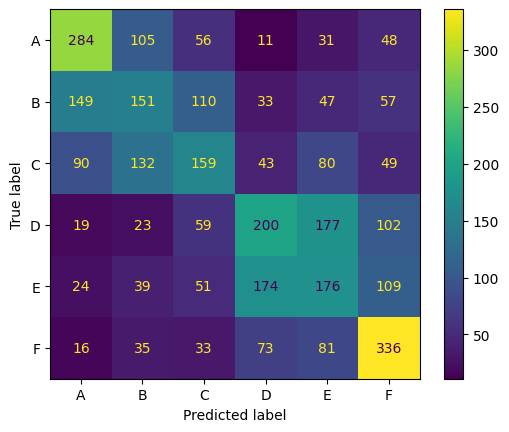

In [28]:
# Evaluate performance
predictions = np.argmax(naive_nn.predict(np.array(X_test_v), verbose=False), axis=1)
evaluate(Y_test, predictions, labels=labels)

### Transformer-based models

#### Dataset initialization

In [134]:
transformer_df = pd.read_csv(dataset_path, sep="\t")
transformer_df = transformer_df.drop("id", axis=1)
transformer_df['label'] = transformer_df['label'].replace({'A':0, 'B':1, 'C':2, 'D':3, 'E':4, 'F':5})

train, val, test = compact_split(transformer_df, test_size=0.1, val_size=0.1, seed=seed)

labels = ["A", "B", "C", "D", "E", "F"]
max_length = 135
batch_size = 32

data = DatasetDict()
data['train'] = Dataset.from_pandas(train)
data['validation'] = Dataset.from_pandas(val)
data['test'] = Dataset.from_pandas(test)

metric = hf_ev.load("accuracy")

#### Training arguments

In [135]:
training_args = TrainingArguments(
    output_dir='',
    per_device_train_batch_size=batch_size,
    per_device_eval_batch_size=batch_size,
    learning_rate=5e-5,
    weight_decay=0,
    num_train_epochs=2,
    logging_steps=100,
    evaluation_strategy="steps",
    save_strategy="steps",
    save_total_limit=2,
    save_steps=100,
    load_best_model_at_end=True,
)

#### Training various transformer models

Some weights of the model checkpoint at bert-base-multilingual-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model 

Map:   0%|          | 0/17932 [00:00<?, ? examples/s]

Map:   0%|          | 0/2242 [00:00<?, ? examples/s]

Map:   0%|          | 0/2242 [00:00<?, ? examples/s]

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/transformers/optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss,Validation Loss,Accuracy
100,1.523500,1.468595,0.362177
200,1.221600,1.165488,0.467886
300,1.107900,1.088660,0.511151
400,1.088700,1.178022,0.445138
500,1.056600,0.983574,0.558876
600,0.945100,1.050788,0.523640
700,0.884900,0.995807,0.536574
800,0.869700,0.975899,0.553078
900,0.840100,1.007097,0.537467
1000,0.819600,0.966098,0.567351


bert-base-multilingual-uncased
              precision    recall  f1-score   support

           0       0.76      0.69      0.72       350
           1       0.51      0.48      0.49       382
           2       0.51      0.55      0.53       394
           3       0.50      0.56      0.53       381
           4       0.40      0.23      0.30       366
           5       0.65      0.89      0.75       369

    accuracy                           0.57      2242
   macro avg       0.56      0.57      0.55      2242
weighted avg       0.55      0.57      0.55      2242



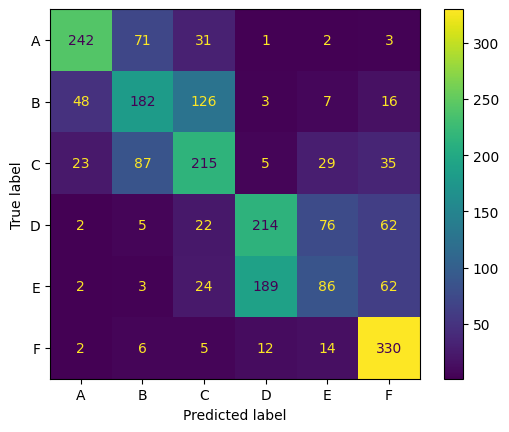

In [136]:
model_name = 'bert-base-multilingual-uncased'

training_args.output_dir = f'models/{model_name}_t2'

transformer, tokenizer = import_transformer(model_name, labels, device)
tokenized_data = data.map(tokenize_function, batched=True)

trainer = Trainer(
    model=transformer, 
    args=training_args, 
    train_dataset=tokenized_data['train'], 
    eval_dataset=tokenized_data['validation'],
    compute_metrics=compute_metrics
)

trainer.train()
report(trainer, tokenized_data['test'], labels, model_name)

clean_gpu_memory(transformer, tokenizer)

Some weights of the model checkpoint at bert-base-multilingual-cased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of BertForSequenceClassification were not initialized from the model ch

Map:   0%|          | 0/17932 [00:00<?, ? examples/s]

Map:   0%|          | 0/2242 [00:00<?, ? examples/s]

Map:   0%|          | 0/2242 [00:00<?, ? examples/s]

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/transformers/optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss,Validation Loss,Accuracy
100,1.582100,1.612540,0.301963
200,1.255100,1.194893,0.483497
300,1.124200,1.075353,0.509813
400,1.090500,1.211107,0.435772
500,1.058100,1.010205,0.535236
600,0.951600,1.085449,0.512043
700,0.888400,0.972404,0.557538
800,0.873300,0.950107,0.567797
900,0.849500,1.002587,0.529884
1000,0.804600,0.957842,0.570473


bert-base-multilingual-cased
              precision    recall  f1-score   support

           0       0.66      0.79      0.72       350
           1       0.51      0.45      0.48       382
           2       0.55      0.55      0.55       394
           3       0.47      0.54      0.50       381
           4       0.43      0.28      0.34       366
           5       0.74      0.85      0.79       369

    accuracy                           0.57      2242
   macro avg       0.56      0.58      0.56      2242
weighted avg       0.56      0.57      0.56      2242



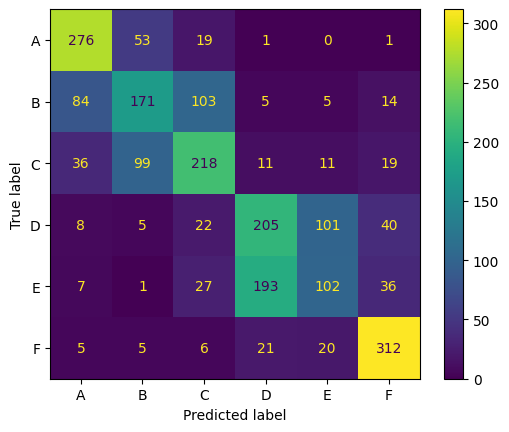

In [137]:
model_name = 'bert-base-multilingual-cased'

training_args.output_dir = f'models/{model_name}_t2'
training_args.weight_decay = 0.3

transformer, tokenizer = import_transformer(model_name, labels, device)
tokenized_data = data.map(tokenize_function, batched=True)

trainer = Trainer(
    model=transformer, 
    args=training_args, 
    train_dataset=tokenized_data['train'], 
    eval_dataset=tokenized_data['validation'],
    compute_metrics=compute_metrics
)

trainer.train()
report(trainer, tokenized_data['test'], labels, model_name)

clean_gpu_memory(transformer, tokenizer)

Some weights of the model checkpoint at distilbert-base-multilingual-cased were not used when initializing DistilBertForSequenceClassification: ['vocab_projector.bias', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_layer_norm.weight', 'vocab_transform.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-multilingual-cased and are newly initialized: ['classifier.bias', 'pre_classifie

Map:   0%|          | 0/17932 [00:00<?, ? examples/s]

Map:   0%|          | 0/2242 [00:00<?, ? examples/s]

Map:   0%|          | 0/2242 [00:00<?, ? examples/s]

/home/crimsowl/.conda/envs/tf/lib/python3.9/site-packages/transformers/optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss,Validation Loss,Accuracy
100,1.545500,1.305483,0.438448
200,1.207900,1.117054,0.493756
300,1.123300,1.095119,0.508475
400,1.101100,1.065747,0.513827
500,1.070400,1.009046,0.527208
600,0.964600,1.064373,0.501784
700,0.926600,0.976490,0.547725
800,0.897100,0.953534,0.562890
900,0.871000,0.990383,0.540589
1000,0.863300,0.949661,0.568243


distilbert-base-multilingual-cased
              precision    recall  f1-score   support

           0       0.74      0.74      0.74       350
           1       0.53      0.50      0.52       382
           2       0.50      0.52      0.51       394
           3       0.49      0.55      0.52       381
           4       0.41      0.29      0.34       366
           5       0.69      0.81      0.74       369

    accuracy                           0.57      2242
   macro avg       0.56      0.57      0.56      2242
weighted avg       0.56      0.57      0.56      2242



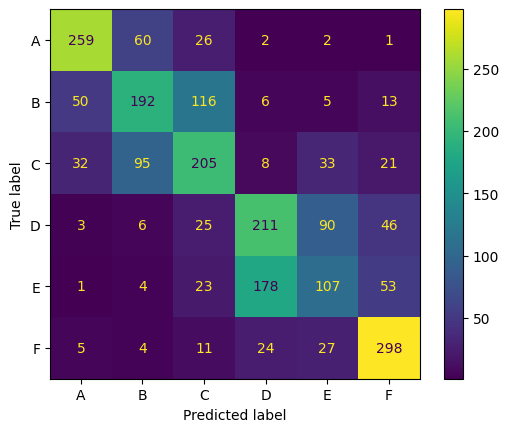

In [ ]:
model_name = 'distilbert-base-multilingual-cased'

training_args.output_dir = f'models/{model_name}_t2'
training_args.weight_decay = 0.2

transformer, tokenizer = import_transformer(model_name, labels, device)
tokenized_data = data.map(tokenize_function, batched=True)

trainer = Trainer(
    model=transformer, 
    args=training_args, 
    train_dataset=tokenized_data['train'], 
    eval_dataset=tokenized_data['validation'],
    compute_metrics=compute_metrics
)

trainer.train()
report(trainer, tokenized_data['test'], labels, model_name)

clean_gpu_memory(transformer, tokenizer)

## Conclusions

Our results show a noticeable disparity between the two tasks, with task 2 being more intrinsically difficult.
More classical approaches, such as sample vector classifiers and naive bayes, behaved quite well on both tasks, and particularly when text was represented through an embedding.

On the other hand, agnostic feed-forward  neural networks provided a small, but consistent, improvement.
Unsurprisingly, transformers achieved the best results in both tasks, with 93% accuracy on task 1 and 58% on task 2, with no less than a 10% increase of performance over any other model we have tested.

As far as our work went, we can assume that bag-of-words representation preserves most of the information concerning the document, yet embeddings are generally more informative and efficient; nonetheless, there must be an intrinsic limit in what can be achieved with both, as transformers, which effectively use all information, including context, have far superior results.